In [15]:
#!pip install pyshp

In [16]:
#!pip install git+https://github.com/pysal/pysal.git

In [6]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import csv
#import pandasql as ps
import matplotlib.pyplot as plt
import shapefile as shp
import seaborn as sns
import random
import time
from sklearn.model_selection import train_test_split
#import pysal as ps
import scipy
import fiona

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data

from torch.nn import functional
from torch.autograd import Variable

import statistics

#temporal pattern clustering
from tslearn.clustering import TimeSeriesKMeans, silhouette_score
from tslearn.utils import to_time_series_dataset
from sklearn import metrics

#!pip install dtaidistance
#!pip install plotly
#!pip install tslearn
#source https://dtaidistance.readthedocs.io/en/latest/usage/dtw.html
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis

from scipy.cluster.hierarchy import fcluster
from scipy.stats import chisquare
from scipy.stats import wasserstein_distance

#regression model
from patsy import dmatrices
#import statsmodels.api as sm

from datetime import datetime

from pysal.model import spreg
from pysal.lib import weights
from pysal.explore import esda

C:\Users\29700\anaconda3\lib\site-packages\pysal\model\spvcm\abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


In [2]:
#path = 'C:/Users/29700/Downloads/RecSys-Workshop/tutorials/'
#os.chdir(path)
#import utilities as utl

check obs distribution

source https://www.statisticshowto.com/probability-and-statistics/statistics-definitions/parametric-and-non-parametric-data/
The main nonparametric tests are:

- 1-sample sign test. Use this test to estimate the median of a population and compare it to a reference value or target value.

- 1-sample Wilcoxon signed rank test. With this test, you also estimate the population median and compare it to a reference/target value. However, the test assumes your data comes from a symmetric distribution (like the Cauchy distribution or uniform distribution).

- Friedman test. This test is used to test for differences between groups with ordinal dependent variables. It can also be used for continuous data if the one-way ANOVA with repeated measures is inappropriate (i.e. some assumption has been violated).

- Goodman Kruska’s Gamma: a test of association for ranked variables.

- Kruskal-Wallis test. Use this test instead of a one-way ANOVA to find out if two or more medians are different. Ranks of the data points are used for the calculations, rather than the data points themselves.

- The Mann-Kendall Trend Test looks for trends in time-series data.

- Mann-Whitney test. Use this test to compare differences between two independent groups when dependent variables are either ordinal or continuous.

- Mood’s Median test. Use this test instead of the sign test when you have two independent samples. Spearman Rank Correlation.Use when you want to find a correlation between two sets of data.



In [37]:
selected_geoid = list(np.unique(obs_sum_hr['geoid']))

kruskal_test = []
for i in range(len(selected_geoid[:-1])):
    for j in selected_geoid[(i+1):]:
        test = []
        test.append(selected_geoid[i])
        test.append(j)
        
        #conduct the F test
        t1 = np.array(obs_sum_hr[obs_sum_hr['geoid']==selected_geoid[i]].sort_values(by=['hr'])['obs'])
        t2 = np.array(obs_sum_hr[obs_sum_hr['geoid']==j].sort_values(by=['hr'])['obs'])
        statistic, p = scipy.stats.kruskal(t1, t2)
        test.append(statistic)
        test.append(p)
        if p >= 0.05:
            test.append(1)
        else:
            test.append(0)
        kruskal_test.append(test)

In [38]:
a = 0
for i in kruskal_test:
    a= a + i[-1]
print(a/len(kruskal_test))

stats_sum = {}
for values in kruskal_test:
    if values[0] not in stats_sum:
        stats_sum[values[0]] = []
        stats_sum[values[0]].append(values[-1])
        stats_sum[values[0]].append(1)
        
    else:
        stats_sum[values[0]][0] = stats_sum[values[0]][0] + values[-1]
        stats_sum[values[0]][1] = stats_sum[values[0]][1]+1
    
for i in stats_sum:
    stats_sum[i].append(round(stats_sum[i][0]/stats_sum[i][1],2))

0.3013781798312185


In [39]:
#distribution similar as others?
test_value = []
for i in obs_sum_d['geoid']:
    if i in stats_sum:
        test_value.append(stats_sum[i][-1])
    else:
        test_value.append(0)
    
    
obs_sum_d['stats_sum'] = test_value

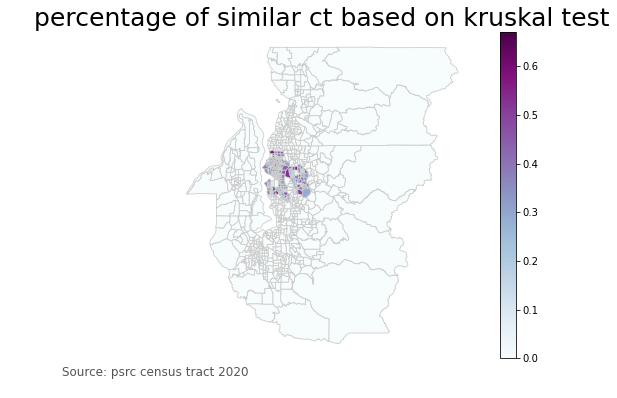

In [40]:
plot_map_based_on_var('stats_sum', obs_sum_d, 'BuPu', 'percentage of similar ct based on kruskal test')

In [41]:
obs_sum_d = selected_latlon_shape.groupby(['geoid','newid']).sum()
obs_sum_d = obs_sum_d.groupby(['geoid']).sum()[['obs']]
obs_sum_d.reset_index(inplace=True)

id_sum_d = selected_latlon_shape.groupby(['geoid'])['newid'].unique().to_frame()
id_sum_d.reset_index(inplace=True)
id_sum_d['newid'] = id_sum_d['newid'].apply(len)

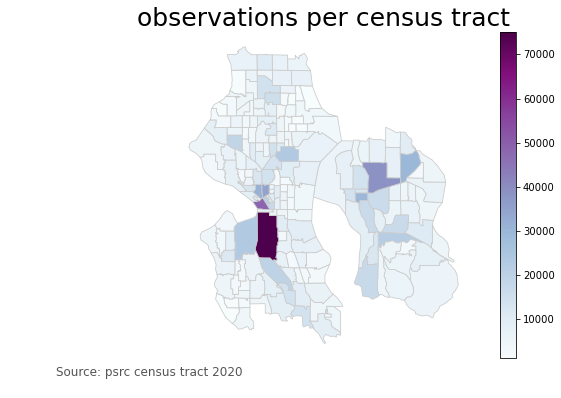

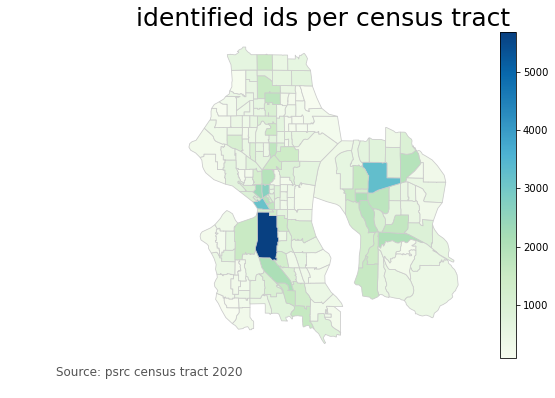

In [42]:
plot_map_based_on_var('obs', obs_sum_d, 'BuPu', 'observations per census tract')
plot_map_based_on_var('newid', id_sum_d, 'GnBu', 'identified ids per census tract')

#based on the figure, it is able to notice spatial variation of
#identified ids and obs is very similar

In [43]:
## questions to explore
# whether the obs per hour distribution varies over different census tract
# yes!

# whether the # of obs varies similarly as # of identified samples at each sensus tract/per hour
# 

#can we find any clustering based on the current spatial and temporal pattern?

#use data as the curretn spatial distribution, does this make sense? Potential challenges?


In [44]:
selected_latlon_shape.to_csv(path+'selected_latlon.csv')

In [95]:
selected_latlon_shape = pd.read_csv('selected_latlon.csv')

In [105]:
selected_latlon_shape['minut_5'] = (selected_latlon_shape['time']-selected_latlon_shape['hr']*12-1)*5

In [26]:
#number of census tract 
selected_latlon_shape['minut_5'] = (selected_latlon_shape['time']-selected_latlon_shape['hr']*12-1)*5
obs_Seattle_Bellevue = selected_latlon_shape.groupby(['GEOID10','hr','minut_5','newid']).sum().groupby(['GEOID10','hr','minut_5','newid']).sum()[['obs']]
obs_Seattle_Bellevue.reset_index(inplace=True)

spatial_temporal_id = []
for i in np.arange(len(obs_Seattle_Bellevue['GEOID10'])):
    spatial_temporal_id.append(str(obs_Seattle_Bellevue['GEOID10'][i])+'_'+str(obs_Seattle_Bellevue['hr'][i])+'_'+str(obs_Seattle_Bellevue['minut_5'][i]))
    
obs_Seattle_Bellevue['spatial_temporal_id'] = spatial_temporal_id

C:\Users\29700\anaconda3\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [27]:
obs_Seattle_Bellevue.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id
0,53033000100,0,0,9856,1,53033000100_0_0
1,53033000100,0,0,23929,3,53033000100_0_0
2,53033000100,0,0,36465,2,53033000100_0_0


In [28]:
obs_Seattle_Bellevue['GEOID10'] = obs_Seattle_Bellevue['GEOID10'].astype(str)
obs_Seattle_Bellevue['spatial_temporal_id'] = obs_Seattle_Bellevue['GEOID10'].astype(str)+'_'+obs_Seattle_Bellevue['hr'].astype(str)+'_'+obs_Seattle_Bellevue['minut_5'].astype(str)

#normalize the data
def norm_data(df):
    max_num = df['obs'].describe()['max']
    min_num = 0
    #max_min normalization
    df['norm_obs'] = df['obs']/max_num
    df['norm_obs_5'] = df['norm_obs']*5
    #notice standardization will generate negative value, thus we don't apply such
    #scaling method in our case
    return(df)

obs_Seattle_Bellevue = norm_data(obs_Seattle_Bellevue)

In [49]:
#selected_shape.keys()

In [50]:
#CensusTract.keys()

In [21]:
#through checking we found that the demographic data is based on ACS 2017 survey
#thus it matches the data collected from cuebiq
demo_ct = pd.read_csv('data_stage1_v1.csv', header=0)
demo_ct.head()
est_sm =pd.read_csv('../model/poi_res_v32.csv', header=0)

est_sm.columns = ['prob','mean','se','sd','10%','90%','n_eff','Rhat']
demo_ct = demo_ct[['pop', 'g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7',\
       'g8', 'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17',\
       'g18','home_ratio','GEOID10','Count_']]

In [22]:
ids_with_home = pd.read_csv('cuebiq_home_psrc_raw.csv', \
                                header=None, sep='\t')
ids_with_home.columns = ['newid','lat','lon']
#check home ids
latlon_ids = np.unique(latlon_shape['newid'])
home_ids = np.unique(ids_with_home['newid'])
#check home and non-home ids
latlon_home = latlon_shape[latlon_shape['newid'].isin(home_ids)]
home_obs = latlon_shape[latlon_shape['newid'].isin(home_ids)].groupby(['geoid','hr']).sum()[['obs']]
home_sampleids = pd.DataFrame(latlon_shape[latlon_shape['newid'].isin(home_ids)].groupby(['geoid','hr','newid']).size())
travel_obs = latlon_shape[~latlon_shape['newid'].isin(home_ids)].groupby(['geoid','hr']).sum()[['obs']]
travel_ids = pd.DataFrame(latlon_shape[~latlon_shape['newid'].isin(home_ids)].groupby(['geoid','hr','newid']).size())
home_obs.reset_index(inplace=True)
home_sampleids.reset_index(inplace=True)
travel_obs.reset_index(inplace=True)
travel_ids.reset_index(inplace=True)        
#we exclude the travelers when analyzing the data

In [54]:
#convert homeids with # of samples
home_sampleids['identified_num'] = 1
home_sampledid_num = pd.DataFrame(home_sampleids.groupby(['geoid','hr']).sum()['identified_num'])
home_sampledid_num.reset_index(inplace=True)

In [55]:
num_geoid = len(np.unique(home_sampledid_num['geoid']))
num_hr = len(np.unique(home_sampledid_num['hr']))
print(num_geoid, num_hr)

773 24


In [56]:
list(home_sampledid_num.columns)

['geoid', 'hr', 'identified_num']

In [57]:
print(home_sampledid_num.head(3))
#print(list(home_sampledid_num['hr'][home_sampledid_num['geoid'] == '53033000100']))
print(home_obs.head(3))

         geoid  hr  identified_num
0  53033000100   0              40
1  53033000100   1              28
2  53033000100   2              34
         geoid  hr  obs
0  53033000100   0  145
1  53033000100   1  171
2  53033000100   2  131


In [58]:
#############################################################################################
#########check patterns######################################################################
def convert_dt2array(df, num_geoid, num_hr):
    col_names = list(df.columns)
    matrice = np.zeros((num_geoid, num_hr))
    geoids = np.unique(df['geoid'])
    for i in range(num_geoid):
        hrs = list(df['hr'][df['geoid'] == geoids[i]])
        values = list(df[col_names[2]][df['geoid'] == geoids[i]]) 
        for j in range(len(hrs)):
            matrice[i, hrs[j]] = values[j]
    return(matrice)

def calculate_obs_per(obs_matrix):
    obs_per_matrix = np.zeros((obs_matrix.shape))
    for i in range(len(obs_matrix)):
        total_obs = np.sum(obs_matrix[i])
        obs_per_matrix[i] = obs_matrix[i]/total_obs
    return(obs_per_matrix)

def calculate_ids_per(ids_matrix, df):
    geoids = np.unique(df['geoid'])
    ids_per_matrix = np.zeros((ids_matrix.shape))
    for i in range(len(ids_matrix)):
        total_ids = len(np.unique(df[['newid']][df['geoid']==geoids[i]]))
        ids_per_matrix[i] = ids_matrix[i]/total_ids
    return(ids_per_matrix)
        

In [59]:
#data for clustering
ids_matrix = convert_dt2array(home_sampledid_num, num_geoid, num_hr)
obs_matrix = convert_dt2array(home_obs, num_geoid, num_hr)

In [60]:
#percentage data for clustering
obs_per_matrix = calculate_obs_per(obs_matrix)

In [61]:
ids_per_matrix = calculate_ids_per(ids_matrix, latlon_shape)

In [62]:
from sktime.datasets.base import load_italy_power_demand
from sktime.distances.elastic_cython import dtw_distance
from scipy.cluster.hierarchy import single, complete, average, ward, dendrogram
data = load_italy_power_demand()

In [63]:
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import silhouette_score

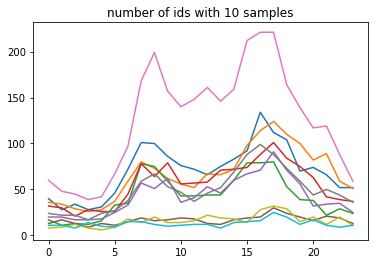

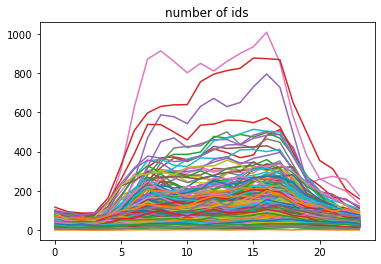

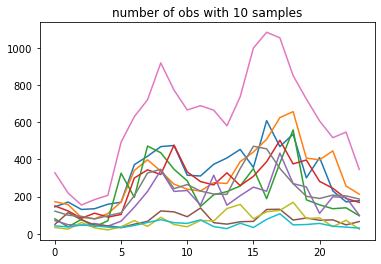

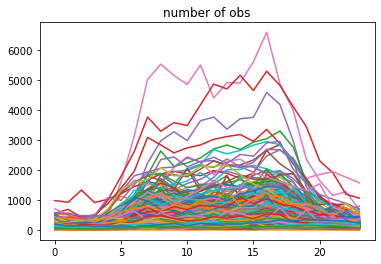

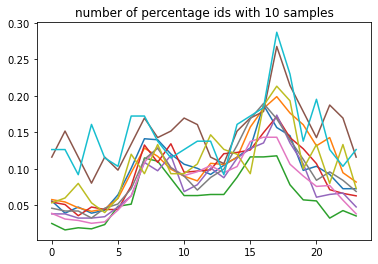

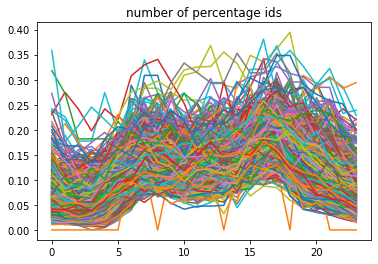

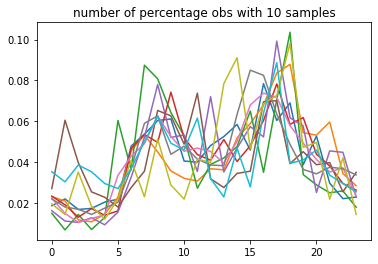

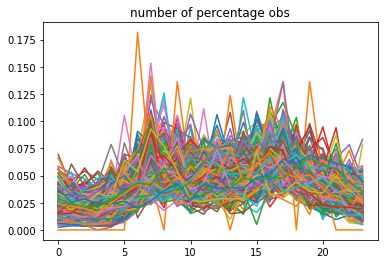

In [64]:
#check number of ids identified per hour
def plot_pattern(input_matrix, sample_num, data_symbol):
    fig1, ax1 = plt.subplots()
    for i in input_matrix[:sample_num]:
        ax1.plot(i)
        ax1.set_title(data_symbol+' with '+str(sample_num)+' samples')

    fig2, ax2 = plt.subplots()
    for i in input_matrix:
        ax2.plot(i)
        ax2.set_title(data_symbol)
    
plot_pattern(ids_matrix, 10, 'number of ids')
plot_pattern(obs_matrix, 10, 'number of obs')
plot_pattern(ids_per_matrix, 10, 'number of percentage ids')
plot_pattern(obs_per_matrix, 10, 'number of percentage obs')

In [65]:
#learning of dtw distance
#source: https://dtaidistance.readthedocs.io/en/latest/usage/dtw.html#dtw-distance-measure-between-two-time-series
#dtw examples
'''path = dtw.warping_path(ids_matrix[0], ids_matrix[1])
dtwvis.plot_warping(ids_matrix[0], ids_matrix[1], path)

dtw.distance(ids_matrix[0], ids_matrix[1])
d, paths = dtw.warping_paths(ids_matrix[0], ids_matrix[1])
best_path = dtw.best_path(paths)
dtwvis.plot_warpingpaths(ids_matrix[0], ids_matrix[1], paths, best_path)'''

'path = dtw.warping_path(ids_matrix[0], ids_matrix[1])\ndtwvis.plot_warping(ids_matrix[0], ids_matrix[1], path)\n\ndtw.distance(ids_matrix[0], ids_matrix[1])\nd, paths = dtw.warping_paths(ids_matrix[0], ids_matrix[1])\nbest_path = dtw.best_path(paths)\ndtwvis.plot_warpingpaths(ids_matrix[0], ids_matrix[1], paths, best_path)'

In [66]:
#get correlation matrix
def get_cor(df_matrix):
    return(pd.concat([pd.Series(series) for series in df_matrix], axis=1).corr())
#build dtw matrix
def get_dtw(df_matrix):
    df_matrix_dtw = np.zeros(shape=(len(df_matrix), len(df_matrix)))
    for i in range(len(df_matrix)):
        for j in range(len(df_matrix)):
            x = df_matrix[i]
            y = df_matrix[j]
            if i != j:
                dist = dtw.distance(x, y)
                df_matrix_dtw[i, j] = dist
    return(df_matrix_dtw)
#wassertain distance matrix
def get_ws(df_matrix):
    df_matrix_ws = np.zeros(shape=(len(df_matrix), len(df_matrix)))
    for i in range(len(df_matrix)):
        for j in range(len(df_matrix)):
            x = df_matrix[i]
            y = df_matrix[j]
            if i != j:
                dist = wasserstein_distance(x, y)
                df_matrix_ws[i, j] = dist
    return(df_matrix_ws)


In [67]:
#source: https://towardsdatascience.com/how-to-apply-hierarchical-clustering-to-time-series-a5fe2a7d8447
def hierarchical_clustering(distance_matrix, method='complete', plot_index='ids_matrix'):
    if method == 'complete':
        Z = complete(distance_matrix)
    if method == 'single':
        Z = single(distance_matrix)
    if method == 'average':
        Z = average(distance_matrix)
    if method == 'ward':
        Z = ward(distance_matrix)
    
    fig = plt.figure(figsize=(16, 8))
    dn = dendrogram(Z)
    plt.title(f"Dendrogram for {method}-linkage with correlation distance {plot_index}")
    plt.show()
    return (Z)

#we set cluster number from 1 to 20
def K_means_ts_clustering(data, dist_method, iter_num, label_plot):
    #convert data type
    shapes = data.shape
    data = data.reshape(shapes[0], shapes[1], 1)
    labels = {}
    elbow_value = []
    sh_value = []
    for k in range(1, 21):
        model = TimeSeriesKMeans(n_clusters = k, metric=dist_method, max_iter=iter_num)
        model.fit(data)
        labels[k] = model.predict(data)
        elbow_value.append(model.inertia_)
       # sh_value.append(silhouette_score(data, labels[k], metric=dist_method))
    fig1, ax1 = plt.subplots()
    ax1.plot(list(range(1, 21)), elbow_value, 'o')
    ax1.set_title('elbow plot '+ label_plot)
    
    #fig2, ax2 = plt.subplots()
    #ax2.plot(list(range(1, 21)), sh_value, 'o')
    #ax2.set_title('silhouttee score')
    return(labels)


In [68]:
def get_Silhouette_score(df, cluster_model, colors):
    sh_score = {}
    for cluster_num in cluster_model:
        labels = cluster_model[cluster_num]
        score = metrics.silhouette_score(df, labels)
        sh_score[cluster_num] = score
    plt.plot(sh_score.keys(), sh_score.values(),'o', color = colors)
    return(sh_score)
    #print(sh_score)
    #plt.legend()
    
def plot_sh_score(df_matrix, linkage_matrix, colors):
    model_labels = {}
    for i in range(2, 21):
        cluster_labels = fcluster(linkage_matrix, i, criterion='maxclust')
        model_labels[i] = cluster_labels
    sh_score = get_Silhouette_score(df_matrix, model_labels, colors)
    return(model_labels, sh_score)
        

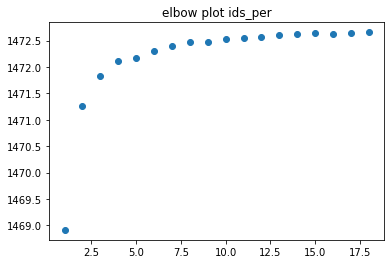

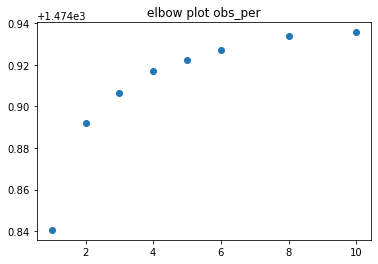

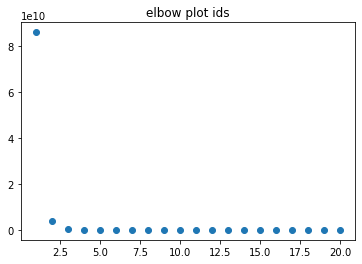

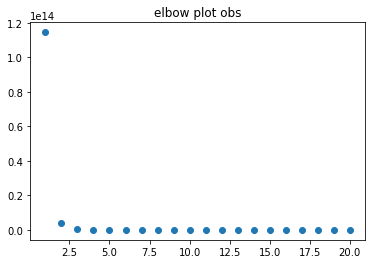

In [69]:
#possible ways for k means using softdtw method
kmeans_ids_per = K_means_ts_clustering(ids_per_matrix, "softdtw", 10, 'ids_per')
kmeans_obs_per = K_means_ts_clustering(obs_per_matrix, "softdtw", 10, 'obs_per')
kmeans_ids = K_means_ts_clustering(ids_matrix, "softdtw", 10, 'ids')
kmeans_obs = K_means_ts_clustering(obs_matrix, "softdtw", 10, 'obs')

In [70]:
#kmeans_ids_per[3]
#kmeans_ids[2]

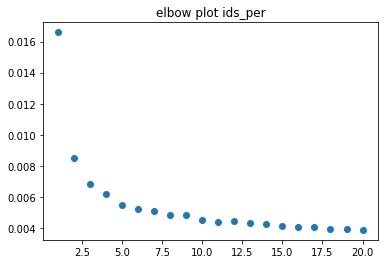

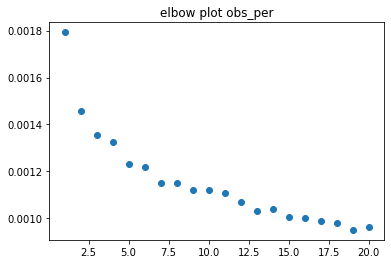

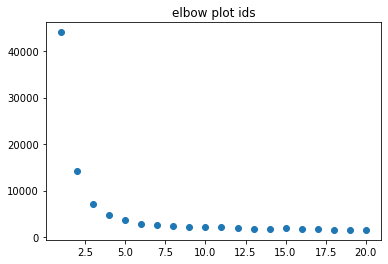

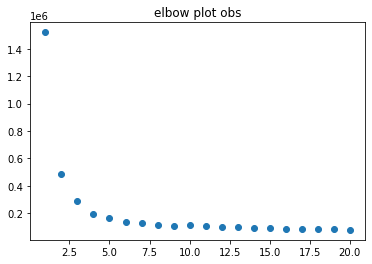

In [71]:
kmeans_ids_per = K_means_ts_clustering(ids_per_matrix, "dtw", 10, 'ids_per')
kmeans_obs_per = K_means_ts_clustering(obs_per_matrix, "dtw", 10, 'obs_per')
kmeans_ids = K_means_ts_clustering(ids_matrix, "dtw", 10, 'ids')
kmeans_obs = K_means_ts_clustering(obs_matrix, "dtw", 10, 'obs')

In [72]:
#dendrogram
#source:
#https://www.analyticsvidhya.com/blog/2016/11/an-introduction-to-clustering-and-different-methods-of-clustering/
#The height in the dendrogram at which two clusters are merged 
#represents the distance between two clusters in the data space.

#The decision of the no. of clusters that can best depict 
#different groups can be chosen by observing the dendrogram. 
#The best choice of the no. of clusters is the no. of vertical lines 
#in the dendrogram cut by a horizontal line that can transverse the
#maximum distance vertically without intersecting a cluster.

In [73]:
ids_per_matrix_ws = get_ws(ids_per_matrix)
obs_per_matrix_ws = get_ws(obs_per_matrix)

ids_matrix_ws = get_ws(ids_matrix)
obs_matrix_ws = get_ws(obs_matrix)

C:\Users\29700\anaconda3\lib\site-packages\scipy\cluster\hierarchy.py:356: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='complete', metric='euclidean')


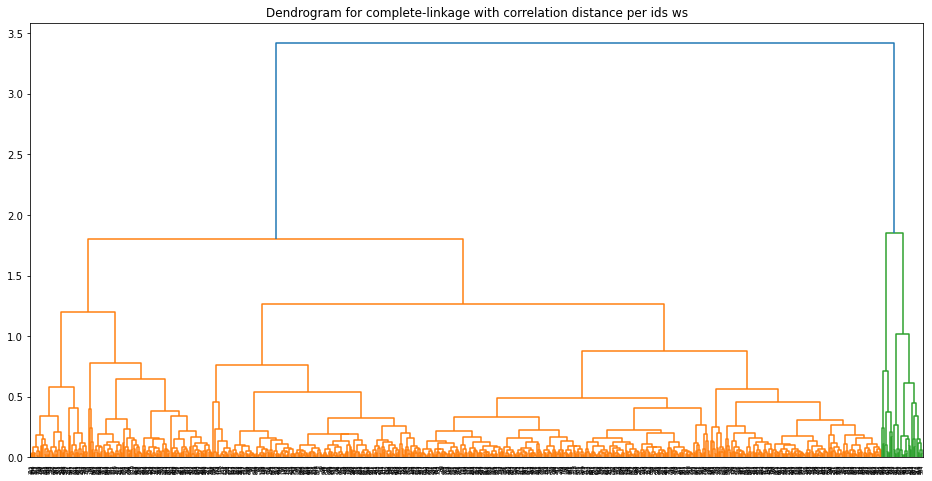

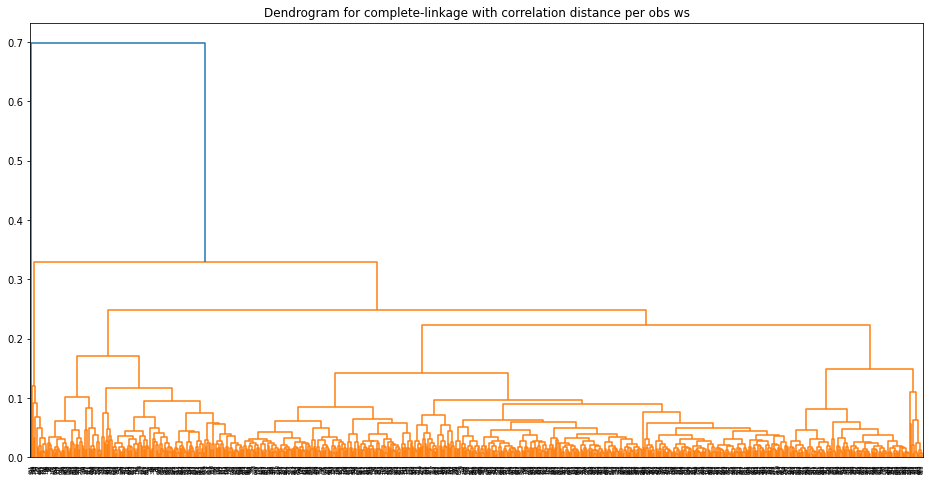

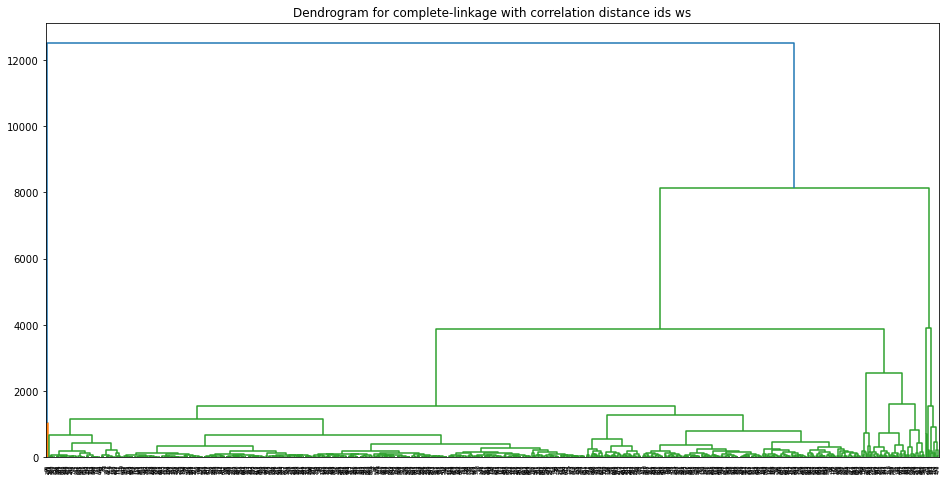

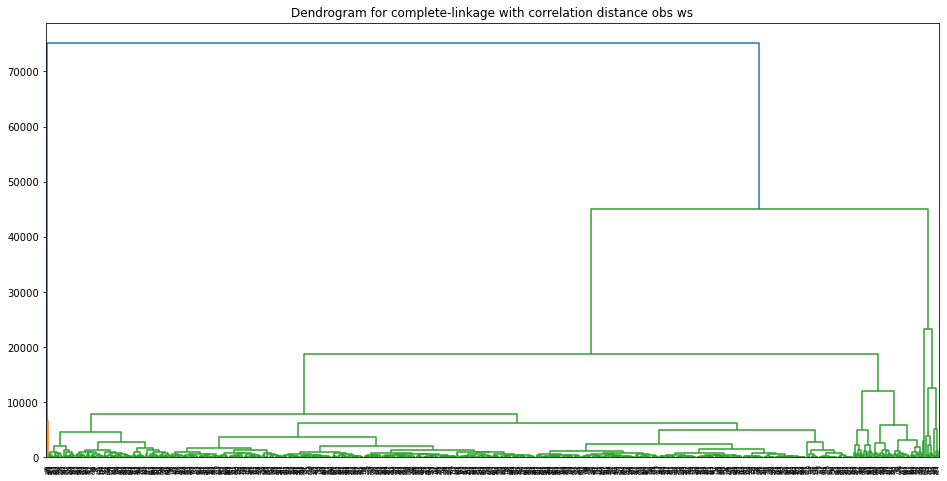

In [74]:
ids_per_linkage_matrix_ws = hierarchical_clustering(ids_per_matrix_ws, plot_index='per ids ws')
obs_per_linkage_matrix_ws = hierarchical_clustering(obs_per_matrix_ws, plot_index='per obs ws')

ids_linkage_matrix_ws = hierarchical_clustering(ids_matrix_ws, plot_index='ids ws')
obs_linkage_matrix_ws = hierarchical_clustering(obs_matrix_ws, plot_index='obs ws')

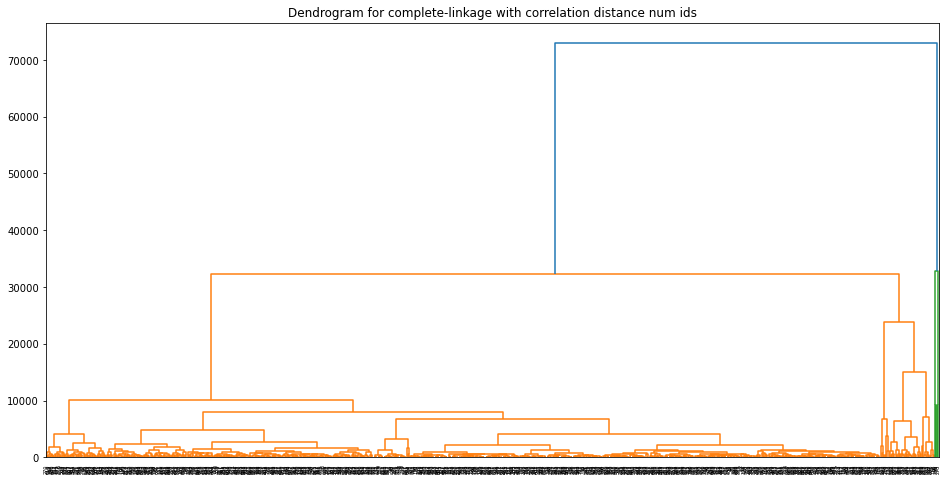

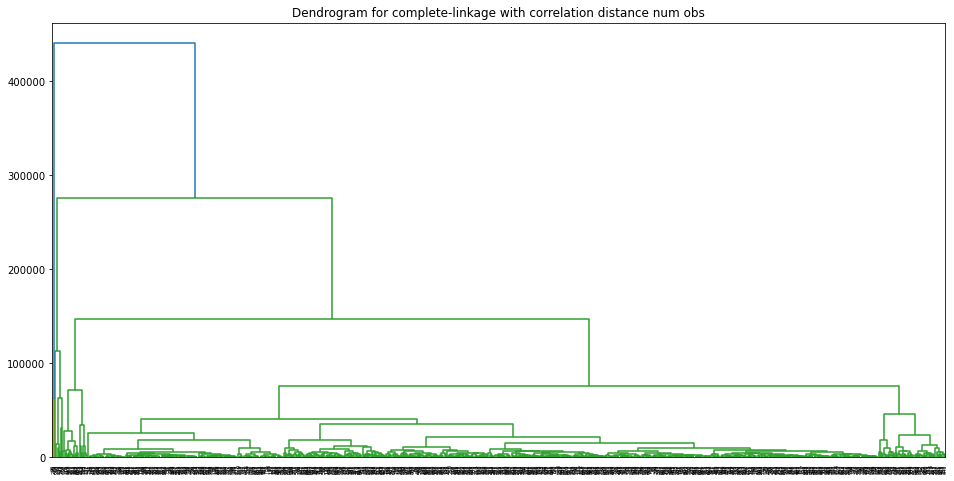

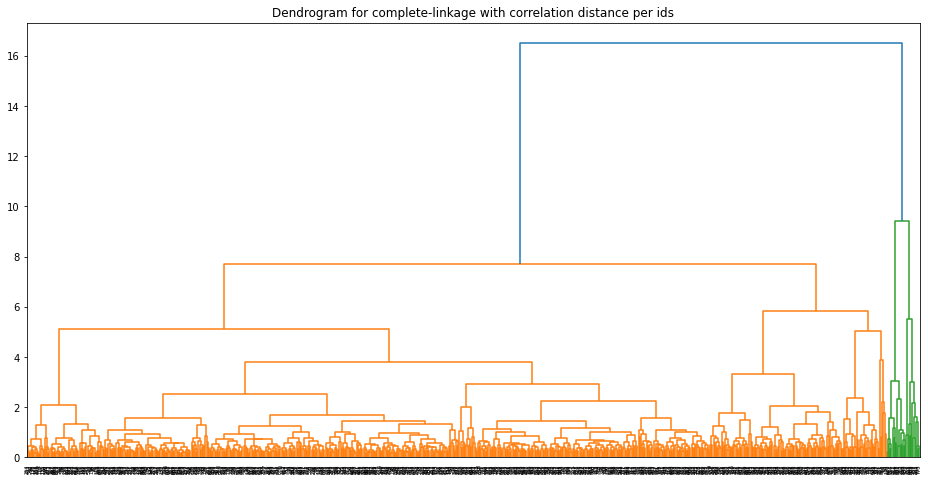

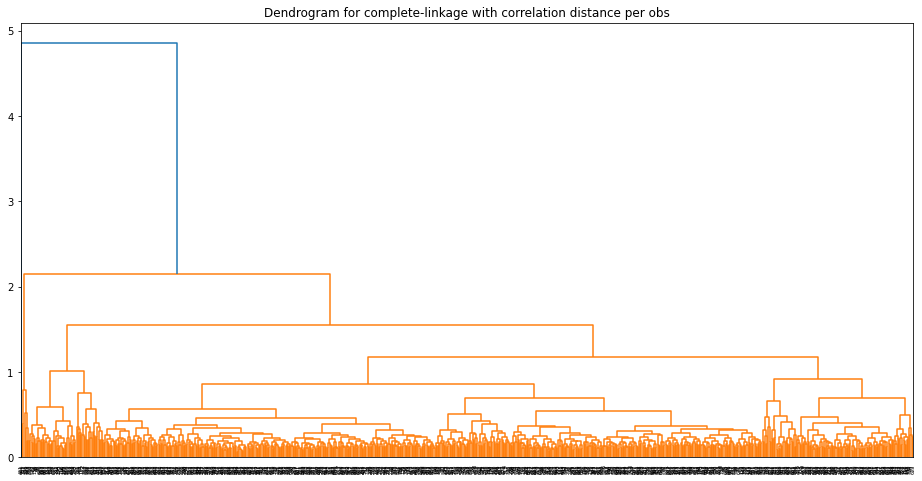

In [75]:
ids_matrix_cor = get_cor(ids_matrix)
obs_matrix_cor = get_cor(obs_matrix)
ids_per_matrix_cor = get_cor(ids_per_matrix)
obs_per_matrix_cor = get_cor(obs_per_matrix)

ids_matrix_dtw = get_dtw(ids_matrix)
obs_matrix_dtw = get_dtw(obs_matrix)
ids_per_matrix_dtw = get_dtw(ids_per_matrix)
obs_per_matrix_dtw = get_dtw(obs_per_matrix)

'''ids_linkage_matrix = hierarchical_clustering(ids_matrix_cor)
obs_linkage_matrix = hierarchical_clustering(obs_matrix_cor)
ids_per_linkage_matrix = hierarchical_clustering(ids_per_matrix_cor)
obs_per_linkage_matrix = hierarchical_clustering(obs_per_matrix_cor)
'''

ids_linkage_matrix_dtw = hierarchical_clustering(ids_matrix_dtw,plot_index='num ids')
obs_linkage_matrix_dtw = hierarchical_clustering(obs_matrix_dtw,plot_index='num obs')
ids_per_linkage_matrix_dtw = hierarchical_clustering(ids_per_matrix_dtw, plot_index='per ids')
obs_per_linkage_matrix_dtw = hierarchical_clustering(obs_per_matrix_dtw, plot_index='per obs')

The dendrogram tells us, 
clustering based on number of ids, percentage number of ids: 2
clustering based on number of obs/percentage number of obs: 1 (no cluster)

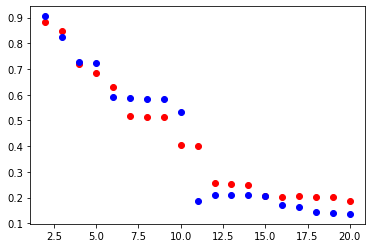

In [76]:
ids_labels, ids_sh_score = plot_sh_score(ids_matrix, ids_linkage_matrix_dtw, 'red')
obs_labels, obs_sh_score = plot_sh_score(obs_matrix, obs_linkage_matrix_dtw, 'blue')

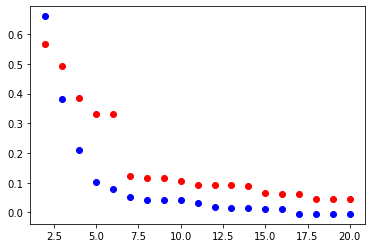

In [77]:
ids_per_labels, ids_per_sh_score = plot_sh_score(ids_per_matrix, ids_per_linkage_matrix_dtw, 'red')
obs_per_labels, obs_per_sh_score = plot_sh_score(obs_per_matrix, obs_per_linkage_matrix_dtw, 'blue')

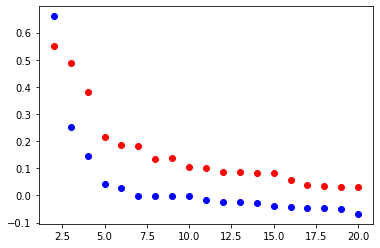

In [78]:
ids_per_labels_ws, ids_per_sh_score_ws = plot_sh_score(ids_per_matrix, ids_per_linkage_matrix_ws, 'red')
obs_per_labels_ws, obs_per_sh_score_ws = plot_sh_score(obs_per_matrix, obs_per_linkage_matrix_ws, 'blue')

In [79]:
#cluster_labels = fcluster(obs_linkage_matrix, 2, criterion='maxclust')
#print(np.unique(cluster_labels))
#cluster_labels = fcluster(obs_linkage_matrix, 2, criterion='maxclust')

#cluster_labels_ids = fcluster(ids_linkage_matrix_dtw, 2, criterion='maxclust')
#print(np.unique(cluster_labels_ids))

#thus, we use 2 clusters for ids, and per ids
#cluster_labels_per = fcluster(obs_per_linkage_matrix_dtw, 2, criterion='maxclust')
#cluster_labels_obs = fcluster(obs_linkage_matrix_dtw, 1, criterion='maxclust')
#print(np.unique(cluster_labels_obs))
cluster_labels_per_ids = fcluster(ids_per_linkage_matrix_dtw, 2, criterion='maxclust')
cluster_labels_ids = fcluster(ids_linkage_matrix_dtw, 2, criterion='maxclust')
cluster_labels_per_ids_ws = fcluster(ids_per_linkage_matrix_ws, 2, criterion='maxclust')

#test if we have two labels
print(np.unique(cluster_labels_ids))
print(np.unique(cluster_labels_per_ids))
print(np.unique(cluster_labels_per_ids_ws))

[1 2]
[1 2]
[1 2]


In [80]:
#convert to 0 and 1
cluster_labels_ids = cluster_labels_ids - 1
cluster_labels_per_ids = cluster_labels_per_ids - 1

In [81]:
geo_ids = list(np.unique(home_sampledid_num['geoid']))

CensusTract['clustered_ids'] = 0
CensusTract['clustered_ids_per'] = 0

for i in range(len(CensusTract['GEOID10'])):
    if CensusTract['GEOID10'].iloc[i] in geo_ids:
        CensusTract['clustered_ids'].iloc[i] = cluster_labels_ids[geo_ids.index(CensusTract['GEOID10'].iloc[i])]
        CensusTract['clustered_ids_per'].iloc[i] = cluster_labels_per_ids[geo_ids.index(CensusTract['GEOID10'].iloc[i])]

C:\Users\29700\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [82]:
#thus we choose cluster number = 2

In [83]:
#get the obs and ids clusters
#spatial join newid in ct
home_geos = gpd.GeoDataFrame(ids_with_home,
                                 geometry=gpd.points_from_xy(ids_with_home['lon'],\
                                                           ids_with_home['lat']),\
                                crs={'init': 'epsg:4326'})
 
home_geos = spatial_join('spatial_check/ct2010.shp', home_geos)

C:\Users\29700\anaconda3\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [84]:
home_geos.head(3)

,newid,lat,lon,geometry,index_right,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10
0,38343,47.596215,-121.979614,POINT (-121.97961 47.59621),144,53,033,032215,53033032215,322.15,Census Tract 322.15,G5020,S,16008606,10175,+47.6062193,-121.9865085
1,13824,47.836323,-122.296098,POINT (-122.29610 47.83632),693,53,061,051701,53061051701,517.01,Census Tract 517.01,G5020,S,2491488,0,+47.8299717,-122.2999364
2,18910,47.222268,-122.493760,POINT (-122.49376 47.22227),525,53,053,062801,53053062801,628.01,Census Tract 628.01,G5020,S,3773182,12847,+47.2222193,-122.4973623


In [85]:
#Creat a dict to separate travel and home ids at each ct
home_dict = {}
travel_dict = {}
for geoid in np.unique(home_sampleids['geoid']):
    home_dict[geoid] = {}
    travel_dict[geoid] = {}
    geo_df = home_sampleids[['newid','hr']][home_sampleids['geoid'] == geoid]
    idsinct = list(home_geos['newid'][home_geos['GEOID10']==geoid])
    #print(idsinct)
    for hr in np.unique(geo_df['hr']):
        geo_df_hr = geo_df[geo_df['hr']==hr]
        home_dict[geoid][hr] = list(geo_df_hr['newid'][geo_df_hr['newid'].isin(idsinct)])
        travel_dict[geoid][hr] = list(geo_df_hr['newid'][~geo_df_hr['newid'].isin(idsinct)])

In [86]:
#get geo location from hone
ids_ct_map = {}
for i in range(len(home_geos['newid'])):
    ids_ct_map[home_geos['newid'].iloc[i]] = home_geos['GEOID10'].iloc[i]

In [87]:
#plot pattern based on cluster labels
def plot_cluster_pattern(cluster_label_matrix, num_matrix, num_examples, titles):
    plt.figure(np.random.randint(100))
    index_dict = {}
    color_ranges = ['magenta', 'cyan', 'red', 'blue', 'green', 'black']
    labels = np.unique(cluster_label_matrix)
    
    for j in labels:
        a = 0
        for i in range(len(cluster_label_matrix)):
            if cluster_label_matrix[i] == j and a <= num_examples:
                plt.plot(num_matrix[i], color=color_ranges[j])
                a = a+1
    plt.title(titles)

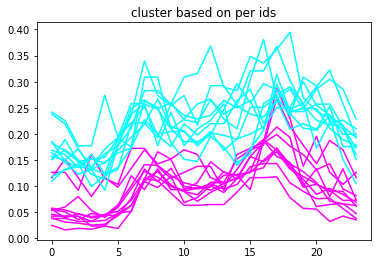

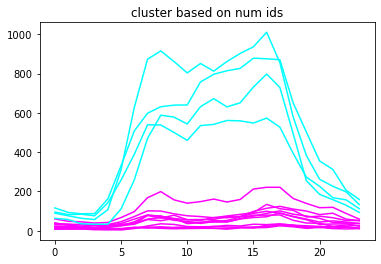

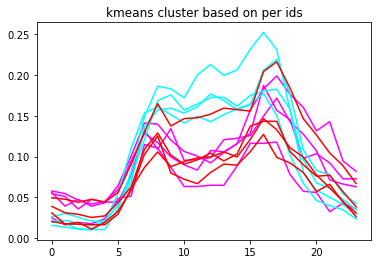

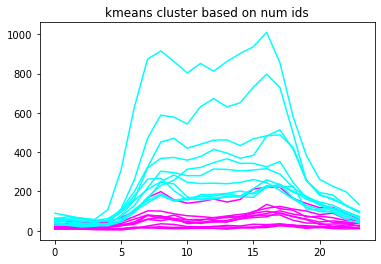

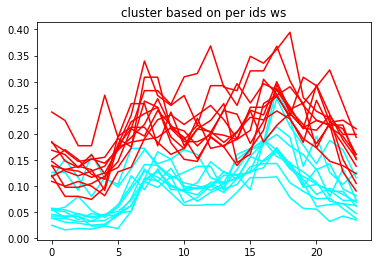

In [88]:
plot_cluster_pattern(cluster_labels_per_ids, ids_per_matrix, 10, 'cluster based on per ids')
plot_cluster_pattern(cluster_labels_ids, ids_matrix, 10, 'cluster based on num ids')
plot_cluster_pattern(kmeans_ids[3], ids_per_matrix, 3, 'kmeans cluster based on per ids')
plot_cluster_pattern(kmeans_ids[2], ids_matrix, 10, 'kmeans cluster based on num ids')
plot_cluster_pattern(cluster_labels_per_ids_ws, ids_per_matrix, 10, 'cluster based on per ids ws')

In [89]:
#check components of travelers and home residents
def get_num_ids(hr_dict):
    num_ids = []
    for hr in range(24):
        if hr not in hr_dict:
            num_ids.append(0)
        else:
            num_ids.append(len(hr_dict[hr]))
    return(num_ids)

#input must be a list/array with 1 row only
def calculate_per(identified_numlst):
    return(identified_numlst/(np.sum(identified_numlst)))

    

<ipython-input-90-6c8629b58d4b>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(a)


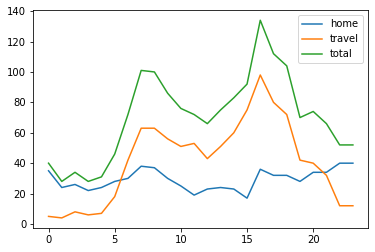

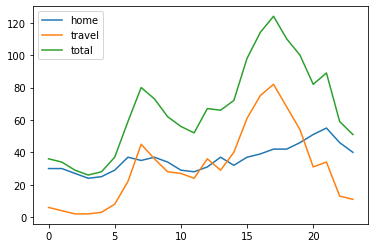

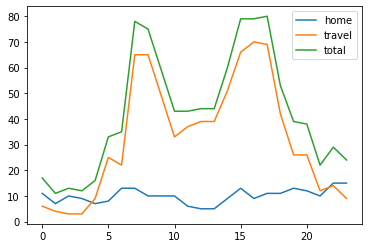

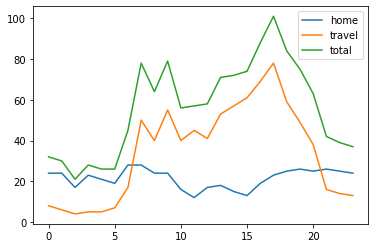

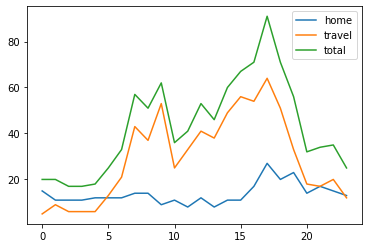

...

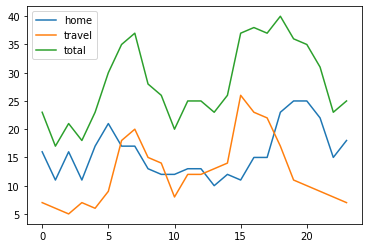

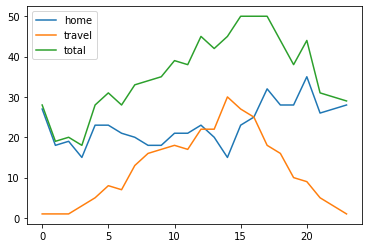

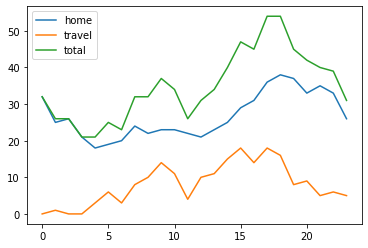

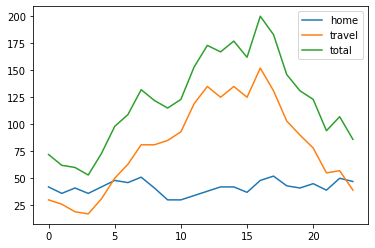

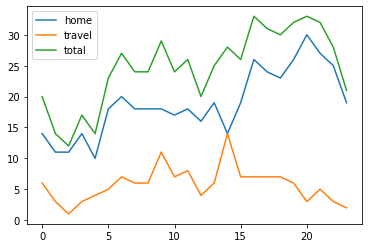

In [90]:
a = 0
for geoid in home_dict:
    plt.figure(a)
    home_num = get_num_ids(home_dict[geoid])
    travel_num = get_num_ids(travel_dict[geoid])
    total_num = ids_matrix[a]
    plt.plot(home_num, label='home')
    plt.plot(travel_num, label='travel')
    plt.plot(total_num, label='total')
    plt.legend()
    a = a+1

<ipython-input-91-dbe4f8861181>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(a)
<ipython-input-89-7f48e5dbf958>:13: RuntimeWarning: invalid value encountered in true_divide
  return(identified_numlst/(np.sum(identified_numlst)))


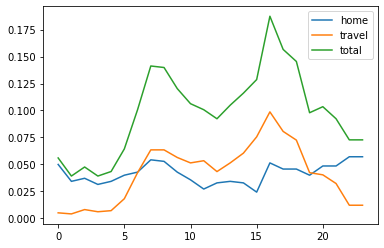

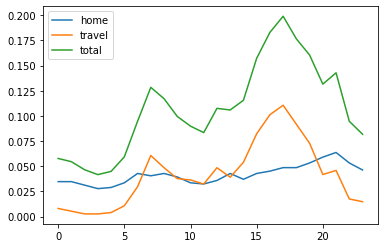

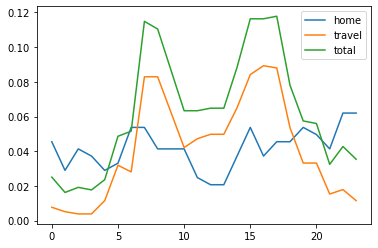

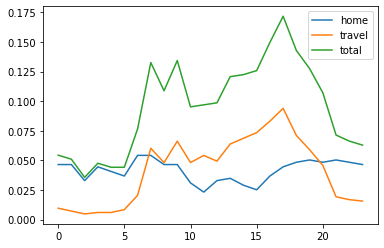

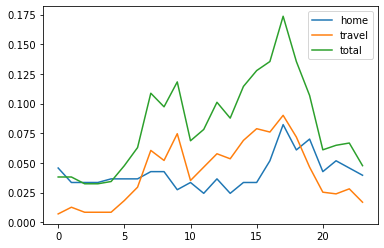

...

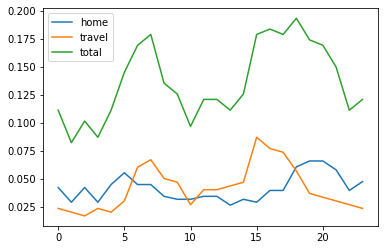

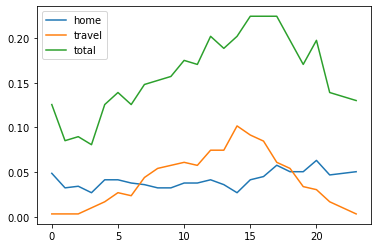

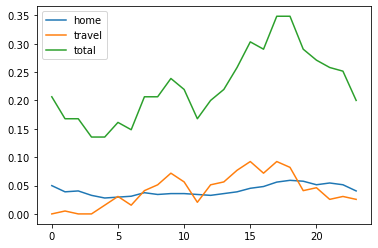

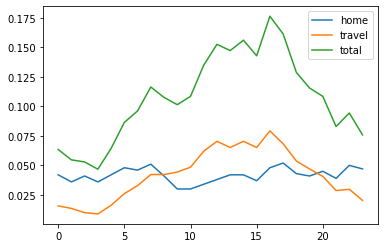

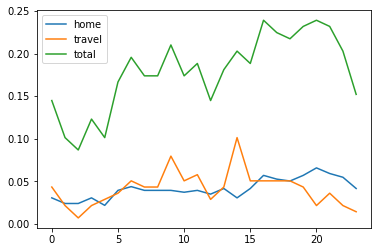

In [91]:
a = 0
for geoid in home_dict:
    plt.figure(a)
    home_num = calculate_per(get_num_ids(home_dict[geoid]))
    travel_num = calculate_per(get_num_ids(travel_dict[geoid]))
    total_num = ids_per_matrix[a]
    plt.plot(home_num, label='home')
    plt.plot(travel_num, label='travel')
    plt.plot(total_num, label='total')
    plt.legend()
    a = a+1

In [92]:
#travel_dict['53033000100']

In [93]:
#travel_dict_ct['53033000100']

In [94]:
#chi square distance
from scipy.stats import chisquare
#earth mover's distance
from scipy.stats import wasserstein_distance
from dtaidistance import dtw

In [95]:
#calculate pattern similarity
def cal_sim(num_series1, num_series2, geoid, home_index):
    cal_dict = {}
    chi_stats_dist, chi_p_value = chisquare(num_series1, num_series2)
    ws_dist = wasserstein_distance(num_series1, num_series2)
    dtw_dist = dtw.distance(num_series1, num_series2)
    if chi_p_value<=0.05:
        signal = 0
    else:
        signal = 1
        #print(geoid, home_index)
    cal_dict['chi_square'] = [chi_stats_dist, chi_p_value, signal]
    cal_dict['ws_dist'] = ws_dist
    cal_dict['dtw'] = dtw_dist
    return(cal_dict)

def get_similarity_matrix(home_dict, travel_dict, num_matrix, per_index=False):
    a = 0
    similarity_cal = {}
    for geoid in home_dict:
        similarity_cal[geoid] = {'home':{},'travel': {}}
        if per_index == False:
            home = get_num_ids(home_dict[geoid])
            travel = get_num_ids(travel_dict[geoid])
            total = num_matrix[a]
        else:
            home = calculate_per(get_num_ids(home_dict[geoid]))
            travel = calculate_per(get_num_ids(travel_dict[geoid]))
            total = num_matrix[a]
        similarity_cal[geoid]['home'] = cal_sim(total, home, geoid, 'home')
        similarity_cal[geoid]['travel'] = cal_sim(total, travel, geoid, 'travel')
        a = a+1
    return(similarity_cal)

def calculate_similarity_dist(similarity_cal):
    chi_square = []
    chi_square_home = []
    ws_dist = []
    ws_dist_home = []
    dtw_dist = []
    dtw_dist_home = []
    for geoid in similarity_cal:
        #we calculate 3 values for chi_square
        if similarity_cal[geoid]['home']['chi_square'][0]<similarity_cal[geoid]['travel']['chi_square'][0]:
            chi_square.append(1)
            chi_square_home.append(geoid)
        else:
            chi_square.append(0)
        if similarity_cal[geoid]['home']['ws_dist'] < similarity_cal[geoid]['travel']['ws_dist']:
            ws_dist.append(1)
            ws_dist_home.append(geoid)
        else:
            ws_dist.append(0)
        if similarity_cal[geoid]['home']['dtw']<similarity_cal[geoid]['travel']['dtw']:
            dtw_dist.append(1)
            dtw_dist_home.append(geoid)
        else:
            dtw_dist.append(0)
        
    print('chi_square home represents more', sum(chi_square)/len(chi_square))
    print('ws_dist home represents more', sum(ws_dist)/len(ws_dist))   
    print('dtw_dist home represents more', sum(dtw_dist)/len(dtw_dist))
    
    return(chi_square, chi_square_home, ws_dist, ws_dist_home, dtw_dist, dtw_dist_home)

#check if there distance result between chi and ws is the same
#for i in ws_dist_home:
#    if i not in chi_square_home:
#        print(i)

In [96]:
#home_dict.keys()

In [97]:
#home_dict['53033000100']
#travel_dict['53033000100']

In [98]:
similarity_cal = get_similarity_matrix(home_dict, travel_dict, ids_matrix, False)
similarity_cal_per = get_similarity_matrix(home_dict, travel_dict, ids_per_matrix, True)

C:\Users\29700\anaconda3\lib\site-packages\scipy\stats\stats.py:5982: RuntimeWarning: divide by zero encountered in true_divide
  terms = (f_obs.astype(np.float64) - f_exp)**2 / f_exp
C:\Users\29700\anaconda3\lib\site-packages\scipy\stats\stats.py:5982: RuntimeWarning: invalid value encountered in true_divide
  terms = (f_obs.astype(np.float64) - f_exp)**2 / f_exp
<ipython-input-89-7f48e5dbf958>:13: RuntimeWarning: invalid value encountered in true_divide
  return(identified_numlst/(np.sum(identified_numlst)))


In [99]:
chi_per, chi_home_per, ws_per, ws_home_per, dtw_per, dtw_home_per = calculate_similarity_dist(similarity_cal_per)

chi_square home represents more 0.685640362225097
ws_dist home represents more 0.09831824062095731
dtw_dist home represents more 0.040103492884864166


In [100]:
#chheck if ct from dtw home belongs to ct from ws
#for i in dtw_home_per:
#    if i not in ws_home_per:
#        print (i)
#similart home pattern from two methods: dtw, ws are defined differently

<AxesSubplot:>

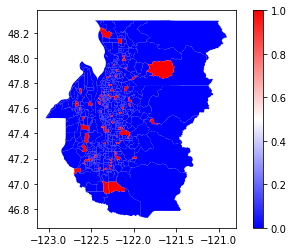

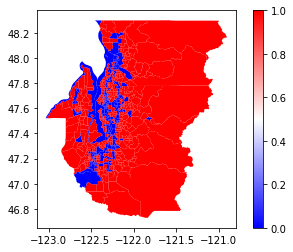

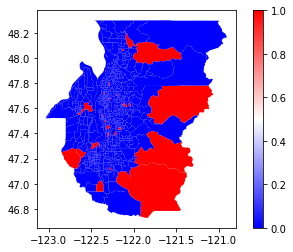

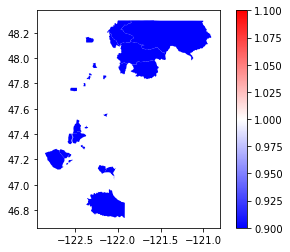

In [101]:
home_index_ws = []
home_index_chi = []
home_index_dtw = []
for geoid in CensusTract['GEOID10']:
    if geoid in ws_home_per:
        home_index_ws.append(1)
    else:
        home_index_ws.append(0)
    if geoid in chi_home_per:
        home_index_chi.append(1)
    else:
        home_index_chi.append(0)
    if geoid in dtw_home_per:
        home_index_dtw.append(1)
    else:
        home_index_dtw.append(0)

CensusTract['home_index_ws'] = home_index_ws
CensusTract['home_index_dtw'] = home_index_dtw
CensusTract['home_index_chi'] = home_index_chi

#plot the map
CensusTract.plot(column='home_index_ws', cmap='bwr', legend=True)
CensusTract.plot(column='home_index_chi', cmap='bwr', legend=True)
CensusTract.plot(column='home_index_dtw', cmap='bwr', legend=True)
CensusTract[CensusTract['clustered_ids_per']>0].plot(column='clustered_ids_per',  legend=True, cmap='bwr')

In [102]:
#get travel and home ids
#check if cluster varies in home and travel ids
ids_home = np.zeros(ids_matrix.shape)
ids_travel = np.zeros(ids_matrix.shape)
ids_home_per =  np.zeros(ids_per_matrix.shape)
ids_travel_per = np.zeros(ids_per_matrix.shape)
a = 0
for geoid in home_dict:
    ids_home[a] = get_num_ids(home_dict[geoid])
    ids_travel[a] = get_num_ids(travel_dict[geoid])
    a += 1 

In [103]:
np.sum(ids_home[451])==0

True

In [104]:
for i in range(len(ids_home)):
    if np.sum(ids_home[i]) == 0:
        ids_travel_per[i] = calculate_per(ids_travel[i])
        ids_home_per[i] = ids_home[i]
    elif np.sum(ids_travel[i]) == 0:
        ids_home_per[i] = calculate_per(ids_home[i])
        ids_travel_per[i] = ids_travel[i]
    else:
        ids_home_per[i] = calculate_per(ids_home[i])
        ids_travel_per[i] = calculate_per(ids_travel[i])

C:\Users\29700\anaconda3\lib\site-packages\scipy\cluster\hierarchy.py:356: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='complete', metric='euclidean')


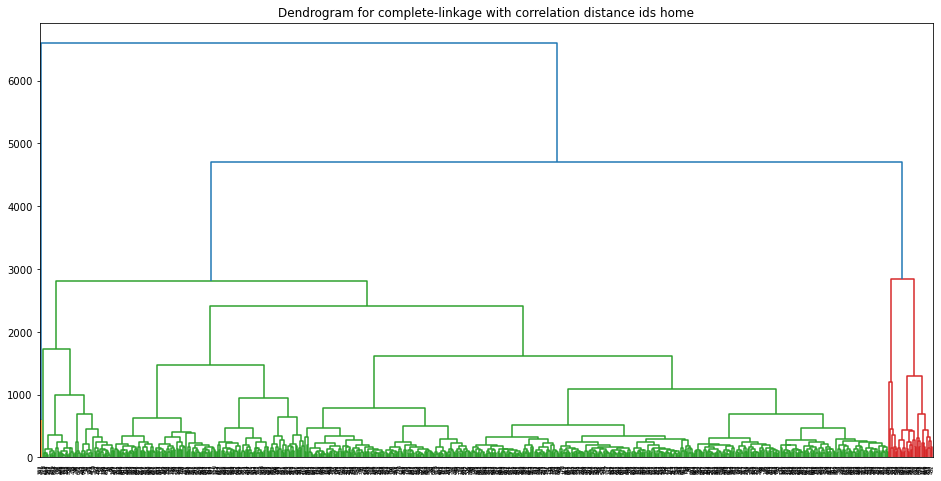

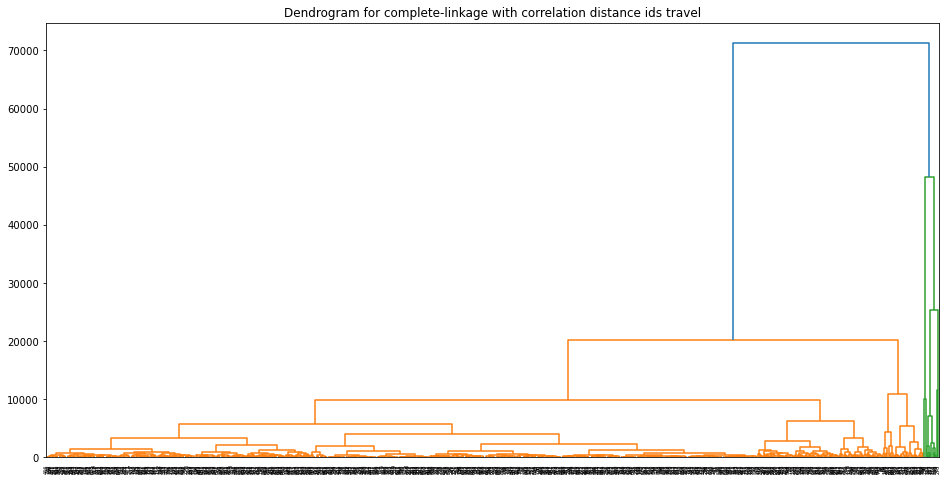

In [105]:
#here we focus on dtw
#ids_matrix_cor = get_cor(ids_matrix)
#obs_matrix_cor = get_cor(obs_matrix)

ids_matrix_dtw_home = get_dtw(ids_home)
ids_matrix_dtw_travel = get_dtw(ids_travel)

#ids_linkage_matrix = hierarchical_clustering(ids_matrix_cor)
#obs_linkage_matrix = hierarchical_clustering(obs_matrix_cor)

ids_linkage_matrix_dtw_home = hierarchical_clustering(ids_matrix_dtw_home, plot_index='ids home')
ids_linkage_matrix_dtw_travel = hierarchical_clustering(ids_matrix_dtw_travel, plot_index='ids travel')

In [106]:
ids_matrix_dtw_home_per = get_dtw(ids_home_per)
ids_matrix_dtw_travel_per = get_dtw(ids_travel_per)

In [107]:
ids_matrix_ws_home_per = get_ws(ids_home_per)
ids_matrix_ws_travel_per = get_ws(ids_travel_per)

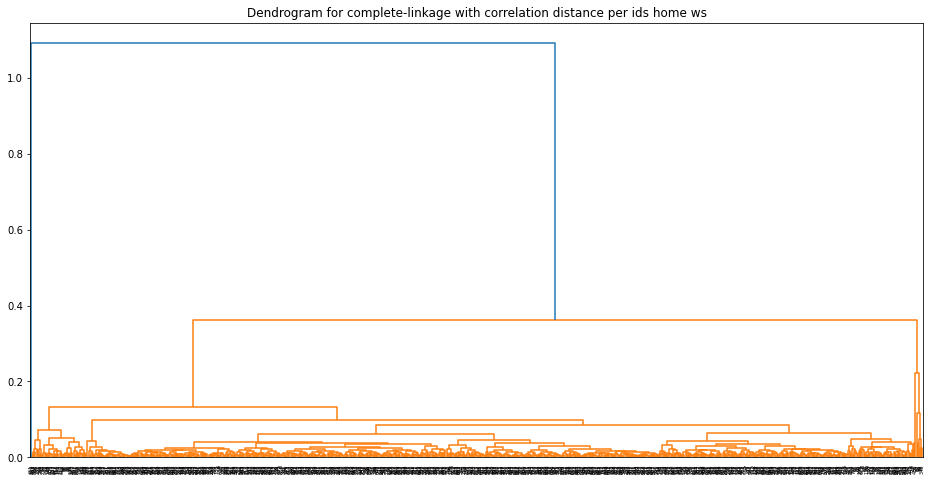

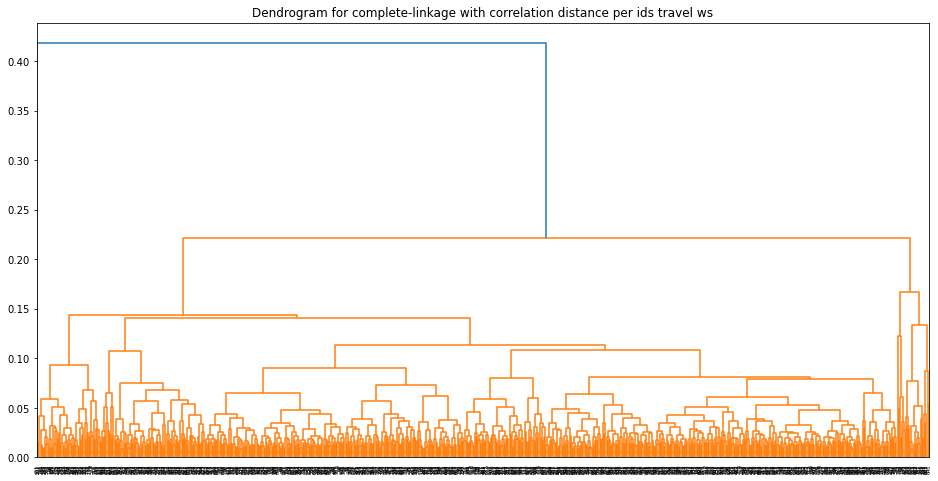

In [108]:
ids_linkage_matrix_ws_home_per = hierarchical_clustering(ids_matrix_ws_home_per, plot_index='per ids home ws')
ids_linkage_matrix_ws_travel_per = hierarchical_clustering(ids_matrix_ws_travel_per, plot_index='per ids travel ws')

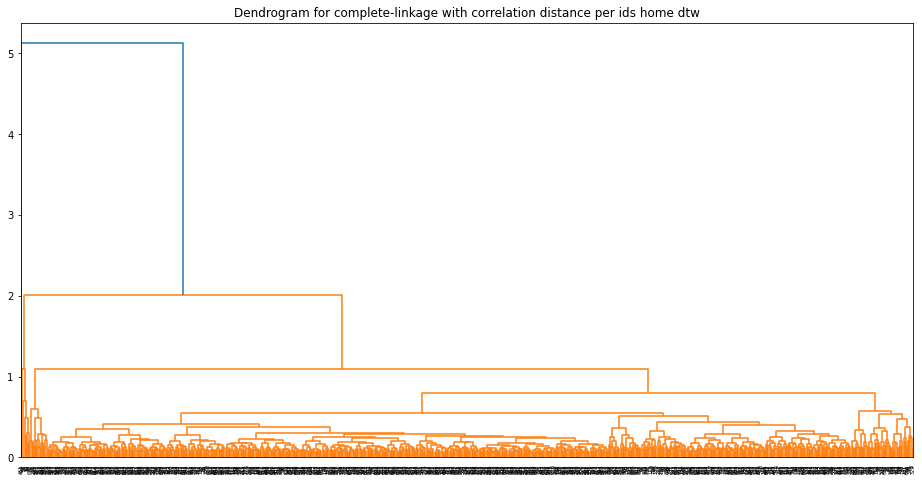

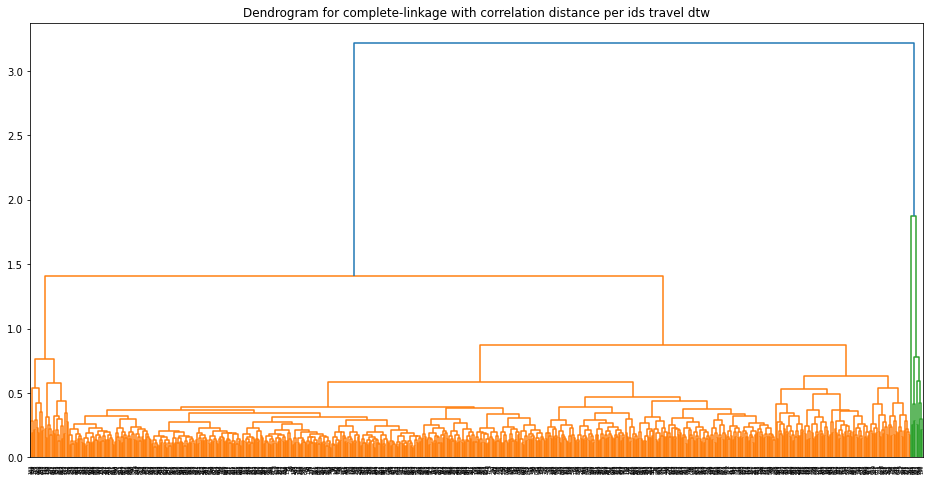

In [109]:
#here we focus on dtw
#ids_matrix_cor = get_cor(ids_matrix)
#obs_matrix_cor = get_cor(obs_matrix)

#ids_linkage_matrix = hierarchical_clustering(ids_matrix_cor)
#obs_linkage_matrix = hierarchical_clustering(obs_matrix_cor)

ids_linkage_matrix_dtw_home_per = hierarchical_clustering(ids_matrix_dtw_home_per, plot_index='per ids home dtw')
ids_linkage_matrix_dtw_travel_per = hierarchical_clustering(ids_matrix_dtw_travel_per, plot_index='per ids travel dtw')

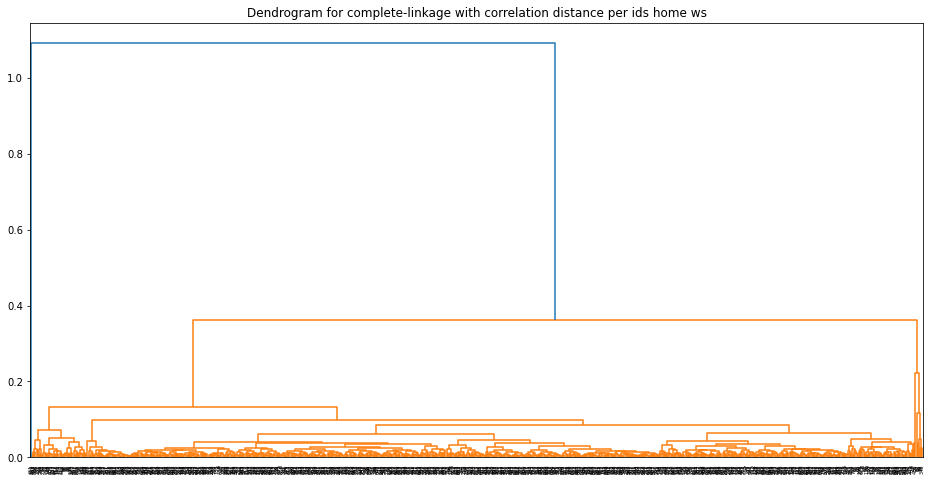

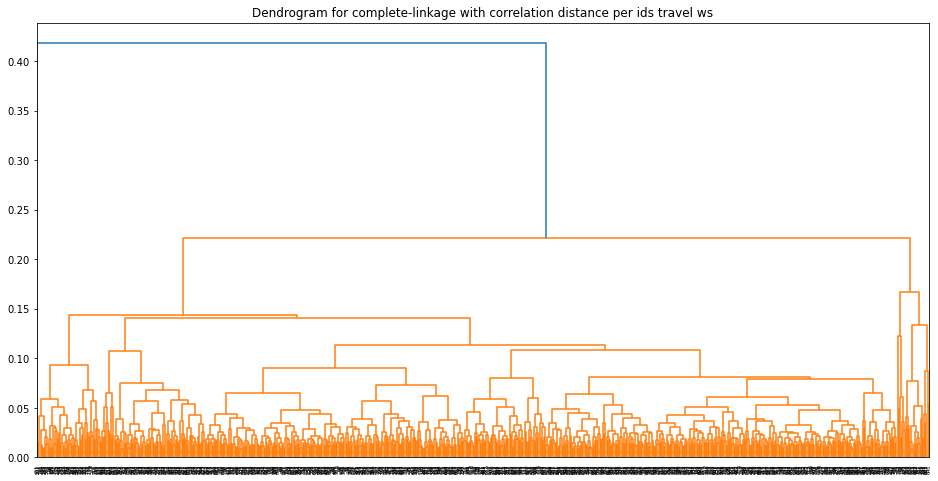

In [110]:
ids_linkage_matrix_ws_home_per = hierarchical_clustering(ids_matrix_ws_home_per, plot_index='per ids home ws')
ids_linkage_matrix_ws_travel_per = hierarchical_clustering(ids_matrix_ws_travel_per, plot_index='per ids travel ws')

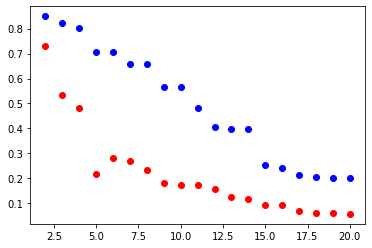

In [111]:
ids_labels_home, ids_sh_score_home = plot_sh_score(ids_home, ids_linkage_matrix_dtw_home, 'red')
ids_labels_travel, ids_sh_score_travel = plot_sh_score(ids_travel, ids_linkage_matrix_dtw_travel, 'blue')

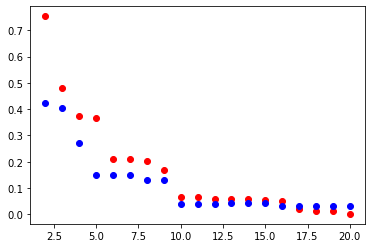

In [112]:
ids_labels_home_per, ids_sh_score_home_per = plot_sh_score(ids_home_per, ids_linkage_matrix_dtw_home_per, 'red')
ids_labels_travel_per, ids_sh_score_travel_per = plot_sh_score(ids_travel_per, ids_linkage_matrix_dtw_travel_per, 'blue')

In [113]:
#cluster_labels_home = fcluster(ids_linkage_matrix_dtw_home, 2, criterion='maxclust')
#print(np.unique(cluster_labels_home))

#cluster_labels_travel = fcluster(ids_linkage_matrix_dtw_travel, 2, criterion='maxclust')
#print(np.unique(cluster_labels_travel))

#based on the clustering results, number of ids per time has two clusters from the travel samples, just as the general samples

In [ ]:
cluster_labels_home == cluster_labels_travel
CensusTract.plot(column='clustered_home',  legend=True)
CensusTract.plot(column='clustered_travel', legend=True)

geoids_lst = np.unique(home_sampledid_num['geoid'])
index_label1 = []
a = 0
for i in range(len(geoids_lst)):
    if cluster_labels_ids[i] == 2:
        index_label1.append(a)
    a = a+1
    
a = 0
b = 0
test_num = 5
for i in range(len(geoids_lst)):
    if i not in index_label1:
        #a=a+1
        #if a<=test_num:
        plt.plot(ids_matrix[i], label='labeled_0', color='blue')
    else:
        #b=b+1
        #if b<=test_num:
        plt.plot(ids_matrix[i], label='labeled_1', color='red')
#plt.legend()'''

a = 0
b = 0
test_num = 10
plt.figure(0)
for i in range(len(geoids_lst)):
    if cluster_labels_home[i] == 1:
        a=a+1
        if a<=test_num:
            plt.plot(ids_home[i], label='labeled_1', color='blue')
    else:
        b=b+1
        if b<=test_num:
            plt.plot(ids_home[i], label='labeled_2', color='red')
plt.title('home')
#plt.legend()

a = 0
b = 0
plt.figure(1)
for i in range(len(geoids_lst)):
    if cluster_labels_travel[i] == 1:
        a=a+1
        if a<=test_num:
            plt.plot(ids_travel[i], label='labeled_1', color='blue')
    else:
        b=b+1
        if b<=test_num:
            plt.plot(ids_travel[i], label='labeled_2', color='red')
plt.title('travelers')

a = 0
b = 0
plt.figure(2)
for i in range(len(geoids_lst)):
    if i not in index_label1:
        a=a+1
        if a<=test_num:
            plt.plot(ids_matrix[i], label='labeled_0', color='blue')
    else:
        b=b+1
        if b<=test_num:
            plt.plot(ids_matrix[i], label='labeled_1', color='red')
plt.title('total')

In [ ]:
#check observation patterns
#get observations  
obs_home = np.zeros(obs_matrix.shape)
obs_travel = np.zeros(obs_matrix.shape)
a = 0
for geoid in np.unique(home_sampleids['geoid']):
    geo_df = home_sampleids[home_sampleids['geoid']==geoid]
    for hr in np.unique(geo_df['hr']):
        geo_df_hr = geo_df[geo_df['hr'] == hr]
        obs_home[a][hr] = sum(geo_df_hr[0][geo_df_hr['newid'].isin(home_dict[geoid][hr])])
        obs_travel[a][hr] = sum(geo_df_hr[0][~ geo_df_hr['newid'].isin(home_dict[geoid][hr])])
    a = a+1
    

In [ ]:
for i in range(len(obs_matrix)):
    plt.figure(i)
    plt.plot(obs_home[i], label='home')
    plt.plot(obs_travel[i], label='travel')
    plt.plot(obs_matrix[i], label='total')
    plt.legend()

In [ ]:
#statistical difference check
#check which distribution represent more when compared with actual data
def cal_sim(num_series1, num_series2, geoid, home_index):
    cal_dict = {}
    chi_stats_dist, chi_p_value = chisquare(num_series1, num_series2)
    ws_dist = wasserstein_distance(num_series1, num_series2)
    if chi_p_value<=0.05:
        signal = 0
    else:
        signal = 1
        print(geoid, home_index)
    cal_dict['chi_square'] = [chi_stats_dist, chi_p_value, signal]
    cal_dict['ws_dist'] = ws_dist
    return(cal_dict)

def check_obs_pattern_stats_dist(home, travel, df_matrix):
    similarity_cal = {}
    a = 0

    for geoid in geoids_lst:
        similarity_cal[geoid] = {'home':{},'travel':{}} 
        home_num = home[a]
        travel_num = travel[a]
        total_num = df_matrix[a]

        similarity_cal[geoid]['home'] = cal_sim(total_num, home_num, geoid, 'home')
        similarity_cal[geoid]['travel'] = cal_sim(total_num, travel_num, geoid, 'travel')
        a = a+1


    chi_square = []
    chi_square_home = []
    ws_dist = []
    ws_dist_home = []
    for geoid in similarity_cal:
        if similarity_cal[geoid]['home']['chi_square'][0]<similarity_cal[geoid]['travel']['chi_square'][0]:
            chi_square.append(1)
            chi_square_home.append(geoid)
        else:
            chi_square.append(0)
        if similarity_cal[geoid]['home']['ws_dist'] < similarity_cal[geoid]['travel']['ws_dist']:
            ws_dist.append(1)
            ws_dist_home.append(geoid)
        else:
            ws_dist.append(0)

    print('chi_square home represents more', sum(chi_square)/len(chi_square))
    print('ws_dist home represents more', sum(ws_dist)/len(ws_dist))        

    #check if there distance result between chi and ws is the same
    print('\n diff ids compared ws and chi')
    if len(ws_dist_home)<=len(chi_square_home):
        for i in ws_dist_home:
            if i not in chi_square_home:
                print(i)
    else:
        for i in chi_square_home:
            if i not in ws_dist_home:
                print(i)
    return(ws_dist_home)

In [ ]:
ws_dist_home_obs = check_obs_pattern_stats_dist(obs_home, obs_travel, obs_matrix)

In [ ]:
CensusTract['home_obs_index_ws'] = 0
CensusTract['home_obs_index_ws'][CensusTract['GEOID10'].isin(ws_dist_home_obs)] = 1
CensusTract.plot(column='home_obs_index_ws',  legend=True)
#impact of similiar homr for obs and ids is similar

In [ ]:
#check what are cts that travelers come from
travel_dict_ct = {}
for geoid in travel_dict:
    travel_dict_ct[geoid]={}
    for hr in travel_dict[geoid]:
        travel_dict_ct[geoid][hr]={}
        for ids in travel_dict[geoid][hr]:
            cts = ids_ct_map[ids]
            if cts not in travel_dict_ct[geoid][hr]:
                travel_dict_ct[geoid][hr][cts] = []
                travel_dict_ct[geoid][hr][cts].append(ids)
            else:
                travel_dict_ct[geoid][hr][cts].append(ids)
'''
#check which ct the travelers comes from
for hr in travel_dict_ct['53033000100']:
    #print(hr, travel_dict_ct['53033000100'][hr])
    print(travel_dict_ct['53033000100'][hr].keys())'''

In [ ]:
#demographic regression check

In [ ]:
#demographic regression

In [ ]:
CensusTract.head(3)

In [ ]:
'''def get_Calinsk_Harabasz_score(df, cluster_model):
    ch_score = {}
    for cluster_num in cluster_model:
        labels = cluster_model[cluster_num]
        score = metrics.calinski_harabasz_score(df.reshape((773, 24)), labels)
        ch_score[cluster_num] = score
    plt.plot(ch_score.keys(), ch_score.values(),'o')
    print(ch_score)

get_Silhouette_score(ids_matrix, ids_clusters_model)
get_Silhouette_score(obs_matrix, obs_cluaster_model)

#km_bis = TimeSeriesKMeans(n_clusters=2, metric="softdtw")
#labels_bis = km_bis.fit_predict(X)
#try different number of clusters, use silhouette score as validation
#source: https://tslearn.readthedocs.io/en/stable/variablelength.html#clustering
#clustering validation
#Silhouette Coefficient and Calinski-Harabasz Index
#source: https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation
#try different clusters
ids_matrix = to_time_series_dataset(ids_matrix)
obs_matrix = to_time_series_dataset(obs_matrix)

clusters_n = [2, 3, 4, 5, 6, 7, 8, 9, 10, 18, 20]
def check_ts_clusters(cluster_lst, df, metric_df):
    cluster_model = {}
    for num_clusters in cluster_lst:
        km = TimeSeriesKMeans(n_clusters=num_clusters, metric=metric_df)
        labels = km.fit_predict(df)
        cluster_model[num_clusters] = labels
    return(cluster_model)
ids_clusters_model = check_ts_clusters(clusters_n, ids_matrix, "dtw")
obs_cluster_model = check_ts_clusters(clusters_n, obs_matrix, "dtw")'''

In [ ]:
'''
#check patterns in different clusters.
geoids_lst = np.unique(home_sampledid_num['geoid'])
index_label1 = []
a = 0
for i in ids_clusters_model[2][1]:
    if i==1:
        index_label1.append(a)
    a = a+1
    
a = 0
b = 0
test_num = 5
for i in range(len(geoids_lst)):
    if i not in index_label1:
        #a=a+1
        #if a<=test_num:
        plt.plot(ids_matrix[i], label='labeled_0', color='blue')
    else:
        #b=b+1
        #if b<=test_num:
        plt.plot(ids_matrix[i], label='labeled_1', color='red')
#plt.legend()'''

In [ ]:
######################################################################### 

In [ ]:
#geographic shape
print(len(CensusTract['GEOID10']))
#ct with demographic info
print(len(demo_ct['GEOID10']))
missing_demo = []

for j in CensusTract['GEOID10']:
    if int(j) not in np.unique(demo_ct['GEOID10']):
        print(j)
        missing_demo.append(j)
        
CensusTract['missing_demo'] = 0
CensusTract['missing_demo'][CensusTract['GEOID10'].isin(missing_demo)] = 1

print('census tract with no demo info')
CensusTract.plot(column='missing_demo',  legend=True)

#home ids
print(len(ids_with_home['GEOID10']))

In [7]:
##################################################################
#demographic regression
#through checking we found that the demographic data is based on ACS 2017 survey
#thus it matches the data collected from cuebiq
demo_ct = pd.read_csv('data_stage1_v1.csv', header=0)
demo_ct.head()
est_sm =pd.read_csv('../model/poi_res_v32.csv', header=0)

est_sm.columns = ['prob','mean','se','sd','10%','90%','n_eff','Rhat']
demo_ct = demo_ct[['pop', 'g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7',\
       'g8', 'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17',\
       'g18','home_ratio','GEOID10','Count_']]

In [ ]:
CensusTract = gpd.read_file('spatial_check/ct2010.shp')
demo_reg_df = pd.read_csv('demo_reg_df.csv')

#obs_Seattle_Bellevue.head(3)
ids_with_home = pd.read_csv('cuebiq_home_psrc_raw.csv', \
                                header=None, sep='\t')
ids_with_home.columns = ['newid','lat','lon']
#conver ids into shapefile
ids_with_home =  gpd.GeoDataFrame(ids_with_home,\
                                  geometry=gpd.points_from_xy(ids_with_home['lon'],\
                                                              ids_with_home['lat']),\
                                  crs={'init': 'epsg:4326'})
ids_with_home = gpd.tools.sjoin(ids_with_home, CensusTract, how='left')
ids_with_home = ids_with_home[['newid','lat', 'lon','GEOID10']]

def get_homeloc(selected_ids):
    ids_with_home = pd.read_csv('cuebiq_home_psrc_raw.csv', \
                                header=None, sep='\t')
    ids_with_home.columns = ['newid','lat','lon']
    #conver ids into shapefile
    ids_with_home = ids_with_home[ids_with_home['GEOID10'].isin(selected_idsds)]
    ids_with_home =  gpd.GeoDataFrame(ids_with_home,\
                                      geometry=gpd.points_from_xy(ids_with_home['lon'],\
                                                                  ids_with_home['lat']),\
                                      crs={'init': 'epsg:4326'})
    ids_with_home = gpd.tools.sjoin(ids_with_home, CensusTract, how='left')
    ids_with_home = ids_with_home[['newid','lat', 'lon','GEOID10']]
    return(ids_with_home)

#ids = np.unique(obs_Seattle_Bellevue['newid'])
#ids_with_home_bs = get_homeloc(ids)

#get the sample ratio
#per = group_pop/pop*.81*est_per
#resclae it so that sum_per=1
pop_ids = ids_with_home.groupby(['GEOID10']).size().to_frame()
pop_ids.reset_index(inplace=True)
pop_ids.columns = ['GEOID10','sum']

demo_geo = demo_ct[demo_ct['GEOID10'].isin(pop_ids['GEOID10'])]
demo_geo['GEOID10'] = demo_geo['GEOID10'].astype(str)
pop_ids = pop_ids.merge(demo_geo, on=["GEOID10", "GEOID10"])
pop_ids = pop_ids.sort_values(['GEOID10'])

#percentage calculation based on smartphone demographic variety
def get_sm_per(pop_ids, num_groups):
    num_group = num_groups
    sample_ids = pd.DataFrame()
    est_ratio = []
    sample_ids['GEOID10'] = pop_ids['GEOID10']
    sample_ids['sum'] = pop_ids['sum']
    
    np.random.seed(42)
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = pop_ids['g'+str(i+1)]*(np.random.normal(est_sm['mean'][i], est_sm['se'][i],1)[0])*(np.random.normal(est_sm['mean'][18], est_sm['se'][18],1)[0])
        est_ratio.append(np.random.normal(est_sm['mean'][i], est_sm['se'][i],1)[0])
    est_ratio.append(np.random.normal(est_sm['mean'][18], est_sm['se'][18],1)[0])
        
    sample_ids['per_sum'] = sample_ids[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
                'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].sum(axis=1)
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = sample_ids['g'+str(i+1)]/sample_ids['per_sum']
        sample_ids['g'+str(i+1)] = round(sample_ids['g'+str(i+1)]*sample_ids['sum'],1)
    return(sample_ids, est_ratio)

def get_pop_per(sample_ids, num_groups):
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = sample_ids['g'+str(i+1)]/sample_ids['pop']
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = round(sample_ids['g'+str(i+1)]*sample_ids['sum'],1)
    return(sample_ids)

def assign_demo(sample_ids, id_data, random_seed):
    random.seed(random_seed)
    demo_labels = []
    #convert sample ids into int
    sample_ids_dict = {}
    for i in ['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
            'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']:
        sample_ids_dict[i] = []
    
    for i in range(len(sample_ids.index)):
        census_demo = sample_ids[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
            'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].iloc[i].to_frame()
        census_demo.columns = ['ori']
        census_demo['int'] = (census_demo['ori']).astype('int')
        census_demo['float'] = census_demo['ori']-census_demo['int']
        census_demo['group_num'] = round(census_demo['ori'],0)
        
        current_sum = census_demo['group_num'].sum()
        ct_sum = sample_ids['sum'][i]
        diff = int(current_sum-ct_sum)
        if diff < 0:
            #convert negative number to positive number
            diff = -diff
            index_num = census_demo[(census_demo['float']<=0.4)].sort_values(by=['float','int'], ascending=False).index[:diff]
            for j in index_num:
                census_demo.at[j,'group_num'] = census_demo.at[j,'group_num']+1
        elif diff > 0:
            #get list of data since -1 can cause negative number
            dt = census_demo[(census_demo['float']>=0.5)].sort_values(by=['float','int'])
            #assign an number to match the diff num
            test_num = 0
            for k in dt.index:
                if test_num < diff:
                    if  census_demo.at[k,'group_num']-1 >= 0:
                        census_demo.at[k,'group_num'] = census_demo.at[k,'group_num']-1
                        test_num = test_num+1
                    else:
                        pass
                else:
                    break
        else:
            pass
        
        if census_demo['group_num'].sum()-sample_ids['sum'][i] != 0:
            print('error!, check the code')
            print(i)
            print(census_demo)
            print(census_demo['group_num'].sum())
            print(sample_ids['sum'][i])
        
        else:
            for k in range(len(census_demo['group_num'])):
                sample_ids_dict[census_demo.index[k]].append(census_demo['group_num'][k])
                
            demo_label = []
            #print(i)
            #print(census_demo)
            for m in range(len(census_demo['group_num'])):
                demo_num = census_demo['group_num'].index[m]
                demo_label.extend(list(np.repeat(demo_num, census_demo['group_num'][m])))
            random.shuffle(demo_label)
            demo_labels.extend(demo_label)
    id_data['demo_group'] = demo_labels
    
    return(id_data)

sample_ids, est_ratio = get_sm_per(pop_ids, 18)
ids_with_home = assign_demo(sample_ids, ids_with_home, 42)

In [8]:
pop_ids.head(3)

,GEOID10,sum,pop,g1,g2,g3,g4,g5,g6,g7,...,g11,g12,g13,g14,g15,g16,g17,g18,home_ratio,Count_
0,53033000100,180,7963,1064,784,805,544,633,1149,74,...,313,432,58,178,264,43,240,271,0.022605,180
1,53033000200,189,7973,675,762,1030,605,575,980,137,...,297,617,12,148,270,34,306,472,0.023705,189
2,53033000300,70,2822,307,346,328,261,163,397,60,...,132,154,29,50,49,7,112,81,0.024805,70


In [ ]:
#assign demo info for selected ids
#set random seed as 42
#for group_num in test:
    #pop_ids['sm_'+group_num] = test[group_num]

In [ ]:
#this part can be ignored since we already generated the data
'''
demo_reg_df = CensusTract[['index', 'GEOID10', 'NAME10', 'INTPTLAT10', 'INTPTLON10',\
                    'geometry','clustered_ids','clustered_ids_per', 'home_index_ws', \
                    'home_index_dtw', 'home_index_chi', 'missing_demo' ]]

demo_reg_df = demo_reg_df.merge(pop_ids, how='right', on='GEOID10')

#check variables
print(demo_reg_df.columns)

#convert num to percent
for i in range(1, 19):
    demo_reg_df['g'+str(i)] = demo_reg_df['g'+str(i)]/demo_reg_df['pop']
    demo_reg_df['sm_g'+str(i)] = demo_reg_df['sm_g'+str(i)]/demo_reg_df['Count_']
    
'''

In [9]:
demo_reg_df.columns

Index(['Unnamed: 0', 'index', 'GEOID10', 'NAME10', 'INTPTLAT10', 'INTPTLON10',
       'geometry', 'clus_ids', 'clus_ids_per', 'h_ws',
       ...
       't_g9_sm', 't_g10_sm', 't_g11_sm', 't_g12_sm', 't_g13_sm', 't_g14_sm',
       't_g15_sm', 't_g16_sm', 't_g17_sm', 't_g18_sm'],
      dtype='object', length=109)

In [ ]:
#conduct regression for clusters
def get_ids_info(travel_info):
    ids_number = []
    for hr in travel_info:
        ids_number.extend(travel_info[hr])
    return(list(np.unique(ids_number)))

#get traveler sample pop
def get_demo_info(travel_info, ids_ct_map):
    ids_number = get_ids_info(travel_info)
    ct_group = {}
    for ids in ids_number:
        ct_number = ids_ct_map[ids]
        if ct_number not in ct_group:
            ct_group[ct_number] = 1
        else:
            ct_group[ct_number] += 1
    return(ct_group)
    
#calculate the demograohic group sample pop from travel pop
def cal_demo_pop(travel_sample_pop, demo_per_dict):
    len_geos = len(travel_sample_pop.keys())
    demos = 36
    demos_sample = np.zeros((len_geos, demos))
    geoids = list(travel_sample_pop.keys())
    
    for i in range(len_geos):
        sample_pop = travel_sample_pop[geoids[i]]
        demo_per = np.array(demo_per_dict[geoids[i]][2:])
        demos_sample[i] = sample_pop * demo_per
        
    return(np.sum(demos_sample, axis=0))

#list(demo_reg_df[['sum', 'pop', 'g1', 'g2', 'g3', 'g4', 'g5', 'g6','g7', 'g8', 'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16',\
#             'g17', 'g18', 'sm_g1', 'sm_g2', 'sm_g3', 'sm_g4','sm_g5', 'sm_g6', 'sm_g7', 'sm_g8', 'sm_g9', \
#             'sm_g10', 'sm_g11','sm_g12', 'sm_g13', 'sm_g14', 'sm_g15', 'sm_g16', 'sm_g17', 'sm_g18']].iloc[0].values)

demo_per_dict = {}
a = 0
for i in demo_reg_df['GEOID10']:
    demo_per_dict[str(i)] = list(demo_reg_df[['sum', 'pop', 'g1', 'g2', 'g3', 'g4', 'g5', 'g6','g7', 'g8', 'g9', 'g10', 'g11', \
                                         'g12', 'g13', 'g14', 'g15', 'g16','g17', 'g18', 'sm_g1', 'sm_g2', 'sm_g3', 'sm_g4',\
                                         'sm_g5', 'sm_g6', 'sm_g7', 'sm_g8', 'sm_g9','sm_g10', 'sm_g11','sm_g12', 'sm_g13',\
                                         'sm_g14', 'sm_g15', 'sm_g16', 'sm_g17', 'sm_g18']].iloc[a].values)
    a += 1
    
#get demo info from travel dict
travel_demo_info = {}
for geoid in travel_dict:
    travel_sample_pop = get_demo_info(travel_dict[geoid], ids_ct_map)
    travel_demo_info[geoid] = cal_demo_pop(travel_sample_pop, demo_per_dict)

#convert cluster # from 1-2 to 0-1
for i in demo_reg_df.columns:
    if 'clustered' in i:
        demo_reg_df[i] = demo_reg_df[i]-1

#revise the variable
#age
#for home ids
gender_index = [[1, 2, 3, 7, 8, 9, 13, 14, 15],[4,5,6,10,11,12,16,17,18]]
age_index = [[1,2,3,4,5,6],[7,8,9,10,11,12],[13,14,15,16,17,18]]
edu_index = [[1,4,7,10,13,16],[2,5,8,11,14,17],[3,6,9,12,15,18]]
def revise_data(index_lst, origin_demo=True):
    #generate_var list
    var_lst = []
    for index_num in range(len(index_lst)):
        var_lst.append([0])
    if origin_demo == True:     
        for i in range(1, 19):
            for j in range(len(index_lst)):
                if i in index_lst[j]:
                    var_lst[j] = var_lst[j] + demo_reg_df['g'+str(i)]
    else:
        for i in range(1, 19):
            for j in range(len(index_lst)):
                if i in index_lst[j]:
                    var_lst[j] = var_lst[j] + demo_reg_df['sm_g'+str(i)]
    #find the highest percentage and treat it as the index sign of the data
    var_lst = np.array(var_lst).T
    index_sign = []
    for calculate_per in var_lst:
        max_per = max(calculate_per)
        index = np.where(calculate_per==max_per)[0][0]
        index_sign.append(index)   
    return(index_sign)

def revise_data_from_travel(index_lst, travel_demo_info, pop_demo = True):
    #generate_var list
    index_num = len(index_lst)
    index_col = len(index_lst[0])
    
    index_arr = np.array(np.hstack(index_lst)).reshape((index_num, index_col))
    
    var_lst = []
    #minus to match the number from python array
    
    if pop_demo == True:
        for i in range(index_num):
            index_lst[i] = list(index_arr[i] - 1)
            var_lst.append([])
    else:
        for i in range(index_num):
            index_lst[i] = list(index_arr[i] +17)
            var_lst.append([])

   # print(index_lst)
    
    for geoid in travel_demo_info:
        for j in range(index_num):
            var_lst[j].append(np.sum(travel_demo_info[geoid][index_lst[j]]))
    
    var_lst = np.array(var_lst).T
    #print(var_lst.shape)
    index_sign = []
    for per in var_lst:
        #print(per)
        max_per = max(per)
        index = np.where(per==max_per)[0][0]
        #print(index)
        index_sign.append(index)   
    return(index_sign)  

def assign_travel_demo2demodf(travel_demo_info, index_lst, demo_reg_df, colname, pop_demo = True):
    index_sign = revise_data_from_travel(index_lst, travel_demo_info, pop_demo)
    
    geoid_df = list(demo_reg_df['GEOID10'].values)
    geoid_travel = list(travel_demo_info.keys())
    values_lst = []
    for i in geoid_df:
        geos = str(i)
        if geos in geoid_travel:
            index_num = geoid_travel.index(geos)
            values_lst.append(index_sign[index_num])
    demo_reg_df[colname] = values_lst
    return(1)

demo_reg_df['age_index'] = revise_data(age_index, True)
demo_reg_df['age_index_sm'] = revise_data(age_index, False)

demo_reg_df['edu_index'] = revise_data(edu_index, True)
demo_reg_df['edu_index_sm'] = revise_data(edu_index, False)

demo_reg_df['gender_index'] = revise_data(gender_index, True)
demo_reg_df['gender_index_sm'] = revise_data(gender_index, False)

#convert number of ids into per
for geoid in travel_demo_info:
    travel_demo_info[geoid][:18] = travel_demo_info[geoid][:18]/(np.sum(travel_demo_info[geoid][:18]))
    travel_demo_info[geoid][18:] = travel_demo_info[geoid][18:]/(np.sum(travel_demo_info[geoid][18:]))
    
gender_index = [[1, 2, 3, 7, 8, 9, 13, 14, 15],[4,5,6,10,11,12,16,17,18]]
age_index = [[1,2,3,4,5,6],[7,8,9,10,11,12],[13,14,15,16,17,18]]
edu_index = [[1,4,7,10,13,16],[2,5,8,11,14,17],[3,6,9,12,15,18]]

assign_travel_demo2demodf(travel_demo_info, gender_index, demo_reg_df, 'travel_gender', True)
assign_travel_demo2demodf(travel_demo_info, gender_index, demo_reg_df, 'travel_gender_sm', False)
assign_travel_demo2demodf(travel_demo_info, age_index, demo_reg_df, 'travel_age', True)
assign_travel_demo2demodf(travel_demo_info, age_index, demo_reg_df, 'travel_age_sm', False)
assign_travel_demo2demodf(travel_demo_info, edu_index, demo_reg_df, 'travel_edu', True)
assign_travel_demo2demodf(travel_demo_info, edu_index, demo_reg_df, 'travel_edu_sm', False)

geoids = list(demo_reg_df['GEOID10'].values)

travel_per_dt = np.zeros((len(geoids), 36))
for i in range(len(geoids)):
    if geoids[i] in travel_demo_info.keys():
        travel_per_dt[i] = travel_demo_info[geoids[i]]
        
travel_per_dt.T.shape

#read urban and rural data
rural_urban_dt = pd.read_csv('spatial_check/rural_urban/DECENNIALSF12010.H2_data_with_overlays_2021-09-01T015851.csv', header=1)
#convert id`
GEOIDs = []
for i in rural_urban_dt['id']:
    GEOIDs.append(i[9:])
    
rural_urban_dt['GEOID10'] = GEOIDs

#merge data
demo_reg_df = demo_reg_df.merge(rural_urban_dt, how='inner', on='GEOID10')

for i in range(36):
    if i<18:
        demo_reg_df['t_'+'g'+str(i+1)] = travel_per_dt.T[i]
    else:
        demo_reg_df['t_'+'g'+str(i-17)+'_sm'] = travel_per_dt.T[i]
        
#print orginal col names
print('original col name')
print(demo_reg_df.columns)

#conver col name for better decision
demo_reg_df.columns = ['index', 'GEOID10', 'NAME10', 'INTPTLAT10', 'INTPTLON10', 'geometry',\
                       'clus_ids', 'clus_ids_per', 'h_ws', 'h_dtw',\
                       'h_chi', 'miss', 'sum', 'pop', 'g1', 'g2', 'g3', 'g4',\
                       'g5', 'g6', 'g7', 'g8', 'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15',\
                       'g16', 'g17', 'g18', 'home_ratio', 'Count_', 'sm_g1', 'sm_g2', 'sm_g3',\
                       'sm_g4', 'sm_g5', 'sm_g6', 'sm_g7', 'sm_g8', 'sm_g9', 'sm_g10',\
                       'sm_g11', 'sm_g12', 'sm_g13', 'sm_g14', 'sm_g15', 'sm_g16', 'sm_g17',\
                       'sm_g18', 'travel_gender', 'travel_gender_sm', 'age_index',\
                       'age_index_sm', 'edu_index', 'edu_index_sm', 'gender_index',\
                       'gender_index_sm', 'travel_age', 'travel_age_sm', 'travel_edu',\
                       'travel_edu_sm', 'id', 'Geographic Area Name', 'total', 'Urban','Urb1','Ur2', \
                       'Rural','unknown','t_g1', 't_g2', 't_g3', 't_g4', 't_g5', 't_g6', 't_g7', 't_g8',\
                       't_g9', 't_g10', 't_g11', 't_g12', 't_g13', 't_g14', 't_g15', 't_g16', 't_g17', 't_g18',\
                        't_g1_sm', 't_g2_sm', 't_g3_sm', 't_g4_sm', 't_g5_sm', 't_g6_sm', 't_g7_sm', 't_g8_sm',\
                        't_g9_sm', 't_g10_sm', 't_g11_sm', 't_g12_sm', 't_g13_sm', 't_g14_sm', 't_g15_sm', 't_g16_sm',\
                        't_g17_sm', 't_g18_sm']

def binomial_reg(df, formula, y):
    #Separate out the training and test sets
    sep_traintest = np.random.rand(len(df)) < 0.85
    df_train = df[sep_traintest]
    df_test = df[~sep_traintest]
    print(np.unique(df_train[y]))
    clustered_label = np.unique(df[y])[0]
    print(clustered_label)
    print(len(df_train[y][df_train[y]==clustered_label])/len(df_train[y]))
    print(len(df_test[y][df_test[y]==clustered_label])/len(df_test[y]))
    if len(np.unique(df_train[y])) == 1:
        print('dependent y clustered almost the same')
    
    y_train, X_train = dmatrices(formula, df_train, return_type = 'dataframe')
    y_test, X_test = dmatrices(formula, df_test, return_type = 'dataframe')
    
    binom_model = sm.GLM(y_train, X_train, family=sm.families.Binomial())
    binom_model_result = binom_model.fit()
    print(binom_model_result.summary())
    
def get_formula(y):
    formula = y+' ~ '
    for i in range(1, 19):
        if i == 1:
            formula = formula + 'g'+str(i) + '+sm_g' + str(i)
        else:
            formula = formula + '+g'+str(i) + '+sm_g' + str(i)
    return(formula)
       
ids_formula_home = get_formula('clustered_home')

demo_reg_df.to_csv('demo_reg_df.csv')
#detailed regression is shown in R

#here we only focus on locations of which home shows shorter stats dist
#shorter home dist for idnetified ids pattern
'''df_home_ids = demo_reg_df[demo_reg_df['home_index']==1]
print(len(df_home_ids['home_index']))
#shorter home dist for idnetified obs pattern
df_home_obs = demo_reg_df[demo_reg_df['home_obs_index_ws']==1]
print(len(df_home_obs['home_obs_index_ws']))

binomial_reg(df_home_ids, ids_formula_home, 'clustered_home')'''


In [ ]:
###############################################################################################################################

In [11]:
#Seattle_Bellevue case study
#rating info
obs_Seattle_Bellevue.head(3)

NameError: name 'obs_Seattle_Bellevue' is not defined

In [238]:
print('summary of obs')
print(obs_Seattle_Bellevue['obs'].describe())
print('summary of norm_obs_5')
print(obs_Seattle_Bellevue['norm_obs_5'].describe())

summary of obs
count    717765.000000
mean          2.131175
std           4.260824
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max         168.000000
Name: obs, dtype: float64
summary of norm_obs_5
count    717765.000000
mean          0.063428
std           0.126810
min           0.029762
25%           0.029762
50%           0.029762
75%           0.059524
max           5.000000
Name: norm_obs_5, dtype: float64


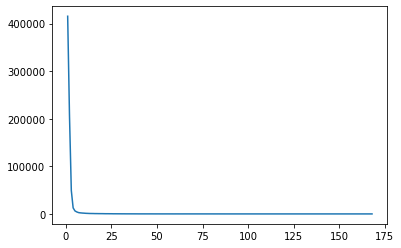

In [239]:
#check the obs number within per ct per time
#it is found that most of the obs is less than 100000
obs_count = obs_Seattle_Bellevue.groupby(['obs']).size().to_frame()
obs_count.reset_index(inplace=True)
obs_count.columns = ['obs','count']
plt.plot(obs_count['obs'], obs_count['count'])

In [240]:
print(len(obs_Seattle_Bellevue['GEOID10'][obs_Seattle_Bellevue['obs']>=1]))
print(len(obs_Seattle_Bellevue['GEOID10'][obs_Seattle_Bellevue['obs']>=3]))
print(len(obs_Seattle_Bellevue['GEOID10'][obs_Seattle_Bellevue['obs']>=10]))
print(len(obs_Seattle_Bellevue['GEOID10'][obs_Seattle_Bellevue['obs']>=20]))
print(len(obs_Seattle_Bellevue['GEOID10'][obs_Seattle_Bellevue['obs']>=50]))
print(len(obs_Seattle_Bellevue['GEOID10'][obs_Seattle_Bellevue['obs']>=100]))

717765
95704
16504
7468
1395
13


In [241]:
nb_locts = len(np.unique(obs_Seattle_Bellevue['spatial_temporal_id']))
nb_ids = len(np.unique(obs_Seattle_Bellevue['newid']))

In [242]:
nb_locts = len(np.unique(obs_Seattle_Bellevue['GEOID10']))*len(np.unique(obs_Seattle_Bellevue['hr']))*len(np.unique(obs_Seattle_Bellevue['minut_5']))

In [243]:
obs_Seattle_Bellevue.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id,norm_obs,norm_obs_5
0,53033000100,0,0,9856,1,53033000100_0_0,0.005952,0.029762
1,53033000100,0,0,23929,3,53033000100_0_0,0.017857,0.089286
2,53033000100,0,0,36465,2,53033000100_0_0,0.011905,0.059524


In [ ]:
#os.listdir('G:/My Drive/2020/Bias/data-processing/spatial_check/')

In [ ]:
#since our simulation focused only on Seattle data
#the data is now shrinked only for downtown Seattle

In [5]:
#since the data is a lot, thus we started with a smaller scale
#focusing on the Downtown Seattle
path_spatial = 'G:/My Drive/2020/Bias/data-processing/spatial_check/'
Seattle = gpd.read_file(path_spatial+'downtown_Seattle.shp')
Seattle_geo =list(np.unique(Seattle['GEOID10']))

In [30]:
#obs_Seattle = obs_Seattle_Bellevue[obs_Seattle_Bellevue['GEOID10'].isin(Seattle_geo)]

In [31]:
#obs_Seattle = norm_data(obs_Seattle)

<ipython-input-28-7dbfb17ea718>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['norm_obs'] = df['obs']/max_num
<ipython-input-28-7dbfb17ea718>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['norm_obs_5'] = df['norm_obs']*5


In [ ]:
#get test data
obs_Seattle = pd.read_csv('obs_Seattle.csv')
Seattle_ids = list(np.unique(obs_Seattle['GEOID10']))
#convert_to_string
a = 0 
for ids in Seattle_ids:
    Seattle_ids[a] = str(ids)
    a += 1
latlon_Seattle = latlon_shape[latlon_shape['GEOID10'].isin(Seattle_ids)]
latlon_Seattle = latlon_Seattle.reset_index()
latlon_Seattle.to_csv('latlon_Seattle.csv', index=False)


Seattle_ct = pd.read_csv('Seattle_ct.csv')
latlon_Seattle = pd.read_csv('latlon_Seattle.csv')

newids = list(np.unique(latlon_Seattle['newid']))

test_latlon = latlon_Seattle[latlon_Seattle['newid'].isin(newids[:10])]
#test_latlon.to_csv('test_latlon.csv', index=False)m



In [8]:
#obs_Seattle.to_csv('obs_Seattle.csv')
obs_Seattle = pd.read_csv('obs_Seattle.csv', index_col=0)

In [9]:
obs_Seattle.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id,norm_obs,norm_obs_5
211948,53033007100,0,0,7528,1,53033007100_0_0,0.012195,0.060976
211949,53033007100,0,0,36180,2,53033007100_0_0,0.024390,0.121951
211950,53033007100,0,0,54917,1,53033007100_0_0,0.012195,0.060976


In [10]:
#convert_data
#get total locts
def get_total_locts(obs_data):
    locts = []
    for geoid in np.unique(obs_data['GEOID10']):
        for hr in np.unique(obs_data['hr']):
            for minut in np.unique(obs_data['minut_5']):
                a = str(geoid)+'_'+str(hr)+'_'+str(minut)
                locts.append(a)
    nb_locts = len(locts)
    return(locts, nb_locts)

In [11]:
locts, nb_locts = get_total_locts(obs_Seattle)
nb_ids = len(np.unique(obs_Seattle['newid']))
obs_Seattle.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id,norm_obs,norm_obs_5
211948,53033007100,0,0,7528,1,53033007100_0_0,0.012195,0.060976
211949,53033007100,0,0,36180,2,53033007100_0_0,0.024390,0.121951
211950,53033007100,0,0,54917,1,53033007100_0_0,0.012195,0.060976


In [12]:
#through checking we found that the demographic data is based on ACS 2017 survey
#thus it matches the data collected from cuebiq
demo_ct = pd.read_csv('data_stage1_v1.csv', header=0)
demo_ct.head()
est_sm =pd.read_csv('../model/poi_res_v32.csv', header=0)

est_sm.columns = ['prob','mean','se','sd','10%','90%','n_eff','Rhat']
demo_ct = demo_ct[['pop', 'g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7',\
       'g8', 'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17',\
       'g18','home_ratio','GEOID10','Count_']]

CensusTract = gpd.read_file('spatial_check/ct2010.shp')
demo_reg_df = pd.read_csv('demo_reg_df.csv')

#obs_Seattle_Bellevue.head(3)
ids_with_home = pd.read_csv('cuebiq_home_psrc_raw.csv', \
                                header=None, sep='\t')
ids_with_home.columns = ['newid','lat','lon']
#conver ids into shapefile
ids_with_home =  gpd.GeoDataFrame(ids_with_home,\
                                  geometry=gpd.points_from_xy(ids_with_home['lon'],\
                                                              ids_with_home['lat']),\
                                  crs={'init': 'epsg:4326'})
ids_with_home = gpd.tools.sjoin(ids_with_home, CensusTract, how='left')
ids_with_home = ids_with_home[['newid','lat', 'lon','GEOID10']]

C:\Users\29700\anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
<ipython-input-12-6eb597774053>:24: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg:4326 +type=crs
Right CRS: EPSG:4326

  ids_with_home = gpd.tools.sjoin(ids_with_home, CensusTract, how='left')


In [13]:
def get_homeloc(selected_ids):
    ids_with_home = pd.read_csv('cuebiq_home_psrc_raw.csv', \
                                header=None, sep='\t')
    ids_with_home.columns = ['newid','lat','lon']
    #conver ids into shapefile
    ids_with_home = ids_with_home[ids_with_home['GEOID10'].isin(selected_idsds)]
    ids_with_home =  gpd.GeoDataFrame(ids_with_home,\
                                      geometry=gpd.points_from_xy(ids_with_home['lon'],\
                                                                  ids_with_home['lat']),\
                                      crs={'init': 'epsg:4326'})
    ids_with_home = gpd.tools.sjoin(ids_with_home, CensusTract, how='left')
    ids_with_home = ids_with_home[['newid','lat', 'lon','GEOID10']]
    return(ids_with_home)

#ids = np.unique(obs_Seattle_Bellevue['newid'])
#ids_with_home_bs = get_homeloc(ids)

#get the sample ratio
#per = group_pop/pop*.81*est_per
#resclae it so that sum_per=1
pop_ids = ids_with_home.groupby(['GEOID10']).size().to_frame()
pop_ids.reset_index(inplace=True)
pop_ids.columns = ['GEOID10','sum']

demo_geo = demo_ct[demo_ct['GEOID10'].isin(pop_ids['GEOID10'])]
demo_geo['GEOID10'] = demo_geo['GEOID10'].astype(str)
pop_ids = pop_ids.merge(demo_geo, on=["GEOID10", "GEOID10"])
pop_ids = pop_ids.sort_values(['GEOID10'])

#percentage calculation based on smartphone demographic variety
def get_sm_per(pop_ids, num_groups):
    num_group = num_groups
    sample_ids = pd.DataFrame()
    est_ratio = []
    sample_ids['GEOID10'] = pop_ids['GEOID10']
    sample_ids['sum'] = pop_ids['sum']
    
    np.random.seed(42)
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = pop_ids['g'+str(i+1)]*(np.random.normal(est_sm['mean'][i], est_sm['se'][i],1)[0])*(np.random.normal(est_sm['mean'][18], est_sm['se'][18],1)[0])
        est_ratio.append(np.random.normal(est_sm['mean'][i], est_sm['se'][i],1)[0])
    est_ratio.append(np.random.normal(est_sm['mean'][18], est_sm['se'][18],1)[0])
        
    sample_ids['per_sum'] = sample_ids[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
                'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].sum(axis=1)
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = sample_ids['g'+str(i+1)]/sample_ids['per_sum']
        sample_ids['g'+str(i+1)] = round(sample_ids['g'+str(i+1)]*sample_ids['sum'],1)
    return(sample_ids, est_ratio)

def get_pop_per(sample_ids, num_groups):
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = sample_ids['g'+str(i+1)]/sample_ids['pop']
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = round(sample_ids['g'+str(i+1)]*sample_ids['sum'],1)
    return(sample_ids)

def assign_demo(sample_ids, id_data, random_seed):
    random.seed(random_seed)
    demo_labels = []
    #convert sample ids into int
    sample_ids_dict = {}
    for i in ['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
            'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']:
        sample_ids_dict[i] = []
    
    for i in range(len(sample_ids.index)):
        census_demo = sample_ids[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
            'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].iloc[i].to_frame()
        census_demo.columns = ['ori']
        census_demo['int'] = (census_demo['ori']).astype('int')
        census_demo['float'] = census_demo['ori']-census_demo['int']
        census_demo['group_num'] = round(census_demo['ori'],0)
        
        current_sum = census_demo['group_num'].sum()
        ct_sum = sample_ids['sum'][i]
        diff = int(current_sum-ct_sum)
        if diff < 0:
            #convert negative number to positive number
            diff = -diff
            index_num = census_demo[(census_demo['float']<=0.4)].sort_values(by=['float','int'], ascending=False).index[:diff]
            for j in index_num:
                census_demo.at[j,'group_num'] = census_demo.at[j,'group_num']+1
        elif diff > 0:
            #get list of data since -1 can cause negative number
            dt = census_demo[(census_demo['float']>=0.5)].sort_values(by=['float','int'])
            #assign an number to match the diff num
            test_num = 0
            for k in dt.index:
                if test_num < diff:
                    if  census_demo.at[k,'group_num']-1 >= 0:
                        census_demo.at[k,'group_num'] = census_demo.at[k,'group_num']-1
                        test_num = test_num+1
                    else:
                        pass
                else:
                    break
        else:
            pass
        
        if census_demo['group_num'].sum()-sample_ids['sum'][i] != 0:
            print('error!, check the code')
            print(i)
            print(census_demo)
            print(census_demo['group_num'].sum())
            print(sample_ids['sum'][i])
        
        else:
            for k in range(len(census_demo['group_num'])):
                sample_ids_dict[census_demo.index[k]].append(census_demo['group_num'][k])
                
            demo_label = []
            #print(i)
            #print(census_demo)
            for m in range(len(census_demo['group_num'])):
                demo_num = census_demo['group_num'].index[m]
                demo_label.extend(list(np.repeat(demo_num, census_demo['group_num'][m])))
            random.shuffle(demo_label)
            demo_labels.extend(demo_label)
            #convert demo label to number lebels
            num_demo_labels = []
            for labels in demo_labels:
                num_demo_labels.append(int(labels[1:]))
    id_data['demo_group'] = num_demo_labels
    
    return(id_data)

sample_ids, est_ratio = get_sm_per(pop_ids, 18)
ids_with_home = assign_demo(sample_ids, ids_with_home, 42)

In [13]:
#assign demo info for selected ids
#set random seed as 42
#for group_num in test:
#    pop_ids['sm_'+group_num] = test[group_num]

In [14]:
#calculate the demographic bias 
#use wasserstein_distance
from scipy.stats import wasserstein_distance
def get_demo_ratio(df, num_groups):
    num_group = num_groups
    
    demo_ratio = pd.DataFrame()
    demo_ratio['GEOID10'] = df['GEOID10']
    demo_ratio['pop'] = df['pop']
    for i in range(num_group):
        demo_ratio['g'+str(i+1)] = df['g'+str(i+1)]/df['pop']
    return(demo_ratio)

#percentage of different demo based on the smartphone pop
def get_smart_demo_ratio(df, est_ratio, num_groups):
    smart_ratio = pd.DataFrame()
    smart_ratio['GEOID10'] = df['GEOID10']
    for i in range(num_groups):
        smart_ratio['g'+str(i+1)] = df['g'+str(i+1)]*est_ratio[i]
    smart_ratio['sm_sum'] =  smart_ratio[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
                'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].sum(axis=1)
    for i in range(num_groups):
        smart_ratio['g'+str(i+1)] = smart_ratio['g'+str(i+1)]/smart_ratio['sm_sum']
    
    smart_ratio['ratio_sum'] =  smart_ratio[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
                'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].sum(axis=1)
    return(smart_ratio)

#calculate the statistical distance
def cal_stat_dist(demo_ratio, smart_ratio):
    stats_df = pd.DataFrame()
    stats_df['GEOID10'] = demo_ratio['GEOID10']
    ws_dist = []
    group_names = ['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
                'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']
    for geoid in stats_df['GEOID10']:
        ws_dist.append(wasserstein_distance(demo_ratio[group_names][demo_ratio['GEOID10']==geoid].values[0]*smart_ratio['sm_sum'][smart_ratio['GEOID10']==geoid].values[0],\
                                         smart_ratio[group_names][smart_ratio['GEOID10']==geoid].values[0]*smart_ratio['sm_sum'][smart_ratio['GEOID10']==geoid].values[0]))

    stats_df['ws_dist'] = ws_dist
    return(stats_df)
     

sample_ids, est_ratios = get_sm_per(pop_ids, 18)

demo_ratio_Seattle = get_demo_ratio(pop_ids[pop_ids['GEOID10'].isin(np.unique(obs_Seattle['GEOID10']))], 18)
smart_ratio_Seattle = get_smart_demo_ratio(pop_ids[pop_ids['GEOID10'].isin(np.unique(obs_Seattle['GEOID10']))], \
                                           est_ratios, 18)
ws_dist_test = cal_stat_dist(demo_ratio_Seattle, smart_ratio_Seattle)

In [15]:
obs_Seattle.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id,norm_obs,norm_obs_5
211948,53033007100,0,0,7528,1,53033007100_0_0,0.012195,0.060976
211949,53033007100,0,0,36180,2,53033007100_0_0,0.024390,0.121951
211950,53033007100,0,0,54917,1,53033007100_0_0,0.012195,0.060976


In [16]:
#conduct mapping 
def get_map_loc(obs_data, locts):
    newid_map = {}
    locts_map = {}
    index_num1 = 0
    index_num2 = 0
    for i in np.unique(obs_data['newid']):
        newid_map[i] = index_num1
        index_num1 = index_num1+1
    for j in locts:
        locts_map[j] = index_num2
        index_num2 = index_num2+1
    return(newid_map, locts_map)

newids_map, locts_map = get_map_loc(obs_Seattle, locts)   

In [17]:
def assign_value2matrix(obs_data, newids_map, locts_map, matrices, obs_value):
    locts = list(obs_data['spatial_temporal_id'])
    newids = list(obs_data['newid'])
    #obs_num = list(obs_data['norm_obs'])
    obs_num = list(obs_data[obs_value])
    for i in range(len(locts)):
        #matrices[locts_map[locts[i]], newids_map[newids[i]]] = obs_num[i]
        matrices[locts_map[locts[i]], newids_map[newids[i]]] = obs_num[i]
        #print(locts_map[locts[i]], newids_map[newids[i]], obs_num[i])
    return(matrices)

In [18]:
test_matrice = np.zeros((nb_locts, nb_ids))
test_matrice_scaled = np.zeros((nb_locts, nb_ids))
test_matrice_scaled = assign_value2matrix(obs_Seattle, \
                    newids_map, locts_map, test_matrice_scaled, 'norm_obs_5')
test_matrice = assign_value2matrix(obs_Seattle, \
                    newids_map, locts_map, test_matrice, 'obs')

print('# of census tracts:', len(np.unique(obs_Seattle['GEOID10'])))
print('# of census newids:', len(np.unique(obs_Seattle['newid'])))

#obs_Seattle.head(3)
user_ids = np.unique(obs_Seattle['newid'])

#row: time_loc, column: ids

#row: ids, column: time_loc: Users * items
test_matrice_reverse = test_matrice.T
test_matrice_scaled_reverse = test_matrice_scaled.T

sparse_checkper_ids = []
obs_values_check = []
for i in test_matrice_reverse:
    #num ids at each ct,t
    sparse_checkper_ids.append(np.count_nonzero(i)/len(i))
    #num obs
    obs_values_check.append(np.sum(i)/len(i))
    
#summary of the number of ids
#pd.DataFrame(sparse_checkper_ids).describe()
#summary of observations
#pd.DataFrame(obs_values_check).describe()

# of census tracts: 12
# of census newids: 7767


Text(0.5, 1.0, 'obs vs. num ids')

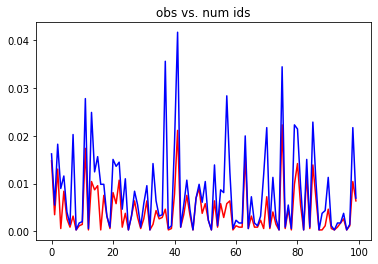

In [19]:
plt.plot(sparse_checkper_ids[:100], color='red')
plt.plot(obs_values_check[:100], color='blue')
plt.title('obs vs. num ids')

#if the two plots cannot match with each other, especially, if value in red
#is small while value in blue is big, this means that the frequency of users being
#observed is small while the number of each observation is big

In [32]:
#when normalize the data from 0-5, do further normalization is needed?

In [20]:
#split_matric
def split_1(data, ratio, tensor=False):
    train = np.zeros((len(data), len(data[0]))).tolist()
    valid = np.zeros((len(data), len(data[0]))).tolist()

    for i in range(len(data)):
        for j in range(len(data[i])):
            if data[i][j] > 0:
                if np.random.binomial(1, ratio, 1):
                    train[i][j] = data[i][j]
                else:
                    valid[i][j] = data[i][j]

    return [train, valid]

In [21]:
#add demo info
def split_2(data, ratio, tensor=False):
    train = np.zeros((len(data), len(data[0]))).tolist()
    valid = np.zeros((len(data), len(data[0]))).tolist()

    for i in range(len(data)):
        for j in range(len(data[i])):
            if j < 18:
                train[i][j] = data[i][j]
                valid[i][j] = data[i][j]
            else:    
                if data[i][j] > 0:
                    if np.random.binomial(1, ratio, 1):
                        train[i][j] = data[i][j]
                    else:
                        valid[i][j] = data[i][j]

    return [train, valid]

def split_demo(data, list_index=False):
    if list_index == False:
        data_wo_demo = np.zeros((data.shape[0],(data.shape[1]-18)))
        for i in range(data.shape[0]):
            data_wo_demo[i] = data[i][18:] 
    else:
        data_wo_demo = []
        for i in range(len(data)):
            data_wo_demo.append(data[i][18:])
    return(data_wo_demo)

In [22]:
#trnaslate group infomation
#user info
current_ids = ids_with_home[ids_with_home['newid'].isin(np.unique(obs_Seattle['newid']))]
#convert demo_group to number
def c2num(x):
    return(int(x[1:]))
#current_ids['demo_group'] = current_ids['demo_group'].apply(c2num)

current_ids = current_ids.set_index(current_ids['newid'])

demo_matrix = np.zeros((nb_ids, 18))
user_ids = list(newids_map.keys())
for k in range(len(newids_map.keys())):
    ids_index = user_ids[k]
    demo_matrix[k, current_ids.loc[ids_index]['demo_group']-1] = 1

test_matrice_scaled_reverse_demo = np.hstack([test_matrice_scaled_reverse, demo_matrix])

current_ids = current_ids.set_index(current_ids['newid'])

demo_matrix = np.zeros((nb_ids, 18))
user_ids = list(newids_map.keys())
for k in range(len(newids_map.keys())):
    ids_index = user_ids[k]
    demo_matrix[k, current_ids.loc[ids_index]['demo_group']-1] = 1

test_matrice_scaled_reverse_demo = np.hstack([test_matrice_scaled_reverse, demo_matrix])

In [23]:
#train, test = train_test_split(test_matrice_scaled, test_size=0.2, random_state=42)
#train = split(train, 0.8)
#test_matrice_scaled.shape

In [24]:
#add user index id
user_ids_index = np.array(list(newids_map.keys()))
user_ids_index = user_ids_index.reshape(user_ids_index.shape[0],1)

test_matrice_scaled_reverse = np.hstack([user_ids_index,test_matrice_scaled_reverse])
#data not scaled
test_matrice_reverse = np.hstack([user_ids_index,test_matrice_reverse])

In [25]:
#test_matrice_scaled_reverse_demo.shape

In [26]:
train_scaled, test_scaled = train_test_split(test_matrice_scaled_reverse, \
                                   test_size=0.2, random_state=42)

#method 2, not using the train, user, splitting method
#train_demo, test_demo = train_test_split(test_matrice_scaled_reverse_demo, test_size=0.2, random_state=42)
#train1, valid1 = train_test_split(train1, test_size=0.2, random_state=42)
#train_user_loct = split(train_user_loct, 0.8)

In [28]:
train, test = train_test_split(test_matrice_reverse, test_size=0.2,\
                              random_state=42)

In [27]:
#Seattle_df = obs_Seattle[['newid', 'spatial_temporal_id', 'norm_obs_5']]

In [29]:
'''Seattle_df = Seattle_df.sort_values(by='newid')
Seattle_df = Seattle_df.reset_index()
Seattle_df = Seattle_df[['newid', 'spatial_temporal_id', 'norm_obs_5']]
np.unique(Seattle_df['norm_obs_5'])
Seattle_df.head(3)

np.unique(Seattle_df['newid'])

print('# interactions on Train set: %d' % len(train))
print('# interactions on Test set: %d' % len(test))

Seattle_df_indexed = Seattle_df.set_index('newid')
Seattle_df.to_csv('Seattle_obs_1.csv')'''

Seattle_df = pd.read_csv('Seattle_obs_1.csv')
Seattle_df.head(3)

,Unnamed: 0,newid,spatial_temporal_id,norm_obs_5
0,0,32,53033008100_9_20,0.060976
1,1,32,53033008100_7_5,0.060976
2,2,32,53033008100_11_0,0.060976


### Popularity model (model for comparison)
A common (and usually hard-to-beat) baseline approach is the Popularity model. This model is not actually personalized - it simply recommends to a user the most popular items that the user has not previously consumed. As the popularity accounts for the "wisdom of the crowds", it usually provides good recommendations, generally interesting for most people.
Ps. The main objective of a recommender system is to leverage the long-tail items to the users with very specific interests, which goes far beyond this simple technique.

top 10 pop loc+time
  spatial_temporal_id  norm_obs_5
0   53033008100_16_10   25.792683
1   53033008100_17_20   25.182927
2   53033008100_16_15   24.573171
3   53033008100_17_10   24.390244
4   53033008100_16_20   24.268293
5    53033008100_17_0   24.268293
6   53033008100_16_30   24.207317
7    53033008100_17_5   24.024390
8   53033008100_16_35   23.963415
9   53033008100_16_45   23.597561
popular ct:  ['53033008100', '53033007300', '53033007200', '53033008300', '53033008200', '53033008500', '53033007100', '53033008400', '53033008001', '53033007401', '53033008002', '53033007402']
popular hr:  ['16', '17', '12', '15', '18', '11', '9', '14', '13', '8', '10', '19', '7', '22', '20', '6', '21', '5', '4', '23', '0', '1', '3', '2']


C:\Users\29700\anaconda3\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


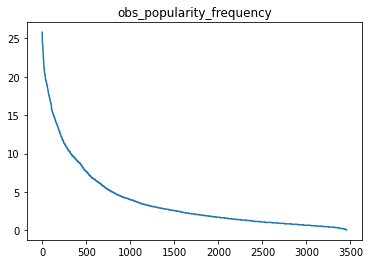

<Figure size 432x288 with 0 Axes>

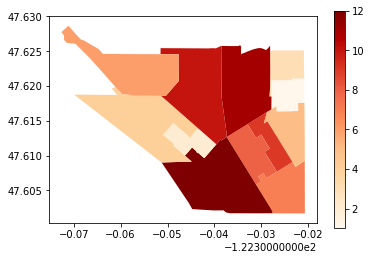

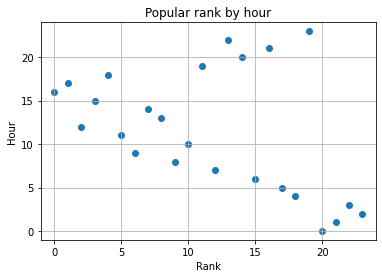

In [30]:
def check_data_popularity(Seattle_df, col4obs_rates):
    len(np.unique(Seattle_df['newid']))
    #get value for each loc,t
    loc_time_popularity = Seattle_df.groupby('spatial_temporal_id')[col4obs_rates].sum().sort_values(ascending=False).reset_index()
    print('top 10 pop loc+time')
    print(loc_time_popularity.head(10))

    plt1 = plt.figure(1)
    plt.plot(loc_time_popularity[col4obs_rates].values)
    plt.title('obs_popularity_frequency')

    #check data in Seattle area
    census_t = []
    hours = []
    for i in loc_time_popularity['spatial_temporal_id'].values:
        cs_time = i.split('_')
        if cs_time[0] not in census_t:
            census_t.append(cs_time[0])
        if cs_time[1] not in hours:
            hours.append(cs_time[1])
    print('popular ct: ', census_t)
    print('popular hr: ', hours)

    #observation popularity
    Seattle_map = CensusTract[CensusTract['GEOID10'].isin(census_t)]
    a = list(Seattle_map['GEOID10'].values)
    vals = []
    ranks_val = []
    num_cts = len(census_t)
    val = num_cts
    for i in range(num_cts):
        vals.append(val)
        val -= 1

    for i in range(num_cts):
        idx = census_t.index(a[i])
        ranks_val.append(vals[idx])
    Seattle_map['pop_rank'] = ranks_val
    
    plttest = plt.figure(3)
    fig, ax = plt.subplots(1, 1)
    Seattle_map.plot(column='pop_rank', ax=ax, legend=True, cmap='OrRd')

    #temporal popularity
    plt2 = plt.figure(2)
    a = 0
    for i in hours:
        hours[a] = int(i)
        a = a+1
    rank_x = list(range(0,24))
    
    plt.scatter(rank_x,hours)
    plt.xlim(-1, 24)
    plt.ylim(-1, 24)
    plt.xlabel('Rank')
    plt.ylabel('Hour')
    plt.grid(True)
    plt.title('Popular rank by hour')
    
check_data_popularity(Seattle_df, 'norm_obs_5')

### collaborative filtering 

One important thing to keep in mind is that in an approach based purely on collaborative filtering, the similarity is not calculated using factors like the age of users, genre of the movie, or any other data about users or items. It is calculated only on the basis of the rating (explicit or implicit) a user gives to an item. For example, two users can be considered similar if they give the same ratings to ten movies despite there being a big difference in their age.

Source: https://realpython.com/build-recommendation-engine-collaborative-filtering/



In [34]:
#!pip install pymf3
#!pip install surprise
#MF package discussion
#https://techairesearch.com/overview-of-matrix-factorization-techniques-using-python/
#NMF package
#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.NMF.html

In [46]:
from scipy.sparse import csr_matrix
from scipy.sparse.linalg import svds
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error as mae
from datetime import datetime
import time
from sklearn.decomposition import NMF

In [36]:
#example of NMF
X = np.array([[1, 1], [2, 1], [3, 1.2], [4, 1], [5, 0.8], [6, 1]])
model = NMF(n_components=2, init='random', random_state=0)
W = model.fit_transform(X)
H = model.components_

In [71]:
print(X.shape)
print(np.matmul(W, H).shape)
print(W.shape)
print(H.shape)

(6, 2)
(6, 2)
(6, 2)
(2, 2)


In [394]:
help(cal_rmse)

Help on function cal_rmse in module __main__:

cal_rmse(test_dt, pred_dt, single_id=False, withids=True)



In [32]:
#convert data with estimated shortest path info
file_path = 'G:/My Drive/2021/Bias/census_tract_process/crossed_routes.csv'
crossed_rt = pd.read_csv(file_path)

In [44]:
#os.listdir('G:/My Drive/2021/Bias/census_tract_process/')

In [39]:
np.unique(test_matrice_reverse[0])
#newids_map
#locts_map

array([ 0.,  1.,  2.,  3., 32.])

In [34]:
obs_Seattle.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id,norm_obs,norm_obs_5
211948,53033007100,0,0,7528,1,53033007100_0_0,0.012195,0.060976
211949,53033007100,0,0,36180,2,53033007100_0_0,0.024390,0.121951
211950,53033007100,0,0,54917,1,53033007100_0_0,0.012195,0.060976


In [40]:
crossed_rt['start_time'].values[0]

1491399907

In [33]:
get_hr = lambda x: datetime.fromtimestamp(x).hour
get_minute = lambda x: datetime.fromtimestamp(x).minute
crossed_rt['s_hr'] = crossed_rt['start_time'].apply(get_hr).values
crossed_rt['e_hr'] = crossed_rt['end_time'].apply(get_hr).values
crossed_rt['s_min'] = crossed_rt['start_time'].apply(get_minute).values
crossed_rt['e_min'] = crossed_rt['end_time'].apply(get_minute).values

to5min = lambda x: int(x/5)*5
crossed_rt['s_minut_5'] = crossed_rt['s_min'].apply(to5min)
crossed_rt['e_minut_5'] = crossed_rt['e_min'].apply(to5min)

In [34]:
get_timeloct_id = lambda x: str(x)+'_'
remove_last_symbol = lambda x: x[:-1]
crossed_rt['ori_st'] = (crossed_rt['new_ori'].apply(get_timeloct_id)+\
crossed_rt['s_hr'].apply(get_timeloct_id)+\
crossed_rt['s_minut_5'].apply(get_timeloct_id)).apply(remove_last_symbol)

crossed_rt['dest_st'] = (crossed_rt['new_dest'].apply(get_timeloct_id)+\
crossed_rt['e_hr'].apply(get_timeloct_id)+\
crossed_rt['e_minut_5'].apply(get_timeloct_id)).apply(remove_last_symbol)

crossed_rt = crossed_rt[crossed_rt.columns[5:]]
crossed_rt.columns

Index(['newid', 'ori_geo', 'dest_geo', 'start_time', 'end_time', 'time_diff',
       'od_euqal', 'new_ori', 'new_dest', 'crossed_ct', 'ct_check',
       'no_crossed_ct', 'travel_time', 's_hr', 'e_hr', 's_min', 'e_min',
       's_minut_5', 'e_minut_5', 'ori_st', 'dest_st'],
      dtype='object')

In [46]:
def CF(test_dt, num_of_latent_factors, scaled):
    #use matrice without the id index
    test_sparse_matrix = csr_matrix(test_dt[:, 1:])
    #The number of factors to factor the user-item matrix.
    #Performs matrix factorization of the original user item matrix
    U, sigma, Vt = svds(test_sparse_matrix, k = num_of_latent_factors)
    sigma = np.diag(sigma)
    predicted = np.dot(np.dot(U, sigma), Vt)
    if scaled==True:
        predicted_norm = ((predicted - predicted.min())/(predicted.max()-predicted.min()))*5
        return(predicted_norm)
    else:
        return(predicted)
    
def cal_rmse(test_dt, pred_dt, single_id = False, withids=True):
    if single_id == True:
        if withids == False:
            return(mean_squared_error(test_dt, pred_dt, squared=False))
        else:
            return(mean_squared_error(test_dt[1:], pred_dt, squared=False))
    elif withids == False:
        return(mean_squared_error(test_dt, pred_dt, squared=False))
    else:
        return(mean_squared_error(test_dt[:, 1:], pred_dt, squared=False))
    
def cal_mae(test_dt, pred_dt, single_id = False):
    if single_id == True:
        return(mae(test_dt[1:], pred_dt))
    else:
        return(mae(test_dt[:, 1:], pred_dt))

def cal_r2(test_dt, pred_dt, single_id = False):
    if single_id == True:
        return(r2_score(test_dt[1:], pred_dt))
    else:
        return(r2_score(test_dt[:, 1:], pred_dt))
    

def get_best_svd(test_matrix, scaled=True):
    rmse_result = []
    #test_lf=test latent factors
    test_lf = list(range(2, 101))
    best_lf_rmse = 0
    test_rmse = 1
    best_pred_dt_rmse = 0
    rmse_dict = {}
    for num_lf in test_lf:
        pred_dt = CF(test_matrix, num_lf, scaled)
        rmse = cal_rmse(test_matrix, pred_dt)
        rmse_dict[num_lf] = rmse
        if rmse < test_rmse:
            test_rmse = rmse
            best_lf_rmse = num_lf
            best_pred_dt_rmse = pred_dt
            
    #rmse_result.append(rmse)
    print('based on rmse', test_rmse, best_lf_rmse)
    return(best_pred_dt_rmse, best_lf_rmse, rmse_dict)

def NMF_est(test_matrix, num_lf, reg_l, a):
    #use nndsvd for sparseness
    model = NMF(n_components=num_lf, init='nndsvd', max_iter=1000, l1_ratio=reg_l, alpha=a)
    W = model.fit_transform(test_matrix[:, 1:])
    H = model.components_
    return(np.matmul(W, H))      

#example of NMF
def NMF_est_with_zeros(test_matrix, num_lf, reg_l, a, Zero_index):
    #start = time.time()
    model = NMF(n_components=num_lf, init='nndsvd', max_iter=5000, l1_ratio=reg_l, alpha=a)
    W = model.fit_transform(test_matrix[:, 1:])
    H = model.components_
    WH = np.dot(W, H)
    Zero_est = np.multiply(WH, Zero_index)
    Zeros = np.zeros(WH.shape) 
    Zeros_diff = Zero_est - Zeros
    zero_val = np.linalg.norm(Zeros_diff)
    return(WH, zero_val)
    
def get_best_NMF(test_matrix):
    #test
    test_lf = list(range(2, 19))
    l1 = np.round(0.05*np.array(list(range(20))),2)
    alpha_para = np.round(0.05*np.array(list(range(20))),2)
    best_lf_rmse = 0
    best_lf_mae = 0
    test_rmse = 1
    test_mae = 1
    
    best_pred_dt_rmse = 0
    best_pred_dt_mae = 0
    best_regl_rmse = 0
    best_regl_mae = 0
    
    best_alpha_rmse = 0
    best_alpha_mae = 0
    rmse_dict = {}
    mae_dict = {}
    for num_lf in test_lf:
        for reg_l in l1:
            for a in alpha_para:
                pred_dt = NMF_est(test_matrix, num_lf, reg_l, a)
                rmse = cal_rmse(test_matrix, pred_dt)
                rmse_dict['k='+str(num_lf)+', lambda='+str(reg_l)+', alpha='+str(a)] = round(rmse,9)
                mae = cal_mae(test_matrix, pred_dt)
                mae_dict['k='+str(num_lf)+', lambda='+str(reg_l)+', alpha='+str(a)] = round(mae,9)
                if rmse < test_rmse:
                    test_rmse = rmse
                    best_lf_rmse = num_lf
                    best_pred_dt_rmse = pred_dt
                    best_regl_rmse = reg_l
                    best_alpha_rmse = a
                if mae < test_mae:
                    test_mae = mae
                    best_lf_mae = num_lf
                    best_regl_mae = reg_l
                    best_pred_dt_mae = pred_dt  
                    best_alpha_mae = a
            
        #rmse_result.append(rmse)
    print('based on rmse: '+'best val='+str(round(test_rmse,9))+', best k='+str(best_lf_rmse)+', best lambda='+str(best_regl_rmse)+', best alpha='+str(best_alpha_rmse))
    print('based on mae: '+'best val='+str(round(test_mae,9))+', best k='+str(best_lf_mae)+', best lambda='+str(best_regl_mae)+', best alpha='+str(best_alpha_mae))
    return(best_pred_dt_rmse, best_pred_dt_mae, rmse_dict, mae_dict)

def get_best_NMFwzero(test_matrix, Zero_index):
    #test
    test_lf = list(range(2, 19))
    l1 = np.round(0.1*np.array(list(range(10))),2)
    alpha_para = np.round(0.1*np.array(list(range(10))),2)
    zero_w = [0.1, 0.3, 0.5]
    #best_lf_rmse = 0
    #test_rmse = 100
    #best_pred_dt_rmse = 0
    #best_regl_rmse = 0
    #best_alpha_rmse = 0
    rmse_dict = {}
    zero_score = {}
    rmse_w0 = {}
    
    #best_lf_mae = 0
    #test_mae = 100
    #best_pred_dt_mae = 0
    #best_regl_mae = 0
    #best_alpha_mae = 0
    mae_dict = {}
    mae_w0 = {}
    
    for num_lf in test_lf:
        for reg_l in l1:
            for a in alpha_para:
                dict_keys = 'k='+str(num_lf)+', lambda='+str(reg_l)+', alpha='+str(a)
                start = time.time()
                pred_dt, zero_constriant = NMF_est_with_zeros(test_matrix, num_lf, reg_l, a, Zero_index)
                end = time.time()
                print(dict_keys)
                print(f'running time={end-start}')

                rmse_dict[dict_keys]= round(cal_rmse(test_matrix, pred_dt),9)
                mae_dict[dict_keys] = round(cal_mae(test_matrix, pred_dt),9)
                for w0 in zero_w:
                    dict_keys_0 = dict_keys+', w0='+str(w0)
                    zero_score[dict_keys_0] = w0*zero_constriant
                    rmse_w0[dict_keys_0] = rmse_dict[dict_keys]+zero_score[dict_keys_0]
                    mae_w0[dict_keys_0] = mae_dict[dict_keys]+zero_score[dict_keys_0]
    #            if rmse < test_rmse:
    #                test_rmse = rmse
    #                best_lf_rmse = num_lf
    #                best_pred_dt_rmse = pred_dt
    #                best_regl_rmse = reg_l
    #                best_alpha_rmse = a
    #            if mae < test_mae:
    #                test_mae = mae
    #                best_lf_mae = num_lf
    #                best_regl_mae = reg_l
    #                best_pred_dt_mae = pred_dt
    #                best_alpha_mae = a
            
        #rmse_result.append(rmse)
    #print('based on rmse: '+'best val='+str(round(test_rmse,9))+', best k='+str(best_lf_rmse)+', best lambda='+str(best_regl_rmse)+', best alpha='+str(best_alpha_rmse))
    #print('based on mae: '+'best val='+str(round(test_mae,9))+', best k='+str(best_lf_mae)+', best lambda='+str(best_regl_mae)+', best alpha='+str(best_alpha_mae))
    return(rmse_dict, zero_score, mae_dict, rmse_w0, mae_w0)



In [38]:
#predsvd_rmse_s, lfsvd_rmse_s, rmse_svd_s = get_best_svd(test_matrice_scaled_reverse, False)
predsvd_rmse, lfsvd_rmse, rmse_svd = get_best_svd(test_matrice_reverse, False)

based on rmse 0.12927862784395378 100


In [ ]:
nmf_rmse_dict, nmf_zero_score, nmf_mae_dict, nmf_rmse_w0, nmf_mae_w0 = get_best_NMFwzero(test_matrice_reverse, Zero_index)

In [85]:
def zero_dict_plot(selected_dict, weight_index, intervals, k1, kn, x_labels, y_labels, titles):
    selected_keys = []
    for i in selected_dict:
        if weight_index in i:
            selected_keys.append(i)
    zero_dict = {}
    for i in selected_keys:
        zero_dict[i] = selected_dict[i]
    
    dict_plot(zero_dict, intervals, k1, kn, x_labels, y_labels, titles)
    
def dict_plot(selected_dict, intervals, k1, kn, x_labels, y_labels, titles):
    fig, ax = plt.subplots(figsize=(15, 6))
       
    ax.set_xlim(0, len(selected_dict))            
    ax.set_ylim(min(selected_dict.values())-0.005,\
                max(selected_dict.values())+0.005)
    ax.plot(list(selected_dict.values()))

    x_ticks = np.arange(0, len(selected_dict), intervals)
    ax.set_xticks(x_ticks)
    ax.set_xticklabels(list(range(k1, kn)))
    ax.grid()
    plt.xlabel(x_labels)
    plt.ylabel(y_labels)
    plt.title(titles)
    plt.show()
                

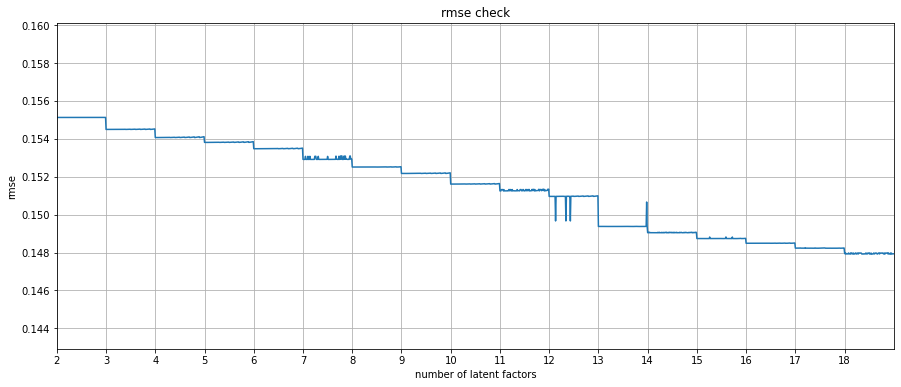

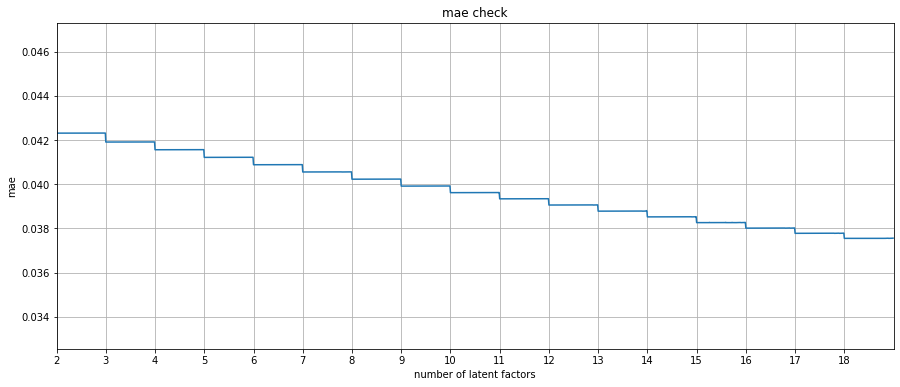

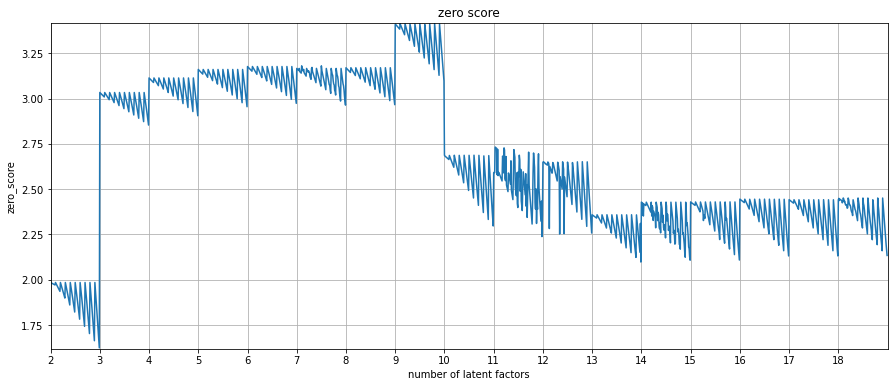

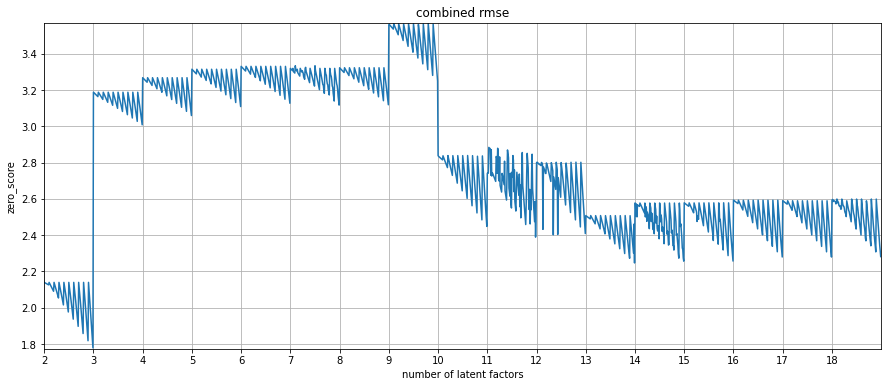

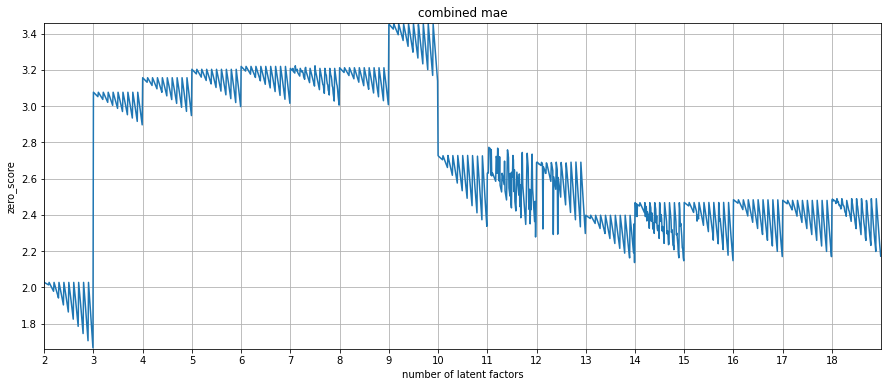

In [88]:
dict_plot(nmf_rmse_dict, 100, 2, 19, 'number of latent factors', 'rmse', 'rmse check')
dict_plot(nmf_mae_dict, 100, 2, 19, 'number of latent factors', 'mae', 'mae check')
zero_dict_plot(zero_dict, 'w0=0.1', 100, 2, 19, 'number of latent factors', 'zero_score', 'zero score')
zero_dict_plot(nmf_rmse_w0, 'w0=0.1', 100, 2, 19, 'number of latent factors', 'zero_score', 'combined rmse')
zero_dict_plot(nmf_mae_w0, 'w0=0.1', 100, 2, 19, 'number of latent factors', 'zero_score', 'combined mae')

In [ ]:
test_matrix = test_matrice_reverse
test_lf = list(range(15, 19))
l1 = np.round(0.05*np.array(list(range(6, 11))),2)
alpha_para = np.round(0.05*np.array(list(range(6, 11))),2)

best_lf_rmse = 0
test_rmse = 100
best_pred_dt_rmse = 0
best_regl_rmse = 0
best_alpha_rmse = 0
rmse_dict = {}

best_lf_mae = 0
test_mae = 100
best_pred_dt_mae = 0
best_regl_mae = 0
best_alpha_mae = 0
mae_dict = {}

for num_lf in test_lf:
    for reg_l in l1:
        for a in alpha_para:
            start = time.time()
            pred_dt, zero_constriant = NMF_est_with_zeros(test_matrix, num_lf, reg_l, a, Zero_index)
            end = time.time()
            print('k='+str(num_lf)+', lambda='+str(reg_l)+', alpha='+str(a))
            print(f'running time={end-start}')
            rmse = cal_rmse(test_matrix, pred_dt)+zero_w*zero_constriant
            rmse_dict['k='+str(num_lf)+', lambda='+str(reg_l)+', alpha='+str(a)] = round(rmse,9)
            maes = cal_mae(test_matrix, pred_dt)+zero_w*zero_constriant
            mae_dict['k='+str(num_lf)+', lambda='+str(reg_l)+', alpha='+str(a)] = round(maes,9)
            if rmse < test_rmse:
                test_rmse = rmse
                best_lf_rmse = num_lf
                best_pred_dt_rmse = pred_dt
                best_regl_rmse = reg_l
                best_alpha_rmse = a
            if maes < test_mae:
                test_mae = maes
                best_lf_mae = num_lf
                best_regl_mae = reg_l
                best_pred_dt_mae = pred_dt
                best_alpha_mae = a

    #rmse_result.append(rmse)
print('based on rmse: '+'best val='+str(round(test_rmse,9))+', best k='+str(best_lf_rmse)+', best lambda='+str(best_regl_rmse)+', best alpha='+str(best_alpha_rmse))
print('based on mae: '+'best val='+str(round(test_mae,9))+', best k='+str(best_lf_mae)+', best lambda='+str(best_regl_mae)+', best alpha='+str(best_alpha_mae))

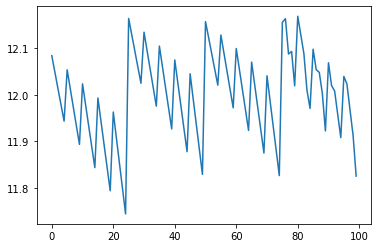

In [50]:
plt.plot(rmse_dict.values())

In [ ]:
os.chdir('G:/My Drive/2021/Bias/census_tract_process/')
pd.DataFrame.from_dict(prednmf_rmse, orient='index').to_csv('rmse_nmf_walpha.csv')
pd.DataFrame.from_dict(prednmf_mae, orient='index').to_csv('mae_nmf_walpha.csv')

In [63]:
#convert dict to dataframe
os.chdir('G:/My Drive/2021/Bias/census_tract_process/')
pd.DataFrame.from_dict(rmse_nmf, orient='index').to_csv('rmse_nmfwalpha.csv')
pd.DataFrame.from_dict(mae_nmf, orient='index').to_csv('mae_nmfwalpha.csv')

In [69]:
float('k=19'.split('=')[1])

19.0

In [46]:
#check rmse
os.chdir('G:/My Drive/2021/Bias/census_tract_process/')
get_num = lambda x: x.split('=')[1]
rmse_nmf_dt = pd.read_csv('rmse_nmfwalpha.csv')
rmse_nmf_dt['k'] = rmse_nmf_dt['k'].apply(get_num)
rmse_nmf_dt['k'] = rmse_nmf_dt['k'].astype('int')
rmse_nmf_dt['lambda'] = rmse_nmf_dt['lambda'].apply(get_num)
rmse_nmf_dt['lambda'] = rmse_nmf_dt['lambda'].astype('float')
rmse_nmf_dt['alpha'] = rmse_nmf_dt['alpha'].apply(get_num)
rmse_nmf_dt['alpha'] = rmse_nmf_dt['alpha'].astype('float')
rmse_nmf_dt.sort_values(by=['rmse']).head(10)

,k,lambda,alpha,rmse
1775,19,0.35,0.5,0.147641
1796,19,0.45,0.6,0.147641
1757,19,0.25,0.7,0.147642
1754,19,0.25,0.4,0.147642
1769,19,0.30,0.9,0.147643
1798,19,0.45,0.8,0.147643
1735,19,0.15,0.5,0.147644
1733,19,0.15,0.3,0.147644
1781,19,0.40,0.1,0.147644
1742,19,0.20,0.2,0.147644


In [47]:
from pylab import *
from matplotlib.ticker import MultipleLocator, FormatStrFormatter


<ipython-input-90-cc492b1e1144>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(list(range(1, 20)))


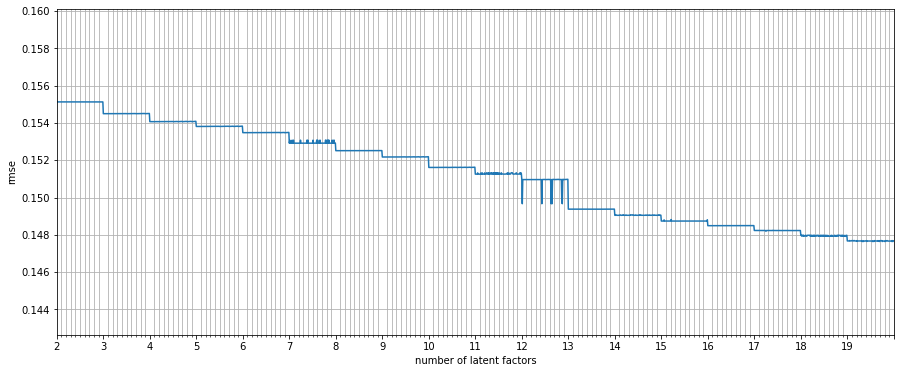

In [90]:

fig, ax = plt.subplots(figsize=(15, 6))

ax.set_xlim(0, len(rmse_nmf))
ax.set_ylim(min(rmse_nmf.values())-0.005, max(rmse_nmf.values())+0.005)
ax.plot(list(rmse_nmf.values()))

ax.xaxis.set_major_locator(MultipleLocator(100))
ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
ax.xaxis.set_minor_locator(MultipleLocator(10))

ax.xaxis.grid(True,'minor')
ax.xaxis.grid(True,'major')
ax.set_xticklabels(list(range(1, 20)))
ax.grid()
plt.xlabel('number of latent factors')
plt.ylabel('rmse')

plt.show()

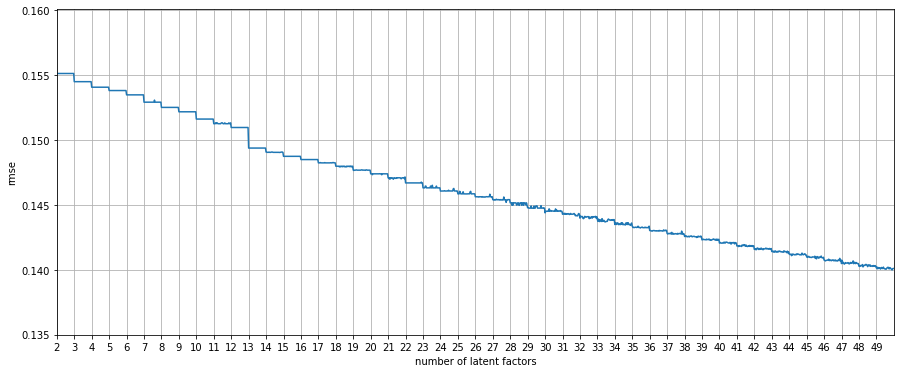

In [550]:
fig, ax = plt.subplots(figsize=(15, 6))

ax.set_xlim(0, len(rmse_nmf))
ax.set_ylim(min(rmse_nmf.values())-0.005, max(rmse_nmf.values())+0.005)
ax.plot(list(rmse_nmf.values()))
x_ticks = np.arange(0, len(rmse_nmf), 30)
ax.set_xticks(x_ticks)
ax.set_xticklabels(list(range(2, 50)))
ax.grid()
plt.xlabel('number of latent factors')
plt.ylabel('rmse')

plt.show()

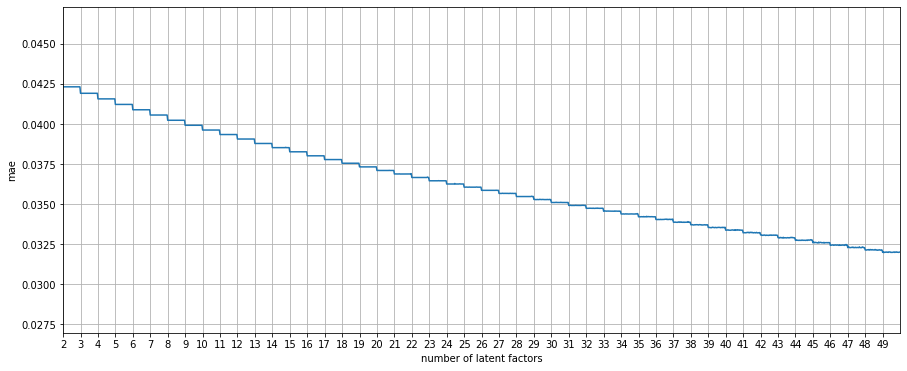

In [549]:
fig, ax = plt.subplots(figsize=(15, 6))

ax.set_xlim(0, len(mae_nmf))
ax.set_ylim(min(mae_nmf.values())-0.005, max(mae_nmf.values())+0.005)
ax.plot(list(mae_nmf.values()))
x_ticks = np.arange(0, len(mae_nmf), 30)
ax.set_xticks(x_ticks)
ax.set_xticklabels(list(range(2, 50)))
ax.grid()
plt.xlabel('number of latent factors')
plt.ylabel('mae')

plt.show()

In [492]:
#prednmf_rmse_s, lfnmf_rmse_s, rmse_nmf_s = get_best_NMF(test_matrice_scaled_reverse, 6)
prednmf_rmse, prednmf_mae, rmse_nmf, mae_nmf = get_best_NMF(test_matrice_reverse, 6)

based on rmse: best val=0.152391833 best k=9best lambda=0.0
based on mae: best val=0.039963713 best k=9best lambda=0.0


### post data processing

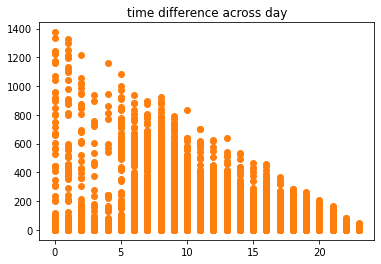

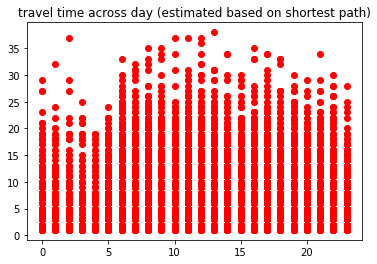

In [37]:
#get neighborhood census tract info
os.chdir('G:/My Drive/2021/Bias/census_tract_process')
pathfile = 'G:/My Drive/2021/Bias/census_tract_process/'
Seattle_ct = pd.read_csv(pathfile+'Seattle_ct.csv')
Seattle_ct.columns
Seattle_ct = Seattle_ct[['GEOID10','Nb_interse', 'nb_count', 'nb_touch', 'nb_bf_5', 'nb_bf10', \
                         'nb_bf100','nb_bf1mi','Area', 'Distance m','Distance_1', 'field_1', 'index']]

#check time difference change for each individual
newids = list(newids_map.keys())
a = 0
index = 0
for ids in newids:
    if a <= index:
        test_dt = crossed_rt[['time_diff', 'travel_time','s_hr','e_hr','od_euqal']][crossed_rt['newid'] == ids]
        test_dt = test_dt.sort_values(by=['time_diff'])
        plt.figure(a)
        x = list(test_dt['s_hr'].values)
        y = list(test_dt['time_diff'].values)
        plt.plot(x,y,'o')
        plt.title('time difference between each time segement for ids = '+str(ids))
        a += 1
        
test_dt = crossed_rt[['s_hr', 'time_diff', 'travel_time']][crossed_rt['od_euqal']==0].sort_values(by=['s_hr', 'time_diff'])
plt.figure(0)
plt.plot(list(test_dt['s_hr'].values), list(test_dt['time_diff'].values),'o')
plt.title('time difference across day')
plt.figure(1)
plt.plot(list(test_dt['s_hr'].values), list(test_dt['travel_time'].values),'ro')
plt.title('travel time across day (estimated based on shortest path)')

#keep previous census tract
ori_geo = crossed_rt['ori_geo'].values
dest_geo = crossed_rt['dest_geo'].values
no_crossed_ct = crossed_rt['no_crossed_ct'].values
no_crossed_cts = []
for i in range(len(ori_geo)):
    no_crossed = no_crossed_ct[i].strip('[]').split(', ')
    if str(ori_geo[i]) in no_crossed:
        no_crossed.remove(str(ori_geo[i]))
    if str(dest_geo[i]) in no_crossed:
        no_crossed.remove(str(dest_geo[i]))
    no_crossed_cts.append(no_crossed)

del(ori_geo)
del(dest_geo)
del(no_crossed_ct)

crossed_rt['no_crossedcts'] = no_crossed_cts
crossed_rt = crossed_rt.sort_values(by=['newid','time_diff','s_hr'])

In [38]:
#Functions
#for the ods at the same location
#the other location at the same time should be 0
#time_diff <= 10 min

#for the ods at different location
#the other location which not belongs to the route or neatby od should be 0
#time_diff <= 20 min

#get 0 value

#besides,if appears in one place already, the location will not appear in the other census tract
def extract_od(dt, sameod = True):
    if sameod == True:
        test_dt = dt[(dt['od_euqal']==1) & (dt['time_diff']<=10)]
    else:
        test_dt = dt[(dt['od_euqal']==0) & (dt['time_diff']<=20)]
    return(test_dt)

def convert2stid(hr, minut_5, census):
    return(str(census)+'_'+str(hr)+'_'+str(minut_5))

def process_dt4convert(shr, ehr, smin, emin):
    if ehr-shr<0:
        print('data error')
        return(None)
    if ehr-shr == 0:
        if emin-smin == 0:
            return([shr], [smin])
        elif emin-smin <0:
            print('data error')
            return(None)
        else:
            interval = int((emin-smin)/5)
            min_lst = [smin]
            hr_lst = [shr]
            if interval > 1:
                for i in range(interval):
                    min_lst.append(int(smin+5*(i+1)))
                    hr_lst.append(shr)
            else:
                min_lst.append(emin)
                hr_lst.append(shr)
            return(hr_lst, min_lst)
    else:
        if emin+60-smin == 0:
            return([shr], [smin]) 
        else:
            interval = int((emin+60-smin)/5)    
            hr_lst = [shr]
            min_lst = [smin]
            if interval > 1:
                for i in range(interval):
                    if smin+(i+1)*5 >= 60:
                        min_lst.append(smin+(i+1)*5-60)
                        hr_lst.append(ehr)
                    else:
                        min_lst.append(smin+(i+1)*5)
                        hr_lst.append(shr)
            else:             
                min_lst.append(emin)
                hr_lst.append(ehr)
            return(hr_lst, min_lst) 
        
def add_zero_loc(shr, ehr, s5min, e5min, nocrossedcts, zero_loclst):
    for i in range(len(shr)):
        hr, minut = process_dt4convert(shr[i], ehr[i], s5min[i], e5min[i])
        for j in nocrossedcts[i]:
            for k in range(len(hr)):
                loc_timeids = convert2stid(hr[k], minut[k], j)
                if loc_timeids not in zero_loclst:
                    zero_loclst.append(loc_timeids)
    return(zero_loclst)

def get_nocrossed_stids(dt, zero_loc_time):
    dt = dt.sort_values(by=['newid'])
    newids = np.unique(dt['newid'])
    
    for ids in newids:
        if ids not in zero_loc_time:
            zero_loc_time[ids] = []
        #get start and end hr
        s_hr = list(dt['s_hr'][dt['newid']==ids].values)
        e_hr = list(dt['e_hr'][dt['newid']==ids].values)
        s_5min = list(dt['s_minut_5'][dt['newid']==ids].values)
        e_5min = list(dt['e_minut_5'][dt['newid']==ids].values)
        no_crossed_cts = list(dt['no_crossedcts'][dt['newid']==ids].values)
        
        zero_loc_time[ids] = add_zero_loc(s_hr, e_hr, s_5min, e_5min, no_crossed_cts, zero_loc_time[ids])
    return(zero_loc_time)

def getzero_info(dt):
    zero_loc_time = {}
    dt1 = extract_od(dt, sameod = True)
    dt2 = extract_od(dt, sameod = False)
    zero_loc_time = get_nocrossed_stids(dt1, zero_loc_time)
    zero_loc_time = get_nocrossed_stids(dt2, zero_loc_time)
    return(zero_loc_time)

def get_revised_matrix(pred_matrix, zero_loc_time):
    for ids in zero_loc_time:
        for loct_time in zero_loc_time[ids]:
            pred_matrix[newids_map[ids]][locts_map[loct_time]] = 0
    return(pred_matrix)

def convert_missingids(time_lst, ids, time_spatial_ids):
    for t in time_lst:
        hr = (Seattle_latlon['hr'][(Seattle_latlon['newid']==ids) & (Seattle_latlon['timestamp']==t)]).values[0]
        minut = (Seattle_latlon['minut_5'][(Seattle_latlon['newid']==ids) & (Seattle_latlon['timestamp']==t)]).values[0]
        geoid = (Seattle_latlon['geoid'][(Seattle_latlon['newid']==ids) & (Seattle_latlon['timestamp']==t)]).values[0]
        newgeo = (Seattle_latlon['new_geos'][(Seattle_latlon['newid']==ids) & (Seattle_latlon['timestamp']==t)]).values[0]
        geos = list(np.unique([geoid, newgeo]))
        if 0 in geos:
            geos.remove(0)
        #get no observed census_t
        diff_ct = list(set(census_t) ^ set(geos))
        for geoid in diff_ct:
            time_spatial_id = convert2stid(hr, minut, geoid)
            if time_spatial_id not in time_spatial_ids:
                time_spatial_ids.append(time_spatial_id)
    return(time_spatial_ids)

#we found missing valeues after we processing the data
#latlon_path = 'G:/My Drive/2021/Bias/data-processing/'
Seattle_latlon = pd.read_csv('Seattle_latlon.csv', index_col=0)

selected_colname = list(Seattle_latlon.columns)
selected_colname.remove('Unnamed: 0.1')
Seattle_latlon = Seattle_latlon[selected_colname]
Seattle_latlon['minut_5'] = (Seattle_latlon['minut'].apply(to5min)).values
#through the checking, it is found there are individuals missing after the shortest path algorithm
ids_in_dt = list(np.unique(crossed_rt['newid']))
diff = set(newids)^set(ids_in_dt)

print('# of ids with shortest path: ', len(ids_in_dt))
print('# of identified ids: ', len(newids_map.keys()))
print('# of missing ids without shortest path: ', len(diff))

#check the missed data in detail

crossed_rt = crossed_rt.sort_values(by=['newid','start_time'])
crossed_rt.reset_index(inplace=True)
crossed_rt.head(3)

newids = np.unique(crossed_rt['newid'])
kept_data_start = {}
kept_data_end = {}
for ids in newids:
    kept_data_start[ids] = list(crossed_rt['start_time'][crossed_rt['newid']==ids].values)
    kept_data_end[ids] = list(crossed_rt['end_time'][crossed_rt['newid']==ids].values)
    
#get missing trips
#missing ids with missing data
newids = np.unique(crossed_rt['newid'])
newids_all = list(newids_map.keys())
missing_ids = {}
for ids in newids_all:
    missing_ids[ids] = []
    time_data = list(Seattle_latlon['timestamp'][Seattle_latlon['newid']==ids].values)
    if ids not in newids:
        missing_ids[ids] = time_data
    else:    
        for time in time_data:
            if time not in kept_data_end[ids] and time not in kept_data_start[ids]:
                missing_ids[ids].append(time)
                
missing_pairs = {}
for ids in newids:
    missing_pairs[ids] = {'o':[],'d':[]}
    cur_odpairs = crossed_rt[['start_time', 'end_time']][crossed_rt['newid']==ids].values
    time_data = list(Seattle_latlon['timestamp'][Seattle_latlon['newid']==ids].values)
    for i in range(len(time_data)):
        if i < len(time_data)-1:
            od_pairs = []
            od_pairs.append(time_data[i]) 
            od_pairs.append(time_data[i+1])
            if od_pairs not in cur_odpairs:
                missing_pairs[ids]['o'].append(od_pairs[0])
                missing_pairs[ids]['d'].append(od_pairs[1]) 
                
                
print('worst data accuracy: ', np.max(Seattle_latlon['accuracy']))

census_t = list(np.unique(Seattle_latlon['GEOID10']))

zero_loc_time = {}
for ids in missing_ids:
    if ids not in zero_loc_time:
        zero_loc_time[ids] = []
    zero_loc_time[ids] = convert_missingids(missing_ids[ids], ids, zero_loc_time[ids])
    
# create the zero index matrix
Zero_index = np.zeros(test_matrice_reverse[:, 1:].shape)
for row in zero_loc_time:
    for col in zero_loc_time[row]:
        Zero_index[newids_map[row]][locts_map[col]] = 1

# of ids with shortest path:  5955
# of identified ids:  7767
# of missing ids without shortest path:  1812
worst data accuracy:  200


### Adding constriants into the method

In [77]:
#packages
from scipy.optimize import minimize
import time

In [104]:
alpha*l1_ratio*n_features*np.linalg(W, 1)

In [ ]:
import scipy.sparse
from scipy.stats import entropy
from sys import exit
from .nmfbase import NMFBase

In [ ]:
class NMF(NMFBase):
    def update_h(self):

        XtW = np.dot(self.W.T, self.X)
        HWtW = np.dot(self.W.T.dot(self.W), self.H ) + 2**-8
        self.H *= XtW
        self.H /= HWtW

    def update_w(self):
        XH = self.X.dot(self.H.T)
        WHtH = self.W.dot(self.H.dot(self.H.T)) + 2**-8
        self.W *= XH
        self.W /= WHtH

In [ ]:
class NMFBase():
    def __init__(self, X, rank=10, **kwargs):
        self.X = X
        self._rank = rank
        self.X_dim, self._samples = self.X.shape

    def frobenius_norm(self):
        """ Euclidean error between X and W*H """
        if hasattr(self,'H') and hasattr(self,'W'):
            error = np.linalg.norm(self.X - np.dot(self.W, self.H))
        else:
            error = None

        return error

    def kl_divergence(self):
        """ KL Divergence between X and W*H """
        if hasattr(self,'H') and hasattr(self,'W'):
            V = np.dot(self.W, self.H)
            error = entropy(self.X, V).sum()
        else:
            error = None

        return error

    def initialize_w(self):
        """ Initalize W to random values [0,1]."""
        self.W = np.random.random((self.X_dim, self._rank))

    def initialize_h(self):
        """ Initalize H to random values [0,1]."""
        self.H = np.random.random((self._rank, self._samples))

    def update_h(self):
        "Override in subclasses"
        pass

    def update_w(self):
        "Override in subclasses"
        pass


    def check_non_negativity(self):
        if self.X.min()<0:
            return 0
        else:
            return 1

    def compute_factors(self, max_iter=100):
        if self.check_non_negativity():
            pass
        else:
            print("The given matrix contains negative values")
            exit()
        if not hasattr(self,'W'):
            self.initialize_w()
        if not hasattr(self,'H'):
            self.initialize_h()
        self.frob_error = np.zeros(max_iter)
        for i in range(max_iter):
            self.update_w()
            self.update_h()
            self.frob_error[i] = self.frobenius_norm()

In [97]:
#codings
#global variable
#Zero_index, A
#Local variable
#alpha, l1_ratio, W (when H is x var), H (when W is x var), k
def add_zero_constriant(WH):
    Zero_est = np.multiply(WH, Zero_index)
    Zeros = np.zeros(WH.shape) 
    Zeros_diff = Zero_est - Zeros
    return(np.linalg.norm(Zeros_diff))

def add_constriant(W, H, alpha, l1_ratio):
    n_features = W.shape[0]
    n_samples = H.shape[0]
    constraint = alpha*l1_ratio*n_features*np.linalg.norm(W.flatten(order="F"), 1)
    constraint = constraint+alpha*l1_ratio*n_samples*np.linalg.norm(H.flatten(order="F"), 1)
    constraint = constraint+alpha*(1-l1_ratio)*n_features*np.linalg.norm(W)
    constraint = constraint+alpha*(1-l1_ratio)*n_samples*np.linalg.norm(H)
    return(constraint)

def get_main_est(x, *args):
    W = x[:args[0]].reshape(args[1], args[2])
    H = x[args[0]:].reshape(args[2], args[3])
    if A.shape[1] != H.shape[1]:
        A_WH = A[:, 1:] - np.dot(W, H)
    else:
        A_WH = A - np.dot(W, H)
    Zeros_c = add_zero_constriant(A_WH)
    A_WH = 0.5*np.linalg.norm(A_WH, 2)
    constraint = add_constriant(W, H, args[4], args[5])
    obj_func = A_WH+Zeros_c+constraint
    return(obj_func)

def get_NMF(x, *args):
    #print(x.shape)
    #print(args[0])
    #args = args[0]
    W = x[:args[0]].reshape(args[1], args[2])
    H = x[args[0]:].reshape(args[2], args[3])
    #print(W.shape)
    #print(H.shape)
    if A.shape[1] != H.shape[1]:
        A_WH = A[:, 1:] - np.dot(W, H)
    else:
        A_WH = A - np.dot(W, H)
    A_WH = 0.5*np.linalg.norm(A_WH, 2)
    constraint = add_constriant(W, H, args[4], args[5])
    obj_func = A_WH+constraint
    return(obj_func)

#notice A = test_matrice_scaled_reverse[:,1:]
def NMF_est(test_matrix, num_lf, reg_l, a):
    #use nndsvd for sparseness
    model = NMF(n_components=num_lf, init='nndsvd', max_iter=1000, l1_ratio=reg_l, alpha=a)
    W = model.fit_transform(test_matrix[:, 1:])
    H = model.components_
    return(np.matmul(W, H)) 

In [52]:
#example of NMF
X = np.array([[1, 1], [2, 1], [3, 1.2], [4, 1], [5, 0.8], [6, 1]])
from sklearn.decomposition import NMF
model = NMF(n_components=2, init='random', random_state=0, alpha=0.5, l1_ratio=0.5)
W = model.fit_transform(X)
H = model.components_

In [223]:
#source https://stackoverflow.com/questions/22767695/python-non-negative-matrix-factorization-that-handles-both-zeros-and-missing-dat
#add regulation
#add zero index
def get_nmf(X, latent_features, max_iter=100, error_limit=1e-6, fit_error_limit=1e-6):
    eps = 1e-5
    # mask
    mask = np.sign(X)

    # initial matrices. A is random [0,1] and Y is A\X.
    rows, columns = X.shape
    W = np.random.rand(rows, latent_features)
    W = np.maximum(W, eps)

    H = scipy.linalg.lstsq(W, X)[0]
    H = np.maximum(H, eps)

    masked_X = mask * X
    X_est_prev = np.dot(W, H)
    for i in range(1, max_iter + 1):
        #gradient descent
        # ===== updates =====
        # Matlab: W=W.*(((W.*X)*Y')./((W.*(A*Y))*Y'));
        top = np.dot(masked_X, H.T)
        bottom = (np.dot((mask * np.dot(W, H)), H.T)) + eps
        W *= top / bottom

        W = np.maximum(W, eps)
        # print 'A',  np.round(A, 2)

        # Matlab: Y=Y.*((A'*(W.*X))./(A'*(W.*(A*Y))));
        top = np.dot(W.T, masked_X)
        bottom = np.dot(W.T, mask * np.dot(W, H)) + eps
        H *= top / bottom
        H = np.maximum(H, eps)
        # print 'Y', np.round(Y, 2)

        # ==== evaluation ====
        if i % 5 == 0 or i == 1 or i == max_iter:
          #  print ('Iteration {}:'.format(i))
            X_est = np.dot(W, H)
            err = mask * (X_est_prev - X_est)
            fit_residual = np.sqrt(np.sum(err ** 2))
            X_est_prev = X_est

            curRes = scipy.linalg.norm(mask * (X - X_est), ord='fro')
          #  print ('fit residual', np.round(fit_residual, 4))
          #  print ('total residual', np.round(curRes, 4))
            if curRes < error_limit or fit_residual < fit_error_limit:
                break
    return (W, H)

In [ ]:
""" Non-negative matrix factorization (tensorflow)"""
# Author: Eesung Kim <eesungk@gmail.com>

import numpy as np
import tensorflow as tf

class NMF:
    """Compute Non-negative Matrix Factorization (NMF)"""
    def __init__(self, max_iter=200, learning_rate=0.01,display_step=10, optimizer='mu', initW=False):

        self.max_iter = max_iter
        self.learning_rate= learning_rate
        self.display_step = display_step
        self.optimizer = optimizer

    def NMF(self, X, r_components, learning_rate, max_iter, display_step, optimizer, initW, givenW ):
        m,n=np.shape(X)
        tf.reset_default_graph()
        V = tf.placeholder(tf.float32) 

        initializer = tf.random_uniform_initializer(0,1)
        if initW is False:
            W =  tf.get_variable(name="W", shape=[m, r_components], initializer=initializer)
            H =  tf.get_variable("H", [r_components, n], initializer=initializer)
        else:
            W =  tf.constant(givenW, shape=[m, r_components], name="W")
            H =  tf.get_variable("H", [r_components, n], initializer=initializer)

        WH =tf.matmul(W, H)
        cost = tf.reduce_sum(tf.square(V - WH))
        
        if optimizer=='mu':
            """Compute Non-negative Matrix Factorization with Multiplicative Update"""
            Wt = tf.transpose(W)
            H_new = H * tf.matmul(Wt, V) / tf.matmul(tf.matmul(Wt, W), H)
            H_update = H.assign(H_new)

            if initW is False:
                Ht = tf.transpose(H)
                W_new = W * tf.matmul(V, Ht)/ tf.matmul(W, tf.matmul(H, Ht))
                W_update = W.assign(W_new)

        elif optimizer=='pg':
            """optimization; Projected Gradient method """
            dW, dH = tf.gradients(xs=[W, H], ys=cost)
            H_update_ = H.assign(H - learning_rate * dH)
            H_update = tf.where(tf.less(H_update_, 0), tf.zeros_like(H_update_), H_update_)

            if initW is False:
                W_update_ = W.assign(W - learning_rate * dW)
                W_update = tf.where(tf.less(W_update_, 0), tf.zeros_like(W_update_), W_update_)

        with tf.Session() as sess:
            sess.run(tf.global_variables_initializer())
            for idx in range(max_iter):
                if initW is False:
                    W=sess.run(W_update, feed_dict={V:X})
                    H=sess.run(H_update, feed_dict={V:X})
                else:
                    H=sess.run(H_update, feed_dict={V:X})

                if (idx % display_step) == 0:
                    costValue = sess.run(cost,feed_dict={V:X})
                    print("|Epoch:","{:4d}".format(idx), " Cost=","{:.3f}".format(costValue))

        return W, H

    def fit_transform(self, X,r_components, initW, givenW):
        """Transform input data to W, H matrices which are the non-negative matrices."""
        W, H =  self.NMF(X=X, r_components = r_components, learning_rate=self.learning_rate, 
                    max_iter = self.max_iter, display_step = self.display_step, 
                    optimizer=self.optimizer, initW=initW, givenW=givenW  )
        return W, H

    def inverse_transform(self, W, H):
        """Transform data back to its original space."""
        return np.matmul(W,H)

def main():
    V = np.array([[1, 1], [2, 1], [3, 1.2], [4, 1], [5, 0.8], [6, 1]])
    model = NMF(max_iter=200,learning_rate=0.01,display_step=10, optimizer='mu')
    W, H = model.fit_transform(V, r_components=2, initW=False, givenW=0)
    print(W)
    print(H)
    print(V)
    print(model.inverse_transform(W, H))

if __name__ == '__main__':
    main()

In [112]:
#prednmf_rmse = pd.read_csv('nmf_pred.csv', index_col=0)
#prednmf_rmse = prednmf_rmse.to_numpy()
#pd.DataFrame(prednmf_rmse).to_csv('nmf_pred.csv')

test_nmf_rmse = get_revised_matrix(prednmf_rmse, zero_loc_time)
#pd.DataFrame(test_nmf_rmse).to_csv('nmf_postpro.csv')

In [118]:
prednmf_rmse = NMF_est(test_matrice_reverse, 19, 0.35, 0.5)

In [119]:
#compare criteria ()
print('rmse: ', cal_rmse(test_matrice_reverse, prednmf_rmse))
print('rmse: ', cal_rmse(test_matrice_reverse, test_nmf_rmse))

print('r2: ', cal_r2(test_matrice_reverse, prednmf_rmse))
print('r2: ', cal_r2(test_matrice_reverse, test_nmf_rmse))

rmse:  0.14766629123081962
rmse:  0.14759993147432712
r2:  0.04856292962333343
r2:  0.049542306352012094


In [122]:
#compare criteria 
test1 = prednmf_rmse.astype(int)
test2 = test_nmf_rmse.astype(int)
test3 = np.rint(np.array(prednmf_rmse))
test4 = np.rint(np.array(test_nmf_rmse))

print('rmse: ', cal_rmse(test_matrice_reverse, prednmf_rmse))
print('rmse: ', cal_rmse(test_matrice_reverse, test_nmf_rmse))
print('rmse: ', cal_rmse(test_matrice_reverse, test1))
print('rmse: ', cal_rmse(test_matrice_reverse, test2))
print('rmse: ', cal_rmse(test_matrice_reverse, test3))
print('rmse: ', cal_rmse(test_matrice_reverse, test4))
print('\t')
print('r2: ', cal_r2(test_matrice_reverse, prednmf_rmse))
print('r2: ', cal_r2(test_matrice_reverse, test_nmf_rmse))
print('r2: ', cal_r2(test_matrice_reverse, test1))
print('r2: ', cal_r2(test_matrice_reverse, test2))
print('r2: ', cal_r2(test_matrice_reverse, test3))
print('r2: ', cal_r2(test_matrice_reverse, test4))

del(test1)
del(test2)
#when convert to int, the performance decrease

#count different
diff_num = 0
diff_val = {}
for i in range(len(newids_map)):
    diff = list(set(test3[i][1:]) ^ set(test4[i]))
    nums_r = len(diff)
    diff_num = diff_num+nums_r
    if nums_r != 0:
        diff_val[newids_all[i]] = diff
print('there are '+str(diff_num)+' predicted val has been changed to zero')

rmse:  0.14766629123081962
rmse:  0.14759993147432712
rmse:  0.1495792186326655
rmse:  0.149557181783209
rmse:  0.14889831925144603
rmse:  0.148856041101283
	
r2:  0.04856292962333343
r2:  0.049542306352012094
r2:  0.03268592160820359
r2:  0.03331050717419982
r2:  0.038702301178190256
r2:  0.039391776384917955
there are 205 predicted val has been changed to zero


In [125]:
test_matrice_reverse.shape

(7767, 3457)

In [124]:
len(diff_val

168

In [ ]:
locts_diff = {}
for ids in diff_val:
    locts_diff[ids] = []
    for val in diff_val[ids]:
        diff_index = np.where(test3[newids_map[ids]] == val)
        print(diff_index)
        if len(diff_index) == 1:
            locts_diff[ids].append(diff_index[0][0])
        else:
            print('ids=' + str(ids)+' with val='+str(val)+' and locts at'+str(diff_index))

#check value which convert to 0 with the actual data
#check if there is anything wrong with the post processing algorithm
worse_num = 0
worse_loc = {}
for ids in locts_diff:
    for index in locts_diff[ids]:
        if test_matrice_reverse[newids_map[ids]][(1+index)] != 0:
            worse_num += 1
            if ids not in worse_loc:
                worse_loc[ids] = []
            worse_loc[ids].append(index)

if worse_num != 0:
    print('warning! post processing make the pred results worse')
    print('number of est pred: ', worse_num)
    print('detailed wrong post processing: ', worse_loc)

del(test3)
del(test4)

In [ ]:
print(len(locts_diff))

0.13116600731702874
0.13164419368798366
{2.0, 3.0}
{2.0}
{2.0, 3.0}
{1.0, 2.0, 3.0, 22.0, 7.0, 24.0}
{5.0}
{2.0, 3.0}
{1.0, 2.0}
{3.0, 16.0, 5.0, 21.0, 13.0}
{1.0}
{1.0, 3.0}
{1.0, 3.0}


<ipython-input-468-d06727e2eccc>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)


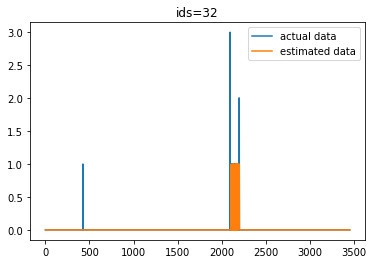

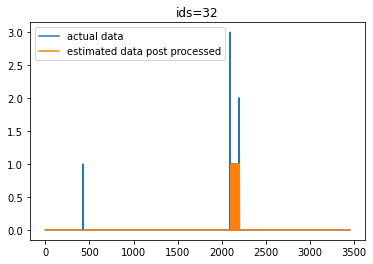

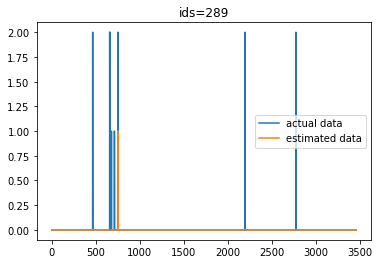

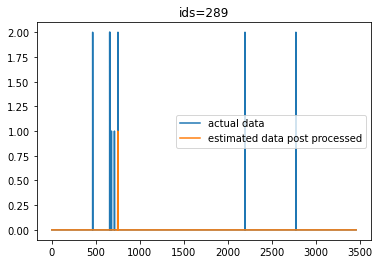

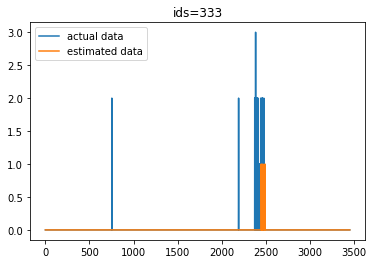

...

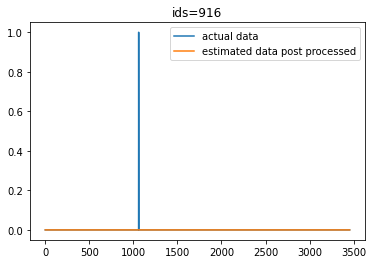

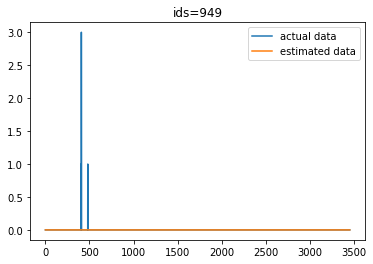

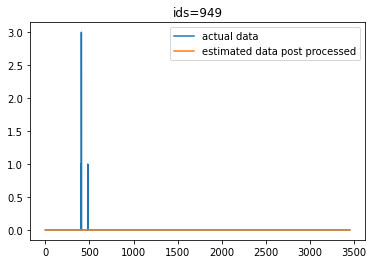

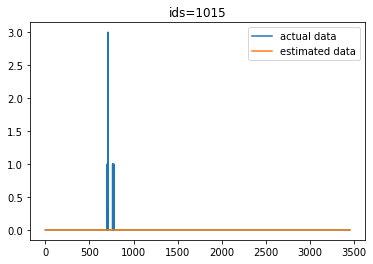

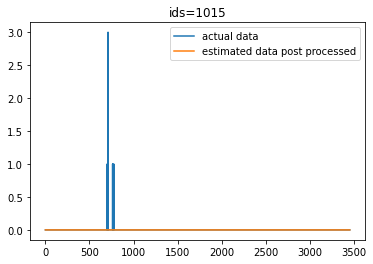

In [468]:
#check the predicted and the actual data, how different are they
#before, check the result calculated based on sparse svd
predsvd_rmse_int = np.rint(predsvd_rmse)
print(cal_rmse(test_matrice_reverse, predsvd_rmse_int)) #but has negative values
print(cal_rmse(test_matrice_reverse, test3))
del(predsvd_rmse_int)

#check if values with high obs are predicted well
#check if values with low obs are predicted well
#plot the value first to check if pattern looks similar

for i in range(len(newids_all)):
    if i <= 10:
        plt.figure(i)
        plt.plot(test_matrice_reverse[i][1:], label='actual data')
        plt.plot(test3[i], label='estimated data')
        plt.title('ids='+str(newids_all[i]))
        plt.legend()
        plt.figure(1e5+i)
        plt.plot(test_matrice_reverse[i][1:], label='actual data')
        plt.plot(test4[i], label='estimated data post processed')
        plt.title('ids='+str(newids_all[i]))
        plt.legend()
        diff = set(test_matrice_reverse[i][1:]) ^ set(test3[i])
        print(diff)
    

In [471]:
#get rank of the matrix
from numpy.linalg import matrix_rank
matrix_rank(test_matrice_reverse)

3346

In [475]:
#data density
np.count_nonzero(test_matrice_reverse)/((test_matrice_reverse.shape[0])*(test_matrice_reverse.shape[1]))

0.00447391724532401

In [ ]:
prednmf_rmse

In [69]:
crossed_rt[['newid','ori_geo', 'dest_geo','time_diff','od_euqal', 'new_ori', 'new_dest', 'crossed_ct', 'ct_check',\
       'no_crossed_ct', 'travel_time', 's_hr', 'e_hr', 's_min', 'e_min','s_minut_5', 'e_minut_5', 'ori_st', 'dest_st']].head(3)

,newid,ori_geo,dest_geo,time_diff,od_euqal,new_ori,new_dest,crossed_ct,ct_check,no_crossed_ct,travel_time,s_hr,e_hr,s_min,e_min,s_minut_5,e_minut_5,ori_st,dest_st
0,32,53033008100,53033008100,16.0,False,53033008100,53033007200,"[53033008100, 53033007200]",2,"[53033008001, 53033008002, 53033007300, 530330...",6,6,7,45,1,45,0,53033008100_6_45,53033007200_7_0
1,32,53033008100,53033008100,6.0,False,53033007200,53033007300,"[53033007200, 53033007300]",2,"[53033008001, 53033008002, 53033008100, 530330...",1,7,7,27,34,25,30,53033007200_7_25,53033007300_7_30
2,32,53033008100,53033008100,6.0,False,53033007300,53033007200,"[53033007300, 53033008200, 53033008100, 530330...",2,"[53033008001, 53033008002, 53033007401, 530330...",3,7,7,46,53,45,50,53033007300_7_45,53033007200_7_50


In [67]:
#correct the data 
#estimate 0
#method 1: post processing 
crossed_rt.sort_values(by=['newid', 'travel_time']).head(3)

,Unnamed: 0,Unnamed: 0.1,geometry,osmids,length_m,newid,ori_geo,dest_geo,start_time,end_time,...,no_crossed_ct,travel_time,s_hr,e_hr,s_min,e_min,s_minut_5,e_minut_5,ori_st,dest_st
1,34410,1,"LINESTRING (-122.3385429 47.6121913, -122.3374...","[2481926130, 3618304999]",0.001237,32,53033008100,53033008100,1491402457,1491402870,...,"[53033008001, 53033008002, 53033008100, 530330...",1,7,7,27,34,25,30,53033007200_7_25,53033007300_7_30
3,34412,3,"LINESTRING (-122.3385429 47.6121913, -122.3374...","[2481926130, 3618304999]",0.001237,32,53033008100,53033008100,1491403987,1491404376,...,"[53033008001, 53033008002, 53033008100, 530330...",1,7,7,53,59,50,55,53033007200_7_50,53033007300_7_55
5,34414,5,"LINESTRING (-122.3385429 47.6121913, -122.3374...","[2481926130, 3618304999]",0.001237,32,53033008100,53033008100,1491405412,1491407873,...,"[53033008001, 53033008002, 53033008100, 530330...",1,8,8,16,57,15,55,53033007200_8_15,53033007300_8_55


In [ ]:
'''latent_num = list(range(2, 55))
plt.plot(latent_num, list(rmse_svd_s.values()), label='svd')
plt.plot(latent_num, list(rmse_nmf_s.values()), label='nmf')
plt.legend()
plt.grid()
plt.title('rmse of estimated scaled obs')'''

In [66]:
#np.unique(predsvd_rmse)
#np.unique(prednmf_rmse)

Text(0.5, 1.0, 'rmse of estimated obs')

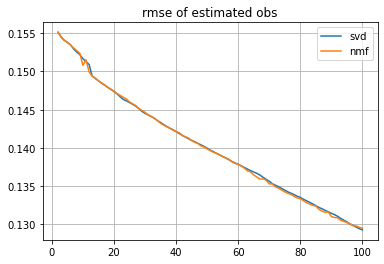

In [39]:
latent_num = list(range(2, 101))
plt.plot(latent_num, rmse_svd.values(), label='svd')
plt.plot(latent_num, rmse_nmf.values(), label='nmf')
plt.legend()
plt.grid()
plt.title('rmse of estimated obs')

In [40]:
#plot current value 
def plot_predvsobs(pred_matrix, test_matrix, num_row):
    plt.figure(num_row)
    plt.plot(test_matrix[num_row][1:], label='observed')
    plt.plot(pred_matrix[num_row], label='predicted')
    plt.legend()
    plt.grid()
    plt.title('predicted vs. observed for smartphone id: '+str(int(test_matrix[num_row][0])))

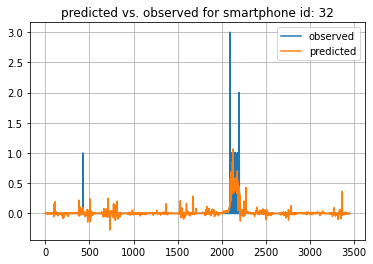

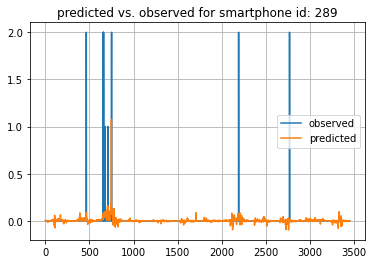

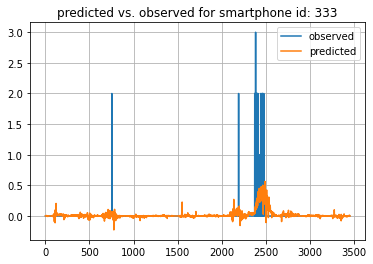

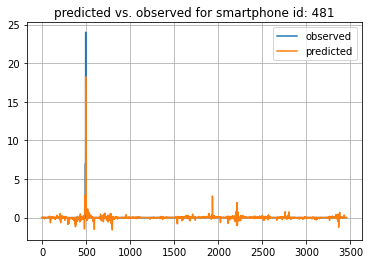

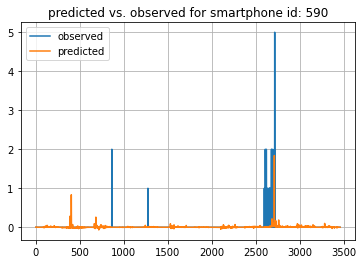

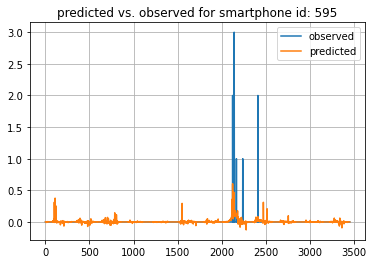

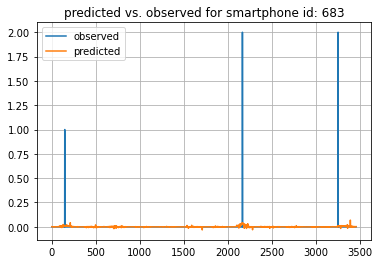

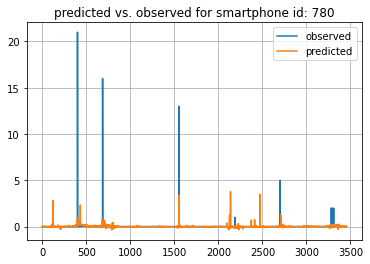

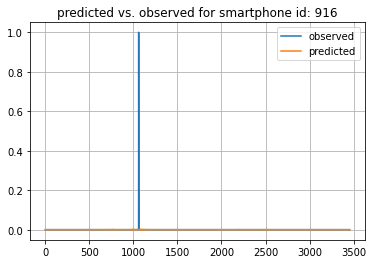

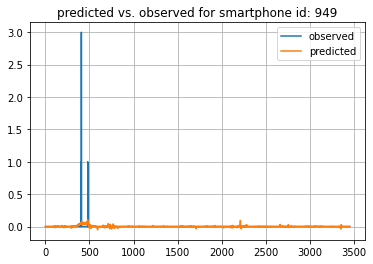

In [41]:
for i in range(10):
    plot_predvsobs(predsvd_rmse, test_matrice_reverse, i)

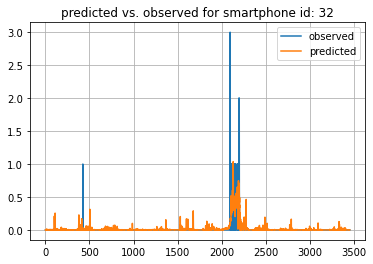

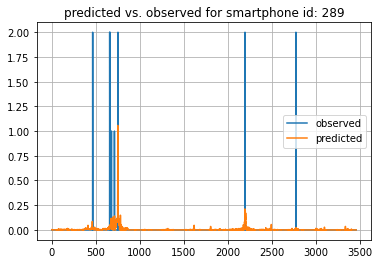

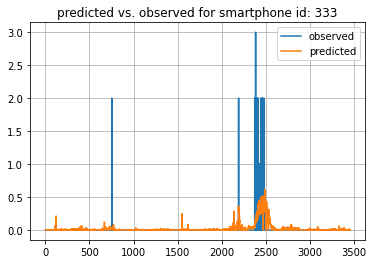

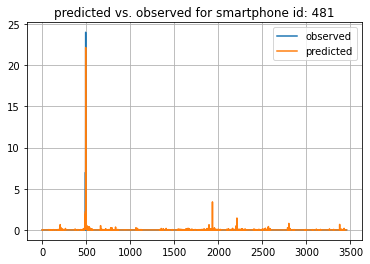

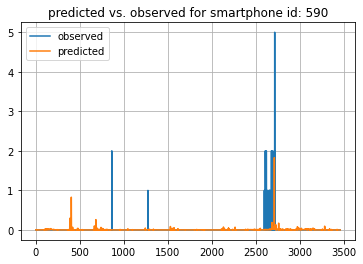

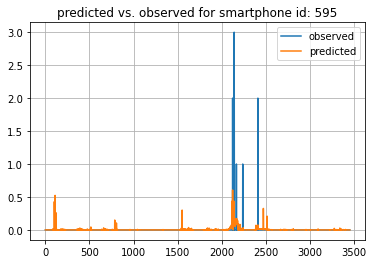

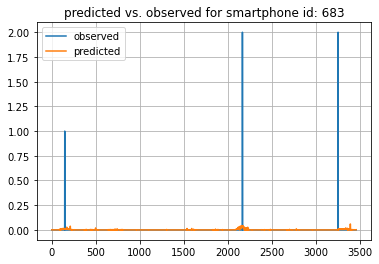

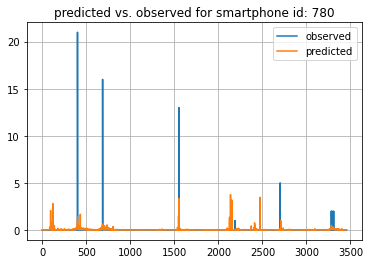

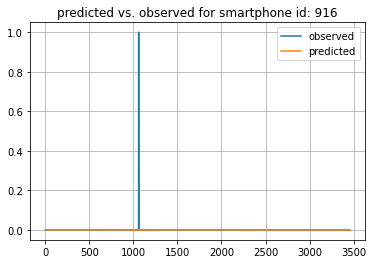

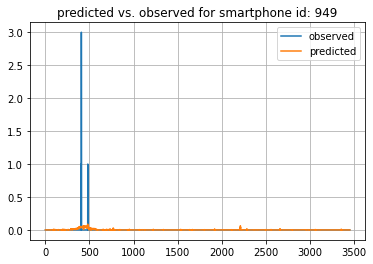

In [42]:
#plot top ten
for i in range(10):
    plot_predvsobs(prednmf_rmse, test_matrice_reverse, i)

In [43]:
prednmf_18 = NMF_est(test_matrice_reverse, 18, 6)

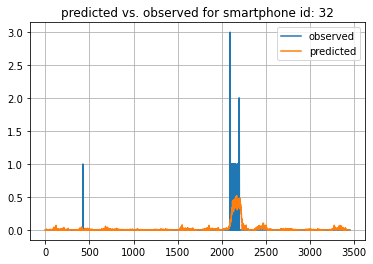

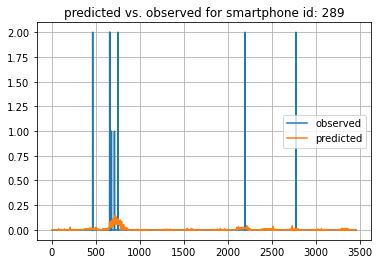

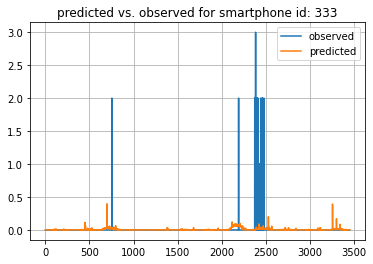

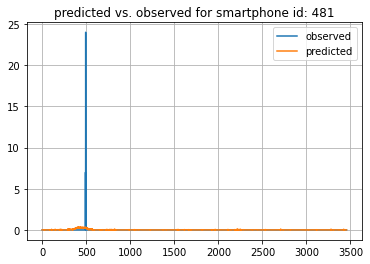

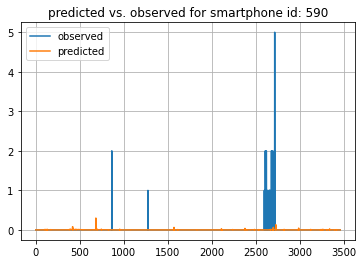

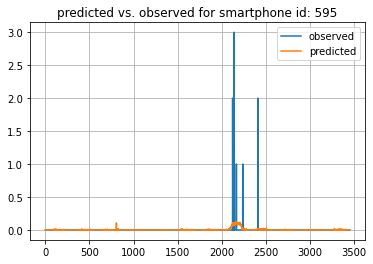

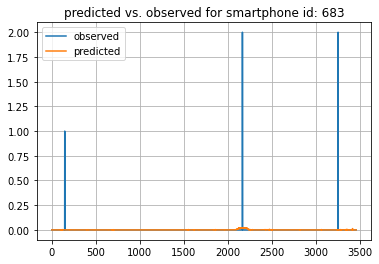

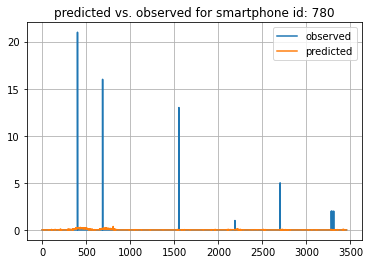

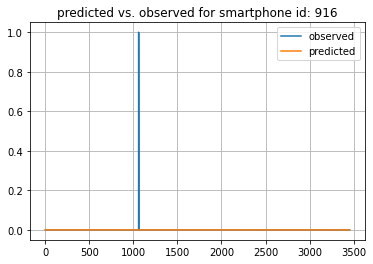

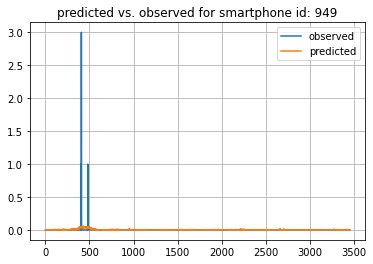

In [44]:
#when latent var is small
for i in range(10):
    plot_predvsobs(prednmf_18, test_matrice_reverse, i)

In [42]:
np.max(prednmf_rmse[0])
np.min(prednmf_rmse[0])

0.0

[]

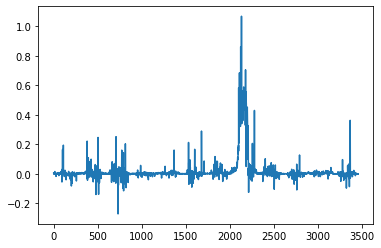

In [43]:
plt.plot(predsvd_rmse[0])
plt.plot(prednmf_rmse[0])

In [51]:
pred_dt = CF(test_matrice_scaled_reverse, best_lf)

In [52]:
pred_dt.shape
np.count_nonzero(pred_dt)

#jaccard similarity
#cosine similarity
#center cosine similarity

26842751

In [53]:
a = 0
non_zeros = []
max_num = 0
for i in test_matrice_scaled_reverse[:, 1:][0]:
    if i>0:
        non_zeros.append(a)
    if i == np.max(test_matrice_scaled_reverse[:, 1:][0]):
        max_num = a
    a = a+1

In [54]:
predict_dt = pd.DataFrame(locts_map.keys())
predict_dt['predict_obs'] = list(np.sum(pred_dt, axis=0))
predict_dt.sort_values(by=['predict_obs'], ascending=False)

,0,predict_obs
2235,53033008100_18_15,1936.375571
2213,53033008100_16_25,1929.159027
2206,53033008100_15_50,1927.453575
2236,53033008100_18_20,1927.200578
699,53033007300_10_15,1927.109055
...,...,...
2013,53033008002_23_45,1903.922852
2917,53033008400_3_5,1903.922786
1760,53033008002_2_40,1903.921539
2931,53033008400_4_15,1903.920546


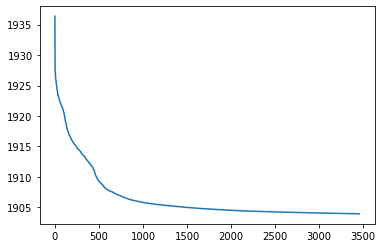

In [55]:
#plt.plot(sorted(predict_dt['predict_obs'].values, reverse=True))

### Content-based filtering
Content-based filtering approaches leverage description or attributes from items the user has interacted to recommend similar items. It depends only on the user previous choices, making this method robust to avoid the cold-start problem. For textual items, like articles, news and books, it is simple to use the raw text to build item profiles and user profiles.
Here we are using a very popular technique in information retrieval (search engines) named TF-IDF. This technique converts unstructured text into a vector structure, where each word is represented by a position in the vector, and the value measures how relevant a given word is for an article. As all items will be represented in the same Vector Space Model, it is to compute similarity between articles.
See this presentation (from slide 30) for more information on TF-IDF and Cosine similarity.

In [84]:
import sklearn
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import MinMaxScaler

In [85]:
obs_Seattle.head(3)

,GEOID10,hr,minut_5,newid,obs,spatial_temporal_id,norm_obs,norm_obs_5
211948,53033007100,0,0,7528,1,53033007100_0_0,0.012195,0.060976
211949,53033007100,0,0,36180,2,53033007100_0_0,0.024390,0.121951
211950,53033007100,0,0,54917,1,53033007100_0_0,0.012195,0.060976


In [86]:
#two ways to construct the term frequency into the content-based model
#1 based on the sampled pop ratio (same at each time, differ in census tract only)
#2 based on the demographic ratio from the identified (differ in census tract and time)

##1
seattle_ct = list(np.unique(obs_Seattle['GEOID10']))
for i in range(len(seattle_ct)):
    seattle_ct[i] = str(seattle_ct[i])
    
Seattle_dt = demo_reg_df[demo_reg_df['GEOID10'].isin(seattle_ct)]
#ideal ratio
#Seattle_dt['g..']
#actual ratio
#Seattle_dt['sm..']
#get the smartphone demo ratio
selected_smartphone_col = []
for i in range(1, 19):
    selected_smartphone_col.append('t_g'+str(i)+'_sm')

smartphone_ratios_ct = Seattle_dt[selected_smartphone_col].values
feature_matrice_1 = np.zeros((len(locts_map.keys()),smartphone_ratios_ct.shape[1]))
#assign ratio to matrix
a = 0
for i in locts_map.keys():
    ct = i.split('_')[0]
    row = seattle_ct.index(ct)
    feature_matrice_1[a] = smartphone_ratios_ct[row]
    a = a+1

In [87]:
##2
random_seeds = 42
ids_with_home = assign_demo(sample_ids, ids_with_home, random_seeds)

In [88]:
user_ids_index = np.array(list(newids_map.keys()))
user_ids_index = user_ids_index.reshape(user_ids_index.shape[0],1)

In [89]:
Seattle_df.head(3)

,Unnamed: 0,newid,spatial_temporal_id,norm_obs_5
0,0,32,53033008100_9_20,0.060976
1,1,32,53033008100_7_5,0.060976
2,2,32,53033008100_11_0,0.060976


In [90]:
#create a dict to store demo info for each new id
ids_demo_dict = {}
newids = list(ids_with_home['newid'].values)
demo_groups = list(ids_with_home['demo_group'].values)

for i in range(len(newids)):
    ids_demo_dict[newids[i]] = demo_groups[i]


newids = list(Seattle_df['newid'].values)
demo_groups = []
for i in range(len(newids)):
    demo_groups.append(ids_demo_dict[newids[i]])
    
Seattle_df['demo_group'] = demo_groups

del(newids)
del(demo_groups)

In [91]:
demo_ct_t_df = Seattle_df[['newid', 'spatial_temporal_id','demo_group']].groupby(['spatial_temporal_id','demo_group']).count().reset_index()

demo_ct_t_df.columns = ['spatial_temporal_id','demo_group','obs_ids']

feature_matrice_2 = np.zeros((len(locts_map.keys()),smartphone_ratios_ct.shape[1]))
num_obs = demo_ct_t_df['obs_ids'].values
demo_gs = demo_ct_t_df['demo_group'].values
ct_t = demo_ct_t_df['spatial_temporal_id'].values
ct_t_index = list(locts_map.keys())
for i in range(len(num_obs)):
    feature_matrice_2[ct_t_index.index(ct_t[i])][demo_gs[i]-1] = num_obs[i]
feature_matrice_2 = feature_matrice_2/np.sum(feature_matrice_2, axis=1).reshape(3456,1)

del(num_obs)
del(demo_gs)
del(ct_t)
del(ct_t_index)

In [92]:
#thus we get two matrice for model
#feature_matrice_1
#feature_matrice_2
#feature_matrice_1.shape
#Seattle_df.head(3)
#feature_matrice_1

In [93]:
feature_matrice_2

array([[0.375     , 0.125     , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.2       , 0.2       , 0.06666667, ..., 0.        , 0.        ,
        0.        ],
       [0.23076923, 0.30769231, 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.23076923, 0.07692308, 0.15384615, ..., 0.        , 0.        ,
        0.07692308],
       [0.18181818, 0.        , 0.09090909, ..., 0.        , 0.        ,
        0.        ],
       [0.30769231, 0.        , 0.07692308, ..., 0.        , 0.        ,
        0.        ]])

In [94]:
feature_csr1 = csr_matrix(feature_matrice_1)
feature_csr2 = csr_matrix(feature_matrice_2)

In [95]:
item_ids = list(locts_map.keys())

In [96]:
def get_item_profile(item_id, feature_matrix):
    idx = item_ids.index(item_id)
    item_profile = feature_matrix[idx:idx+1]
    return item_profile

def get_item_profiles(ids, feature_matrix):
    item_profiles_list = [get_item_profile(x, feature_matrix) for x in ids]
    item_profiles = scipy.sparse.vstack(item_profiles_list)
    return item_profiles

def build_users_profile(user_id, Seattle_df_indexed, feature_matrix):
    Seattle_userid_df = Seattle_df_indexed.loc[user_id]
    user_item_profiles = get_item_profiles(list(Seattle_userid_df['spatial_temporal_id'].values), feature_matrix)
    user_item_strengths = np.array(Seattle_userid_df['norm_obs_5'])
    user_item_strengths = user_item_strengths.reshape((user_item_strengths.shape[0],1))
    #Weighted average of item profiles by the ob
    user_item_strengths_weighted_avg = np.sum(user_item_profiles.multiply(user_item_strengths), axis=0) / np.sum(user_item_strengths)
    user_profile_norm = sklearn.preprocessing.normalize(user_item_strengths_weighted_avg)
    return user_profile_norm

def build_users_profiles(feature_matrix): 
    Seattle_indexed_df = Seattle_df.set_index('newid')
    user_profiles = {}
    for user_id in Seattle_indexed_df.index.unique():
        if user_id not in useridw1_obs:
            #print(user_id)
            user_profiles[user_id] = build_users_profile(user_id, Seattle_indexed_df, feature_matrix)
    return user_profiles



In [97]:
a = Seattle_df[['newid','spatial_temporal_id']].groupby(['newid']).count().reset_index()
useridw1_obs = list(a['newid'][a['spatial_temporal_id']==1].values)

In [73]:
#Seattle_df['spatial_temporal_id'][Seattle_df['newid']==916].values

In [98]:
user_profiles_1 = build_users_profiles(feature_csr1)

In [99]:
user_profiles_2 = build_users_profiles(feature_csr2)

In [ ]:
#user_profiles_1.keys()

In [100]:
demo_group = []
for i in range(18):
    demo_group.append('g'+str(i+1))

In [101]:
def plot_demo_est(user_profiles_1):
    a = []
    for i in user_profiles_1:
        if a == []:
            a = user_profiles_1[i]
        else:
            a = a + user_profiles_1[i]
    bar_loc = []
    for i in range(18):
        bar_loc.append('g'+str(i+1))
    plt.bar(bar_loc, list((a/np.sum(a))[0]))

<ipython-input-101-b81e6179544e>:4: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if a == []:


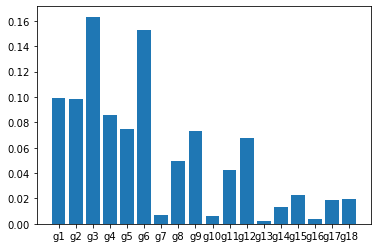

In [102]:
plot_demo_est(user_profiles_1)

<ipython-input-101-b81e6179544e>:4: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if a == []:


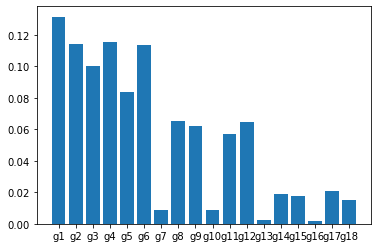

In [103]:
plot_demo_est(user_profiles_2)

In [ ]:
'''pd.DataFrame(sorted(zip(demo_group, 
                        user_profiles_1[32].flatten().tolist()), key=lambda x: -x[1])[:20],
             columns=['token', 'relevance'])
a = pd.DataFrame(sorted(zip(demo_group, 
                        user_profiles_2[32].flatten().tolist()), key=lambda x: -x[1])[:20],
             columns=['token', 'relevance'])'''

In [104]:
ct_t = list(locts_map.keys())

In [105]:
#calculate cosine similarity
def get_simi_para(userid, feature_csr, user_profiles, items_to_ignore = []):
    cos_sim = cosine_similarity(user_profiles[userid], feature_csr)
    #similar_indice = cos_sim.argsort().flatten()
    #similar_items = sorted([(ct_t[i], cos_sim[0,i]) for i in similar_indice], key=lambda x: -x[1])
    #items_to_ignore = []
    #similar_items_filtered = list(filter(lambda x: x[0] not in items_to_ignore, similar_items))
    return(cos_sim)
    
    

In [106]:
predict_cb1 = np.zeros(test_matrice_scaled.T.shape)
predict_cb2 = np.zeros(test_matrice_scaled.T.shape)

In [107]:
def assign_cb_predict_value(user_profiles, predict_matrix, feature_csr):
    for ids in user_ids:
        if ids in user_profiles_1:
            idx = user_ids.index(ids)
            predict_matrix[idx] = get_simi_para(ids, feature_csr, user_profiles, [])
    return(predict_matrix)
    

In [108]:
predict_cb1 = assign_cb_predict_value(user_profiles_1, predict_cb1, feature_csr1)
predict_cb2 = assign_cb_predict_value(user_profiles_2, predict_cb2, feature_csr2)

In [109]:
def norm_predict(predict_cb1):
    return(((predict_cb1 - predict_cb1.min())/(predict_cb1.max()-predict_cb1.min()))*5)

In [110]:
print(cal_rmse(test_matrice_scaled_reverse, norm_predict(predict_cb2)))
print(cal_rmse(test_matrice_scaled_reverse, norm_predict(predict_cb1)))

3.4579053008198213
4.4446033752575795


In [111]:
print(cal_r2(test_matrice_scaled_reverse, norm_predict(predict_cb2)))

-465165.6334135447


In [112]:
#normalization
print(cal_rmse(test_matrice_scaled_reverse, predict_cb1))
print(cal_rmse(test_matrice_scaled_reverse, predict_cb2))

0.8885801013075609
0.6911985057828574


## Hybrid model

In [151]:
#weight * content + weight* collaborative_filtering
def get_rmse_hb(w_cb, w_cf, both_value=False):
    predict_hb1 = norm_predict(w_cb*predict_cb1+w_cf*pred_dt)
    predict_hb2 = norm_predict(w_cb*predict_cb2+w_cf*pred_dt)
    a1 = cal_rmse(test_matrice_scaled_reverse, predict_hb1)
    a2 = cal_rmse(test_matrice_scaled_reverse, predict_hb2)
    if both_value==True:
        print(a1, a2)
    return(min(a1, a2))

In [152]:
def get_r2_hb(w_cb, w_cf):
    predict_hb1 = norm_predict(w_cb*predict_cb1+w_cf*pred_dt)
    predict_hb2 = norm_predict(w_cb*predict_cb2+w_cf*pred_dt)
    a1 = cal_r2(test_matrice_scaled_reverse, predict_hb1)
    a2 = cal_r2(test_matrice_scaled_reverse, predict_hb2)
    return(min(a1, a2))

In [153]:
cf_rmse = cal_rmse(test_matrice_scaled_reverse, pred_dt)

In [154]:
cb2_r2 = cal_r2(test_matrice_scaled_reverse, norm_predict(predict_cb2))
cb1_r2 = cal_r2(test_matrice_scaled_reverse, norm_predict(predict_cb1))
print(cb1_r2, cb2_r2)

-1127654.1777309803 -465165.6334135447


In [155]:
cf_r2 = cal_r2(test_matrice_scaled_reverse, pred_dt)
selected_model = []
select_r2 = cf_r2
for i in range(500):
    w_cb = (i+1)/500
    w_cf = 1 - w_cb
    hb_r2 = get_r2_hb(w_cb, w_cf)
    
    if abs(hb_r2) < abs(select_r2):
        current_model = []
        current_model.append(w_cb)
        current_model.append(w_cf)
        current_model.append(hb_r2)
        select_r2 = hb_r2
        
print(current_model)

[0.114, 0.886, -2878.419966897937]


In [156]:
get_rmse_hb(0.114, 0.886)

0.21507453707417443

In [157]:
select_rmse = cf_rmse
for i in range(500):
    w_cb = (i+1)/500
    w_cf = 1 - w_cb
    hb_rmse = get_rmse_hb(w_cb, w_cf)
    if hb_rmse < select_rmse:
        select_model = []
        select_model.append(w_cb)
        select_model.append(w_cf)
        select_model.append(hb_rmse)
        select_rmse = hb_rmse
        #print(w_cb, w_cf, hb_rmse)

In [158]:
print(select_model)
print(select_rmse)

[0.128, 0.872, 0.21154936206360517]
0.21154936206360517


## Evaluation

In [ ]:
#use r square

In [159]:
get_rmse_hb(0.114, 0.886)

0.21507453707417443

In [160]:
get_r2_hb(0.114, 0.886)

-2878.419966897937

In [161]:
w_cb=.114
w_cf=.886
predict_hb2 = norm_predict(w_cb*predict_cb2+w_cf*pred_dt)

In [162]:
predict_hb2.shape

(7767, 3456)

In [163]:
np.min(predict_hb2)
np.max(predict_hb2)

5.0

In [164]:
np.unique(test_matrice_scaled_reverse[0,1:])

array([0.        , 0.06097561, 0.12195122, 0.18292683])

In [165]:
test_array = list(test_matrice_scaled_reverse[0,1:])
#np.unique(predict_hb2[0])
np.unique(test_array)
#compare with actual non-zero data

test_nonzero = []
for i in range(len(test_array)):
    if test_array[i] > 0:
        test_nonzero.extend([i, test_array[i], predict_hb2[0][i]])

In [166]:
#test the first 10 people to check the pattern observed
def plotfigure(i):
    plt.figure()
    plt.plot(predict_cb2[i],'c')
    plt.plot(test_matrice_scaled_reverse[i,1:],'b')
    plt.xlabel('temporal_spatial')
    plt.ylabel('scaled_rates')
    plt.title('cb vs. data')

    plt.figure()
    plt.plot(pred_dt[i],'r')
    plt.plot(test_matrice_scaled_reverse[i,1:],'b')
    plt.xlabel('temporal_spatial')
    plt.ylabel('scaled_rates')
    plt.title('cf vs. data')

    plt.figure()
    plt.plot(predict_hb2[i],'m')
    plt.plot(test_matrice_scaled_reverse[i,1:],'b')
    plt.xlabel('temporal_spatial')
    plt.ylabel('scaled_rates')
    plt.title('hb vs. data')

<ipython-input-166-0a82cf4d6639>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


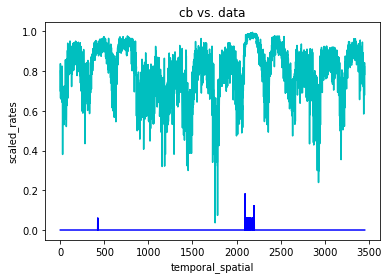

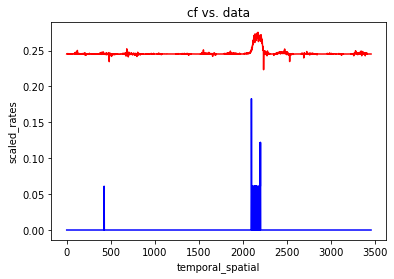

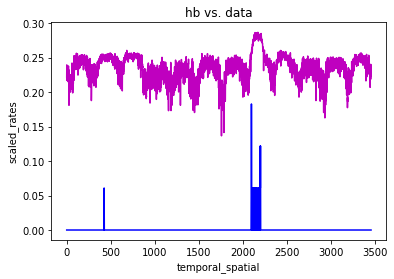

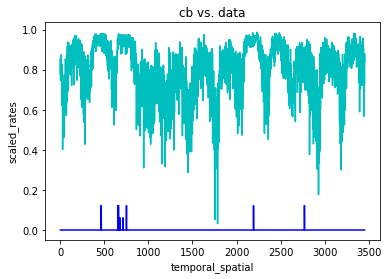

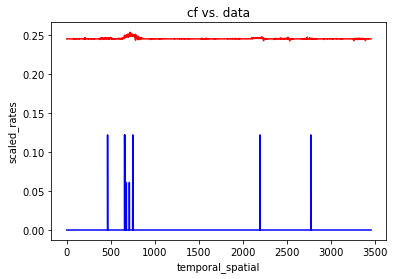

...

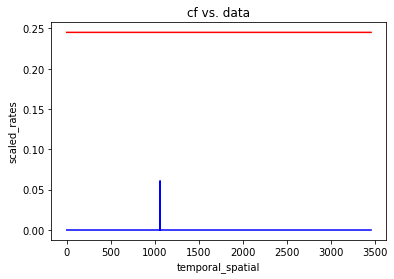

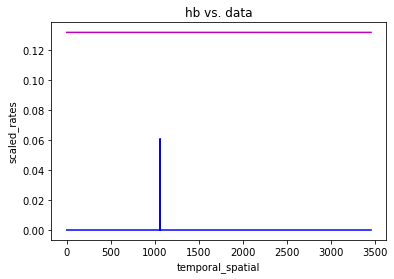

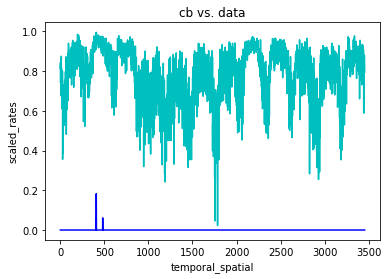

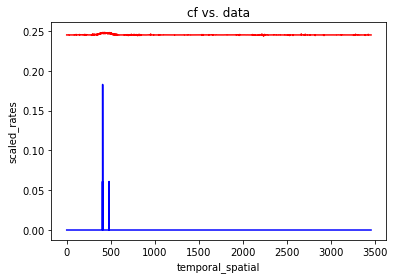

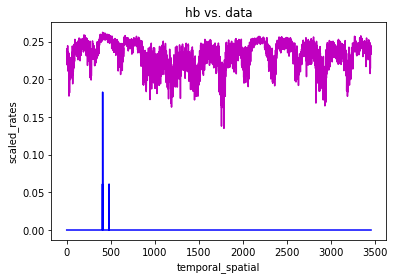

In [167]:
#check the data
for i in range(10):
    plotfigure(i)

In [168]:
sorted(np.unique(obs_Seattle['GEOID10']))

[53033007100,
 53033007200,
 53033007300,
 53033007401,
 53033007402,
 53033008001,
 53033008002,
 53033008100,
 53033008200,
 53033008300,
 53033008400,
 53033008500]

In [169]:
locts_map
len(newids_map)

7767

In [170]:
#home id for a specific id
#ids_with_home
#get GEOID for each new id (knowing where they live)
selected_id_dt = ids_with_home[['GEOID10','newid']][ids_with_home['newid'].isin(list(newids_map.keys()))]
selected_id_dt = selected_id_dt.sort_values(by=['newid'])
selected_id_dt = selected_id_dt.reset_index()
#check if the order matches our predict user id order
#list(selected_id_dt['newid'].values) == list(newids_map.keys())
selected_id_dt = selected_id_dt[['GEOID10', 'newid']]

In [171]:
def array2csv(predict_matrix, selected_ids, home_info, column_name, savepath, return_data=True):
    pred_csv = pd.DataFrame(predict_matrix, columns=column_name)
    pred_csv['ids'] = selected_ids
    pred_csv['ids_hm'] = home_info
    pred_csv.to_csv(savepath)
    if return_data == True:
        return(pred_csv)

In [172]:
predict_dt.shape

(3456, 2)

In [173]:
#pred_cf_dt = array2csv(pred_dt, list(newids_map.keys()), list(selected_id_dt['GEOID10'].keys()), list(locts_map.keys()),\
#                       'pred_cf.csv', True)

pred_hb_dt = array2csv(predict_hb2, list(newids_map.keys()), list(selected_id_dt['GEOID10'].keys()), list(locts_map.keys()),\
                       'pred_hb.csv', True)

array2csv(predict_cb2, list(newids_map.keys()), list(selected_id_dt['GEOID10'].keys()), list(locts_map.keys()),\
         'pred_cb.csv', False)

#### get the data with neighborhood
neighborhood method: \
aggregate(\
 layer:= 'Zip_Codes',\
 aggregate:='concatenate',\
 expression:=ZIPCODE,\
 concatenator:=', ',\
 filter:=intersects($geometry, buffer(geometry(@parent),1))\
 )
 
Source: https://spatialthoughts.com/2019/05/23/neighbor-polygons-aggregate-qgis/

In [116]:
nb_census = pd.read_csv('G:/My Drive/2021/Bias/census_tract_process/Seattle_ct.csv')
#for i in ['Nb_interse', 'nb_count','nb_touch', 'nb_bf_5', 'nb_bf10', 'nb_bf100','nb_bf1mi']:
#    print(i, nb_census[i].values[0])

nb_census = nb_census[['GEOID10', 'NAME10', 'Nb_interse','nb_touch', 'nb_bf1mi']]

#identify the neighbors in each census tract:
GEOIDs = list(nb_census['GEOID10'].values)

neighbor_dir_nobf = {}
neighbor_dir_bf1mi = {}

def assign_neighbor(nbdir, neighborlst):
    selected_nblst = []
    if len(neighborlst)== 1:
        neighborlst = neighborlst[0].split(',')
        for i in neighborlst:
            if int(i) in GEOIDs:
                selected_nblst.append(int(i))
                
                
    else:
        print(neighborlst)
        
    for i in neighborlst:
        if int(i) not in nbdir:
            nbdir[int(i)] = []
            nbdir[int(i)].extend(selected_nblst)
        else:
            nbdir[int(i)].extend(selected_nblst)
    return(nbdir)

    
for i in range(len(GEOIDs)):
    neighbor_dir_nobf = assign_neighbor(neighbor_dir_nobf, nb_census['Nb_interse'][nb_census['GEOID10']==GEOIDs[i]].values)
    neighbor_dir_bf1mi = assign_neighbor(neighbor_dir_bf1mi, nb_census['nb_bf1mi'][nb_census['GEOID10']==GEOIDs[i]].values)

for i in GEOIDs:
    neighbor_dir_nobf[i] = list(np.unique(neighbor_dir_nobf[i]))
    if i in neighbor_dir_nobf[i]:
        neighbor_dir_nobf[i].remove(i)
    neighbor_dir_bf1mi[i] = list(np.unique(neighbor_dir_bf1mi[i]))
    if i in neighbor_dir_bf1mi[i]:
        neighbor_dir_bf1mi[i].remove(i)
    


## Model
https://colab.research.google.com/drive/1Jd0swksYcv7AAF_H0ImfEee9oT_jgrIM#scrollTo=sF4nUjipz8Bh

Matrix factorization (MF) supposes that each observed evaluation $r_{ui}$ for $1 \leq u \leq |U|$ and $1 \leq i \leq |I|$, where $|U|$ and $|I|$ are respectively the number of users and movies, can be estimated with respect to a latent (hidden) model. This model presents the estimate $\hat{r}_{ui}$ of the observed evaluation $r_{ui}$ as:


$$
\begin{align}
\hat{r}_{ui} =  \langle p_{u}, q_{i} \rangle, 
\end{align}
$$

where $\langle \cdot \rangle$ is the scalar product and $p_{u}$ and $q_{i}$ are the latent representations associated to user <i>u</i> and item <i>i</i>. The intuition behind this representation suggests that each evaluation can be estimated by considering a latent characterization of users and items.

For example, let's fix the number of latent variables to 3, and suppose that they are associated with the popularity of the movie at the box office, its duration and finally its level of romance. Let us define the <i>u</i> user as a 15-year-old teenager who loves popular and relatively short horror movies. We can model the associated latent vector by:
$$
\begin{align}
p_{u} = [1, 0, 0]^T.
\end{align}
$$

Suppose now that the movie <i>i</i> turns out to be <i>The Lion King</i> with the following latent modelization:

$$
\begin{align}
q_{i} = [1, 0.5, 0]^T.
\end{align}
$$

The estimation of the evaluation for this user and item according to the latent representations will therefore be:

$$
\begin{align}
\hat{r}_{ui} =  \langle p_u, q_i \rangle = 1.
\end{align}
$$

The main challenge in this type of model is to define the set of latent vectors associated with users, grouped in matrix form by $\mathbf{P}_{|U| \times k} = [p_1, p_2, .. ., p_k]$, and to items, grouped in matrix form by $ \mathbf{Q}_{|I| \times k} = [q_1, q_2, ..., q_k] $.
 
Since the initial problem is to present the most accurate estimates, and thus to calculate $\mathbf{P}$ and $\mathbf{Q}$ so as to minimize the distance between the totality of the observed ratings $r_{ui}$ and their estimate $\hat {r}_{ui}$, we can define the task to accomplish with the following optimization problem:

$$
\begin{align}
\mathbf{P}, \mathbf{Q} = \underset{p, q}{\operatorname{argmin}} \sum_{r_{ui} \neq 0} (r_{ui} - \hat{r}_{ui})^2 = \underset{p, q}{\operatorname{argmin}}  \sum_{r_{ui} \neq 0} (r_{ui} - \langle p_u, q_i \rangle)^2.
\end{align}
$$

We may add a regularization on the latent variables, in order to force the associated vectors to have non-zero components:

$$
\begin{align}
\mathbf{P}, \mathbf{Q} = \underset{p, q}{\operatorname{argmin}} \sum_{r_{ui} \neq 0} \{(r_{ui} - \langle p_u, q_i \rangle)^2 + \lambda(||p_u||^2 + ||q_i||^2)\},
\end{align}
$$

where $\lambda$ is the regularization hyperparameter, <i>weigth decay</i> in deep learning, or Lagrange multiplier in math. Although this last remark seems technical, it should be noted that latent vectors with very few zero values will in turn lead to predicted ratings other than zero. Since we are trying to propose new recommendations, this constraint seems useful to avoid a sparse matrix estimate $\hat{\mathbf{R}}$.

In general, the optimization problem above, which turns out to factorize a sparse matrix, cannot be solved as easily as using the least squares in a linear regression context for example. In this tutorial, we will introduce the stochastic gradient descent algorithm, as one of the approaches to solving this optimization problem to estimate $\mathbf{P}$ and $ \mathbf{Q}$ matrices

## Implementation

In order to build a recommendation system based on MF, we have to define some specific functions necessary for this type of algorithm. Overall, we will break down the implementation process into three steps:

1. <b>Learning loop</b>: Iterative optimization process that will estimate how far off the model is from satisfying a given objective, and will make the necessary model updates until a given stopping criterion is reached. 

2. <b> Loss Function</b>: Calculates how far off our model's prediction is from the true observation.

3. <b> Estimation</b>: Estimation of the matrices of factors $\mathbf{P}$ and $\mathbf{Q}$ respectively associated with the users and the items.

In [ ]:
def learn_to_recommend(data, features=10, lr=0.0002, epochs=101, weigth_decay=0.02, stopping=0.001):
    """
    Args:
       data: every evaluation
       features: number of latent variables
       lr: learning rate for gradient descent
       epochs: number of iterations or maximum loops to perform
       weigth_decay: L2 regularization to predict rattings different of 0
       stopping: scalar associated with the stopping criterion
      
     Returns:
       P: latent matrix of users (spatial temporal matrix)
       Q: latent matrix of items (id matrix)
       loss_train: vector of the different values of the loss function after each iteration on the train
       loss_valid: vector of the different values of the loss function after each iteration not on valid
       """
     
    train, valid = data[0], data[1]
    nb_users, nb_items = len(train), len(train[0])

    # Answer 4.2: Initialization of lists
    loss_train, loss_valid = [], []

    P = np.random.rand(nb_users, features) * 0.1
    Q = np.random.rand(nb_items, features) * 0.1
    
    for e in range(epochs):        
        for u in range(nb_users):
            for i in range(nb_items):

                # Answer 4.1: Code the condition
                if train[u][i] > 0:
                    error_ui = train[u][i] - prediction(P, Q, u, i)
                    P, Q = sgd(error_ui, P, Q, u, i, features, lr, weigth_decay)
                               
        # Answer 4.2: Code the statistics
        loss_train.append(loss(train, P, Q))
        loss_valid.append(loss(valid, P, Q))
        
        if e % 10 == 0:
            print('Epoch : ', "{:3.0f}".format(e+1), ' | Train :', "{:3.3f}".format(loss_train[-1]), 
                  ' | Valid :', "{:3.3f}".format(loss_valid[-1]))

        if e > 1:
            if abs(loss_valid[-1] - loss_valid[-2]) < stopping:
                break
        
    return P, Q, loss_train, loss_valid

def prediction(P, Q, u, i):
    """
    Args:
        P: user matrix (temporal spatial matrix)
        Q: matrix of items (id matrix)
        u: index associated with user u (index associated with temporal spatial matrix)
        i: index associated with item i (... with id matrix)
    Returns:
        pred: the predicted evaluation of the user u for the item i
    """
    
    return np.dot(P[u,:], Q[i,:])

def loss(data, P, Q):
    """
    Args:
       data: ratings
       P: matrix of users
       Q: matrix of items   
    Returns:
        MSE: observed mean of squared errors 
    """
    errors_sum, nb_evaluations = 0., 0
    nb_users, nb_items = len(data), len(data[0])

    for u in range(nb_users):
        for i in range(nb_items):
        
            # Answer 5.2:
            if data[u][i] > 0:
                errors_sum += pow(data[u][i] - prediction(P, Q, u, i), 2)
                nb_evaluations += 1
                
    return errors_sum / nb_evaluations

def sgd(error, P, Q, id_user, id_item, features, lr, weigth_decay):
    """
    Args:
        error: difference between observed and predicted evaluation (in that order)
        P: matrix of users
        Q: matrix of items
        id_user: id_user
        id_item: id_item
        features: number of latent variables
        lr: learning for the descent of the gradient
        weigth_decay: scalar multiplier controlling the influence of the regularization term
       
     Returns:
        P: the new estimate for P
        Q: the new estimate for Q
     """    
    for f in range(features):
        P[id_user, f] = P[id_user, f] + lr * (2 * Q[id_item, f] * error - 2 * weigth_decay * P[id_user, f])
        Q[id_item, f] = Q[id_item, f] + lr * (2 * P[id_user, f] * error - 2 * weigth_decay * Q[id_item, f])
      
    return P, Q

def save_matrix(matrice, savepath):
    df = pd.DataFrame(matrice)
    df.to_csv(savepath)

In [ ]:
features = 5
lr = 0.01
epochs = 101
weigth_decay = 0.02
stopping = 1e-9

def get_eva_result(features, lr, epochs, weight_decay, stopping, train, test):
    P, Q, loss_train, loss_valid = learn_to_recommend(train, features, lr, \
                                                  epochs, weigth_decay, \
                                                  stopping)

    print(loss(test, P, Q))

    x = list(range(len(loss_train)))
    k=0

    sns.set(rc={'figure.figsize':(12,8)})
    sns.set(font_scale = 1.5)

    plt.plot(x[-k:], loss_train[-k:], label="Train "+str(features)+' latent variables')
    plt.plot(x[-k:], loss_valid[-k:], label="Validation"+str(features)+' latent variables')
    plt.title('Learning curves')
    plt.xlabel('Epoch')
    
    
    plt.ylabel('MSE')
    leg = plt.legend(loc='best', shadow=True, fancybox=True)
    return(P, Q)

In [ ]:
latent_feature = {}
for feature in [10, 18, 20]:
    latent_feature[feature] = {'P':[], 'Q':[]}
    latent_feature[feature]['P'], latent_feature[feature]['Q'] = get_eva_result(feature, 0.01, 150, 0.02, 1e-9, [train1[:, 18:], valid1[:, 18:]], test1[:, 18:])

In [ ]:
#get_eva_result(10, 0.01, 101, 0.02, 0.001, train_user_loct, test_user_loct)
#get_eva_result(20, 0.01, 101, 0.02, 0.001, train_user_loct, test_user_loct)

## Model-Autoencoder (AE)

https://colab.research.google.com/drive/16cI2CJg-dbdxp4FdP5IPYuaLkY5Sf_2l#scrollTo=l1fH9fv9yVfg

In general, auto-encoders are a class of neural networks that allow unsupervised learning of the latent characteristics of the data being studied. To do this, the AE will attempt to predict, or copy, the input observations using (multiple) hidden layer. In its simplest form, the architecture of an AE can be summarized in the diagram below.

![title](https://github.com/davidberger2785/RS-Workshop/blob/master/Images/AE.png?raw=1)

Looking more closely, the AE consists of an encoder, the function $h(\cdot)$ defined by:

$$
\begin{align}
    h(\mathbf{x}) = \frac{1}{1+ \exp(-\mathbf{W} \mathbf{x})}.
\end{align}
$$

This function takes as input the observations and will consist of recoding it as a hidden layer so as to reduce their size (fewer neurons). Afterwards, an encoder defined by:

$$
\begin{align}
    f(h(\mathbf{x})) = \mathbf{W}^\top h(\mathbf{x})
\end{align}
$$

will attempt <i>to reconstruct </i> the input observations from the hidden layer. In this sense, the AE tries to estimate the observations used as input.

We can advantageously use the estimates made by the auto-encoders in such a way as to present new recommendations to the users.

For example, suppose that the set of evaluations made by a user is defined by the vector:

$$
\begin{align}
    \mathbf{x} = [3, \ 0, \ 0, \ 1, \ ..., \ 2, \ 4].
\end{align}
$$

We note that the movie in first place, <i> Toy Story </i>, was moderately appreciated, while the following two movies, <i> Golden eye </i> and <i> Four rooms </i >, have not been viewed. Suppose once again that in this same set of assessments, the EA will present the following estimates:

$$
\begin{align}
    \mathbf{\hat{x}} = [3.2, \ 1.3, \ 4, \ 0.5, \ ..., \ 3, \ 1].
\end{align}
$$

As a result, we will be able to use the estimates associated with initially unvisited movies as recommendations. Thus, the movie <i> Four rooms </i>, in third position, seems a good suggestion for the user, while <i> Golden eye </i> is definitely not a convincing recommendation.

#### Loss function

As we saw in the previous workshop, the loss function plays an important role in the construction of a predictive model. In fact, it is this same loss function that we try to minimize (or maximize is according to) by iteratively adjusting the weights of the AE. Thus, two different loss functions will most likely result in two different models. As usual, Pytorch offers a large amount of <a href="http://pytorch.org/docs/master/nn.html#id42">loss functions</a> that you can explore at your leisure.

Since ratings vary between 1 and 5, the mean square error (MSE) seems an interesting first option. Formally, as part of a recommendation system, we will define the MSE as follows:

$$
\begin{align}
\textit{MSE}(\mathbf{R}, \hat{\mathbf{R}}) = \frac{1}{n} \sum_{r_{ui} \neq 0} (r_{ui} - \hat{r}_{ui})^2, 
\end{align}
$$

where $\mathbf{R}$ and $\hat{\mathbf{R}} $ are respectively the matrices of the observed and predicted ratings and $n$ is the number of estimates. In the same way, $r_{ui}$ and $\hat{r}_{ui} $ are scalars associated respectively with the observed evaluation and the estimate of the user $u$ for the item $i$.

Since we have encoded the loss function as an attribute of the autoencoder class, we define it with the following command.

In [ ]:
np.mean([1,2,3])

In [ ]:
list(test_matrice_reverse_demo[0][:18]).index(1)

In [ ]:
def get_demo_info(demo_matrix):
    demo_index = list(demo_matrix).index(1)
    return(demo_index)
    
def cal_odb(data):
    demo_dict = {}
    for i in range(len(data)):
        demo_index = get_demo_info[data[i][:18]]
        if demo_index not in demo_dict:
            demo_dict[demo_index] = []
            #calculate all non_zerod values
            demo_dict[demo_index].append(np.count_nonzero(data[i][18:]))
            demo_dict[demo_index].append(len(data[i][18:]))
        else:
            demo_dict[demo_index][0] = demo_dict[demo_index][0]+np.count_nonzero(data[i][18:])
            demo_dict[demo_index][1] = demo_dict[demo_index][1]+len(data[i][18:])
    #calculate prob 
    demo_prob = []
    for j in demo_dict.keys():
        demo_prob.append(demo_dict[j][0]/demo_dict[j][1])
    #get odb
    return(statistics.stdev(demo_prob)/(np.mean(demo_prob)))

In [ ]:
def get_demo_info(demo_matrix):
    demo_index = list(demo_matrix).index(1)
    return(demo_index)
    
def cal_odb(data):
    demo_dict = {}
    for i in range(len(data)):
        demo_index = get_demo_info[data[i][:18]]
        if demo_index not in demo_dict:
            demo_dict[demo_index] = []
            #calculate all non_zerod values
            demo_dict[demo_index].append(np.count_nonzero(data[i][18:]))
            demo_dict[demo_index].append(len(data[i][18:]))
        else:
            demo_dict[demo_index][0] = demo_dict[demo_index][0]+np.count_nonzero(data[i][18:])
            demo_dict[demo_index][1] = demo_dict[demo_index][1]+len(data[i][18:])
    #calculate prob 
    demo_prob = []
    for j in demo_dict.keys():
        demo_prob.append(demo_dict[j][0]/demo_dict[j][1])
    #get odb
    return(statistics.stdev(demo_prob)/(np.mean(demo_prob)))

class AE(nn.Module):
    def __init__(self, inputs, outputs, features, criterion=None):
        """
        Args: 
           self: class name
           nb_inputs: number of neurons on the input layer
           nb_outputs: number of neurons on the output layer
           nb_features: number of neurons on the hidden layer
           criterion: loss function used for learning  
        """
        
        super(AE, self).__init__()
        self.fc1 = nn.Linear(inputs, features)
        self.fc2 = nn.Linear(features, outputs)
        self.criterion = criterion
        
def forward(model, x):
    """
    Args:
        model: name of the autoencoder as initialized
        x: input layer, here made up of 1682 neurons
    Return:
        predictions: output layer
    """
    
    h1 = torch.sigmoid(model.fc1(x))
    return ae.fc2(h1)

def fit(model, x, y, valid=False):
    
    nb_users, nb_items = len(x), len(x[0][18:])
    average_loss, s = 0, 0.

    for id_user in range(nb_users):
        #not considering demographic infomation as an input
        inputs = Variable(x[id_user][18:]).unsqueeze(0)
        target = Variable(y[id_user][18:]).unsqueeze(0)
        
        if torch.sum(target > 0) > 0:
            estimate = forward(model, inputs)
            estimate[target == 0] = 0
            target.require_grad = False
            print(estimate, target)
            
            loss = model.criterion(estimate, target)
            
            if not valid:
                loss.backward()
                optimizer.step()

            average_loss += loss.data / float(torch.sum(target.data > 0))
            s += 1.
    combined_loss = average_loss+cal_odb(x)

    return model, average_loss, s

#Autoencoder
train_ae = torch.FloatTensor(train1)
valid_ae = torch.FloatTensor(valid1)
test_ae = torch.FloatTensor(test1) 

#initialize AE parameter values
nb_inputs = len(train_ae[0])
nb_outputs = len(train_ae[0])
nb_featuers = 10

ae = AE(nb_inputs, nb_outputs, nb_featuers)
ae.criterion = nn.MSELoss()

learning_rate = 0.02
weight_decay = 0.2

optimizer = optim.RMSprop(ae.parameters(), lr=learning_rate, weight_decay=weight_decay)

In [ ]:
nb_epoch = 20

for epoch in range(1, nb_epoch + 1):
    
    ae, train_loss, train_s = fit(model=ae, x=train_1, y=train_1)
    ae, valid_loss, valid_s = fit(model=ae, x=valid_user_1, y=valid_user_1, valid=True)
 
    print("epoch: ", "{:3.0f}".format(epoch), "   |   train: ", "{:1.8f}".format(train_loss.numpy() / train_s), \
                    '   |   valid: ', "{:1.8f}".format(valid_loss.numpy() / valid_s))

In [ ]:
ae, test_loss, test_s = fit(model=ae, x=test_1, y=test_1, valid=True)
print('test: ',"{:1.8f}".format(test_loss.numpy() / test_s))

In [ ]:
x = train_1
hidden = torch.sigmoid(ae.fc1(x)).detach().numpy()

In [ ]:
df = pd.DataFrame(np.array(hidden))
f = plt.figure(figsize=(6, 6))
plt.matshow(df.corr(), fignum=f.number)
plt.xticks(range(df.shape[1]), df.columns, fontsize=10, rotation=0)
plt.yticks(range(df.shape[1]), df.columns, fontsize=10)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=10)

In [ ]:
train_user_loct_demo, test_user_loct_demo = train_test_split(test_matrice_reverse_demo, \
                                   test_size=0.2, random_state=42)
train_user_loct_demo = split(train_user_loct_demo, 0.8)

test_user_loct = split_demo(test_user_loct_demo)
train_user_loct = split_demo(train_user_loct_demo[0], True)
valid_user_loct = split_demo(train_user_loct_demo[1], True)

#Autoencoder
train2 = torch.FloatTensor(train_user_loct)
valid2 = torch.FloatTensor(valid_user_loct)
test2 = torch.FloatTensor(test_user_loct) 

train2_demo = torch.FloatTensor(train_user_loct_demo)
train2_demo, valid2_demo = train2_demo[0], train2_demo[1]
test2_demo = torch.FloatTensor(test_user_loct_demo)

#initialize AE parameter values
nb_featuers = 10
ae2 = AE(len(train2_demo[0]),len(train2[0]), nb_featuers)
ae2.criterion = nn.MSELoss()

ae2.criterion = nn.MSELoss()
optimizer = optim.RMSprop(ae2.parameters(), lr=learning_rate, weight_decay=weight_decay)

for epoch in range(1, nb_epoch + 1):
    
    ae2, train_loss, train_s = fit(model=ae2, x=train2_demo, y=train2, valid=False)
    ae2, valid_loss, valid_s = fit(model=ae2, x=valid2_demo, y=valid2, valid=True)
 
    print("epoch: ", "{:3.0f}".format(epoch), "   |   train: ", "{:1.8f}".format(train_loss.numpy() / train_s), \
                    '   |   valid: ', "{:1.8f}".format(valid_loss.numpy() / valid_s))

ae2, test_loss, test_s = fit(model=ae2, x=test2_demo, y=test2, valid=True)
print('test: ', "{:1.8f}".format(test_loss.numpy() / test_s))

In [ ]:
ae2, test_loss, test_s = fit(model=ae2, x=test2_demo, y=test2, valid=True)
print('test: ', "{:1.8f}".format(test_loss.numpy() / test_s))

In [ ]:
#Define hyperparameters
HIDDEN_OUTER_SIZE = 128
HIDDEN_INNER_SIZE = 128
BATCH_SIZE = 16
NUM_EPOCHS = 50
LEARNING_RATE = 1e-7
WEIGHT_DECAY = 0.02

class DAE(nn.Module):
    def __init__(self):
        """
        Args: 
           self: class name
           nb_inputs: number of neurons on the input layer
           nb_outputs: number of neurons on the output layer
           nb_features: number of neurons on the hidden layer
           criterion: loss function used for learning  
        """
        
        super(DAE, self).__init__()
        self.fc1 = nn.Linear(nb_locts, HIDDEN_OUTER_SIZE)
        self.fc2 = nn.Linear(HIDDEN_OUTER_SIZE, HIDDEN_INNER_SIZE)
        self.fc3 = nn.Linear(HIDDEN_INNER_SIZE, HIDDEN_OUTER_SIZE)
        self.fc4 = nn.Linear(HIDDEN_OUTER_SIZE, nb_locts)
        self.activation = nn.Sigmoid()
        
        
    def forward(self, x):
        """
        Args:
            model: name of the autoencoder as initialized
            x: input layer, here made up of 1682 neurons
        Return:
            predictions: output layer
        """
        x = self.activation(self.fc1(x))
        x = self.activation(self.fc2(x))
        x = self.activation(self.fc3(x))
        x = self.fc4(x)
        return x
    
#mean squared error, but averaged by the # of scaled obs
def mse_loss_masked(input, target, num_labels):
    return(torch.div(torch.sum(input-target)**2), num_labels)

dae = DAE()
optimizer = optim.Adam(dae.parameters(), lr=LEARNING_RATE, weight_decay=WEIGHT_DECAY)

for epoch in range(1, NUM_EPOCHS+1):
    train_loss = 0
    step = 0
    row_idx = 0
    while row_idx < len(training_set):
        input = training_set[row_idx:row_idx+BATCH_SIZE, :]
        target = input.clone()
        tatger.require_grad = False
        num_labels = torch.sum(target>0)
        if num_labels > 0:
            output = dae(input)
            output[target == 0] = 0
            loss = mse_loss_masked(output, targer, num_labels)
            loss_value = loss.detach().cpu().numpy()
            trainloss += loss_value
            loss.backward()
            optimizer.step()
            step += 1
        row_idx += BATCH_SIZE
    print('epoch: ' + str(epoch) +' loss:' + str(train_loss/step))
    
test_loss = 0
step = 0 
for row_idx in range(len(test_set)):
    input = test_set[row_idx,:].unsqueeze(0)
    target = input.clone()
    targe.require_grad = False
    num_labels = torch.sum(target>0)
    if num_labels > 0:
        step += 1
        output = dae(input)
        output[targer==0] = 0
        loss = mse_loss_masked(output, targer, num_labels)
        loss_value = loss.detach().cpu().numpy()
        trainloss += loss_value
    print('test loss: '+str(testloss / step))
        

In [ ]:
def recommendations(model, data, titles, k):
    """
     Args:
         model: name of the autoencoder as initialized
         data: assessments associated with the user
         titles: list of titles of potentially recommended objects
         k: number of recommendations wanted
     Return:
         names: names of the recommendations
         scores: the score associated with them
     """
    
    inputs = Variable(data).unsqueeze(0)
    outputs = forward(model, inputs)
    outputs[inputs != 0] = 0
    
    names, scores = utl.rearrange(titles, outputs[0].detach().numpy())
    
    return names[-k:], scores[-k:]



In [ ]:
#CensusTract.merge(obs)

In [ ]:


''''
def match_num(ids_data, demo_infao):
    geoid = np.unique(ids_data['GEOID10'])
    sample_ids = ids_data.groupby(['GEOID10']).size().to_frame()
    sample_ids.reset_index(inplace=True)
    
#plot the figure
def calc_color(data, color=None):
        if color   == 1: 
            color_sq =  ['#dadaebFF','#bcbddcF0','#9e9ac8F0','#807dbaF0','#6a51a3F0','#54278fF0']; 
            colors = 'Purples';
        elif color == 2: 
            color_sq = ['#c7e9b4','#7fcdbb','#41b6c4','#1d91c0','#225ea8','#253494']; 
            colors = 'YlGnBu';
        elif color == 3: 
            color_sq = ['#f7f7f7','#d9d9d9','#bdbdbd','#969696','#636363','#252525']; 
            colors = 'Greys';
        elif color == 9: 
            color_sq = ['#ff0000','#ff0000','#ff0000','#ff0000','#ff0000','#ff0000'];
                        
        else:           
            color_sq = ['#ffffd4','#fee391','#fec44f','#fe9929','#d95f0e','#993404']; 
            colors = 'YlOrBr';
        new_data, bins = pd.qcut(data, 6, retbins=True, 
        labels=list(range(6)))
        color_ton = []
        for val in new_data:
            color_ton.append(color_sq[val]) 
        if color != 9:
            colors = sns.color_palette(colors, n_colors=6)
            sns.palplot(colors, 0.6);
            for i in range(6):
                print ("\n"+str(i+1)+': '+str(int(bins[i]))+
                       " => "+str(int(bins[i+1])-1))
            print("\n\n   1   2   3   4   5   6")    
        return color_ton, bins;
    
def plot_cities_data(sf, title, cities, data=None,color=None, print_id=False):
 
    color_ton, bins = calc_color(data, color)
    df = read_shapefile(sf)
    city_id = []
    for i in cities:
        city_id.append(df[df.DIST_NAME == 
                            i.upper()].index.get_values()[0])
    plot_map_fill_multiples_ids_tone(sf, title, city_id, 
                                     print_id, 
                                     color_ton, 
                                     bins, 
                                     x_lim = None, 
                                     y_lim = None, 
                                     figsize = (11,9));


def plot_map_fill_multiples_ids_tone(sf, title, city,  
                                     print_id, color_ton, 
                                     bins, 
                                     x_lim = None, 
                                     y_lim = None, 
                                     figsize = (11,9)):
   
        
    plt.figure(figsize = figsize)
    fig, ax = plt.subplots(figsize = figsize)
    fig.suptitle(title, fontsize=16)
    for shape in sf.shapeRecords():
        x = [i[0] for i in shape.shape.points[:]]
        y = [i[1] for i in shape.shape.points[:]]
        ax.plot(x, y, 'k')
            
    for id in city:
        shape_ex = sf.shape(id)
        x_lon = np.zeros((len(shape_ex.points),1))
        y_lat = np.zeros((len(shape_ex.points),1))
        for ip in range(len(shape_ex.points)):
            x_lon[ip] = shape_ex.points[ip][0]
            y_lat[ip] = shape_ex.points[ip][1]
        ax.fill(x_lon,y_lat, color_ton[city.index(id)])
        if print_id != False:
            x0 = np.mean(x_lon)
            y0 = np.mean(y_lat)
            plt.text(x0, y0, id, fontsize=10)
    if (x_lim != None) & (y_lim != None):     
        plt.xlim(x_lim)
        plt.ylim(y_lim)
'''

In [ ]:
def get_homeloc(selected_ids):
    ids_with_home = pd.read_csv('cuebiq_home_psrc_raw.csv', \
                                header=None, sep='\t')
    ids_with_home.columns = ['newid','lat','lon']
    #conver ids into shapefile
    ids_with_home = ids_with_home[ids_with_home['GEOID10'].isin(selected_idsds)]
    ids_with_home =  gpd.GeoDataFrame(ids_with_home,\
                                      geometry=gpd.points_from_xy(ids_with_home['lon'],\
                                                                  ids_with_home['lat']),\
                                      crs={'init': 'epsg:4326'})
    ids_with_home = gpd.tools.sjoin(ids_with_home, CensusTract, how='left')
    ids_with_home = ids_with_home[['newid','lat', 'lon','GEOID10']]
    return(ids_with_home)

#ids = np.unique(obs_Seattle_Bellevue['newid'])
#ids_with_home_bs = get_homeloc(ids)

#get the sample ratio
#per = group_pop/pop*.81*est_per
#resclae it so that sum_per=1
pop_ids = ids_with_home.groupby(['GEOID10']).size().to_frame()
pop_ids.reset_index(inplace=True)
pop_ids.columns = ['GEOID10','sum']

demo_geo = demo_ct[demo_ct['GEOID10'].isin(pop_ids['GEOID10'])]
demo_geo['GEOID10'] = demo_geo['GEOID10'].astype(str)
pop_ids = pop_ids.merge(demo_geo, on=["GEOID10", "GEOID10"])
pop_ids = pop_ids.sort_values(['GEOID10'])

#percentage calculation based on smartphone demographic variety
def get_sm_per(pop_ids, num_groups):
    num_group = num_groups
    sample_ids = pd.DataFrame()
    est_ratio = []
    sample_ids['GEOID10'] = pop_ids['GEOID10']
    sample_ids['sum'] = pop_ids['sum']
    
    np.random.seed(42)
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = pop_ids['g'+str(i+1)]*(np.random.normal(est_sm['mean'][i], est_sm['se'][i],1)[0])*(np.random.normal(est_sm['mean'][18], est_sm['se'][18],1)[0])
        est_ratio.append(np.random.normal(est_sm['mean'][i], est_sm['se'][i],1)[0])
    est_ratio.append(np.random.normal(est_sm['mean'][18], est_sm['se'][18],1)[0])
        
    sample_ids['per_sum'] = sample_ids[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
                'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].sum(axis=1)
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = sample_ids['g'+str(i+1)]/sample_ids['per_sum']
        sample_ids['g'+str(i+1)] = round(sample_ids['g'+str(i+1)]*sample_ids['sum'],1)
    return(sample_ids, est_ratio)

def get_pop_per(sample_ids, num_groups):
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = sample_ids['g'+str(i+1)]/sample_ids['pop']
    for i in range(num_group):
        sample_ids['g'+str(i+1)] = round(sample_ids['g'+str(i+1)]*sample_ids['sum'],1)
    return(sample_ids)

def assign_demo(sample_ids, id_data, random_seed):
    random.seed(random_seed)
    demo_labels = []
    #convert sample ids into int
    sample_ids_dict = {}
    for i in ['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
            'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']:
        sample_ids_dict[i] = []
    
    for i in range(len(sample_ids.index)):
        census_demo = sample_ids[['g1', 'g2', 'g3', 'g4', 'g5', 'g6', 'g7', 'g8',\
            'g9', 'g10', 'g11', 'g12', 'g13', 'g14', 'g15', 'g16', 'g17', 'g18']].iloc[i].to_frame()
        census_demo.columns = ['ori']
        census_demo['int'] = (census_demo['ori']).astype('int')
        census_demo['float'] = census_demo['ori']-census_demo['int']
        census_demo['group_num'] = round(census_demo['ori'],0)
        
        current_sum = census_demo['group_num'].sum()
        ct_sum = sample_ids['sum'][i]
        diff = int(current_sum-ct_sum)
        if diff < 0:
            #convert negative number to positive number
            diff = -diff
            index_num = census_demo[(census_demo['float']<=0.4)].sort_values(by=['float','int'], ascending=False).index[:diff]
            for j in index_num:
                census_demo.at[j,'group_num'] = census_demo.at[j,'group_num']+1
        elif diff > 0:
            #get list of data since -1 can cause negative number
            dt = census_demo[(census_demo['float']>=0.5)].sort_values(by=['float','int'])
            #assign an number to match the diff num
            test_num = 0
            for k in dt.index:
                if test_num < diff:
                    if  census_demo.at[k,'group_num']-1 >= 0:
                        census_demo.at[k,'group_num'] = census_demo.at[k,'group_num']-1
                        test_num = test_num+1
                    else:
                        pass
                else:
                    break
        else:
            pass
        
        if census_demo['group_num'].sum()-sample_ids['sum'][i] != 0:
            print('error!, check the code')
            print(i)
            print(census_demo)
            print(census_demo['group_num'].sum())
            print(sample_ids['sum'][i])
        
        else:
            for k in range(len(census_demo['group_num'])):
                sample_ids_dict[census_demo.index[k]].append(census_demo['group_num'][k])
                
            demo_label = []
            #print(i)
            #print(census_demo)
            for m in range(len(census_demo['group_num'])):
                demo_num = census_demo['group_num'].index[m]
                demo_label.extend(list(np.repeat(demo_num, census_demo['group_num'][m])))
            random.shuffle(demo_label)
            demo_labels.extend(demo_label)
    id_data['demo_group'] = demo_labels
    
    return(id_data)

sample_ids, est_ratio = get_sm_per(pop_ids, 18)
ids_with_home = assign_demo(sample_ids, ids_with_home, 42)

In [ ]:
#previous nmf check using optimize function from scipy.optimie
#conclusion: not available to implement
#memory error

'''
#directly optimize is not available since it cannot handle such big data 
#def contructed_nmf(alpha, l1_ratio, k, num_iter):
#num_display_cost = max(int(num_iter/10), 1)
#initialization
stop_crit = 1e-3

k = 2
A = X
num_iter = 100
alpha = 0.5
l1_ratio = 0.35

#np.random.seed(3)
#W0 = np.random.uniform(low=0, high=1, size=(A.shape[0], k))
#H0 = np.random.uniform(low=0, high=1, size=(k, A.shape[1]))
#revise the input
#pred_dt = np.matmul(W0, H0)
#rmse_best = cal_rmse(X, pred_dt, withids=False)

#input_matrice = list(W0.flatten())
#params = (len(input_matrice), A.shape[0], k, A.shape[1], alpha, l1_ratio)
#input_matrice.extend(list(H0.flatten()))
#input_matrice = np.array(input_matrice)

opt_methods = ['Nelder-Mead', 'Powell','CG','BFGS','Newton-CG',\
           'L-BFGS-B','TNC','COBYLA','SLSQP','trust-constr',\
           'dogleg','trust-ncg','trust-exact','trust-krylov']
#print ("params", params)
figure_index = 0
best_rmse_sum = {}
for m in opt_methods:
    start = time.time()
    np.random.seed(36)
    W0 = np.random.uniform(low=0, high=1, size=(A.shape[0], k))
    H0 = np.random.uniform(low=0, high=1, size=(k, A.shape[1]))
    #revise the input
    pred_dt = np.matmul(W0, H0)
    rmse_best = cal_rmse(X, pred_dt, withids=False)

    input_matrice = list(W0.flatten())
    params = (len(input_matrice), A.shape[0], k, A.shape[1], alpha, l1_ratio)
    input_matrice.extend(list(H0.flatten()))
    input_matrice = np.array(input_matrice)
    
    track_rmse = []
    track_rmse.append(rmse_best)
    for i in range(num_iter):
        if rmse_best <= stop_crit:
            break
        else:              
            # Learn H, given A and W
            try:
                est_result = minimize(get_NMF, input_matrice, args=params, method=m)   
                test_dt = get_preddt_fromoptres(est_result, params)
                rmse_cur = cal_rmse(A, test_dt, withids=False)
                track_rmse.append(rmse_cur)
                if rmse_cur < rmse_best:
                    rmse_best = rmse_cur
                    pred_dt = test_dt
            except:
                print('method='+m+' currently not available')
                break
    #    return(pred_dt, rmse_best)  
    end = time.time()
    if len(track_rmse) != 1:
        print('method='+m+', with best rmse='+str(rmse_best))
        print(f"running time is {end - start}")
        plt.figure(figure_index)
        plt.plot(track_rmse)
        plt.title('method='+m)
        plt.grid()
        figure_index += 1
        best_rmse_sum[m] = rmse_best

#when with alpha and ratios, the results is not that ideal

#def contructed_nmf(alpha, l1_ratio, k, num_iter):
#num_display_cost = max(int(num_iter/10), 1)
#initialization
stop_crit = 1e-3

#test
k = 18
A = test_matrice_reverse
num_iter = 500
alpha = 0
l1_ratio = 0
'''
k = 18
A = test_matrice_reverse
num_iter = 500
alpha = 0.5
l1_ratio = 0.35
'''
#np.random.seed(3)
#W0 = np.random.uniform(low=0, high=1, size=(A.shape[0], k))
#H0 = np.random.uniform(low=0, high=1, size=(k, A.shape[1]))
#revise the input
#pred_dt = np.matmul(W0, H0)
#rmse_best = cal_rmse(X, pred_dt, withids=False)

#input_matrice = list(W0.flatten())
#params = (len(input_matrice), A.shape[0], k, A.shape[1], alpha, l1_ratio)
#input_matrice.extend(list(H0.flatten()))
#input_matrice = np.array(input_matrice)

track_rmse = []
track_rmse.append(rmse_best)

#we will only use on method
opt_methods = ['Powell']
#print ("params", params)
figure_index = 0
best_rmse_sum = {}
for m in opt_methods:
    start = time.time()
    np.random.seed(36)
    W0 = np.random.uniform(low=0, high=1, size=(A[:,1:].shape[0], k))
    H0 = np.random.uniform(low=0, high=1, size=(k, A[:,1:].shape[1]))
    #revise the input
    pred_dt = np.matmul(W0, H0)
    rmse_best = cal_rmse(A, pred_dt)

    input_matrice = list(W0.flatten())
    params = (len(input_matrice), A[:,1:].shape[0], k,  A[:,1:].shape[1], alpha, l1_ratio)
    input_matrice.extend(list(H0.flatten()))
    input_matrice = np.array(input_matrice)
    
    track_rmse = []
    track_rmse.append(rmse_best)
    for i in range(num_iter):
        if rmse_best <= stop_crit:
            break
        else:              
            # Learn H, given A and W
            try:
                est_result = minimize(get_main_est, input_matrice, args=params, method=m)   
                test_dt = get_preddt_fromoptres(est_result, params)
                rmse_cur = cal_rmse(A, test_dt)
                track_rmse.append(rmse_cur)
                if rmse_cur < rmse_best:
                    rmse_best = rmse_cur
                    pred_dt = test_dt
            except:
                print('method='+m+' currently not available')
                break
    #    return(pred_dt, rmse_best)  
    end = time.time()
    if len(track_rmse) != 1:
        print('method='+m+', with best rmse='+str(rmse_best))
        print(f"running time is {end - start}")
        plt.figure(figure_index)
        plt.plot(track_rmse)
        plt.title('method='+m)
        plt.grid()
        figure_index += 1
        best_rmse_sum[m] = rmse_best

est_result = minimize(get_main_est, input_matrice, args=params, method='CG')
#return memory error'''